In [1]:
import numpy as np
import pandas as pd

In [2]:
df1=pd.read_csv("MSME_data_file.csv")# loading and printing csv data file as a pandas dataframe object
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,...,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin
0,0,1,12.09.2020,0.24,0.22,0,0,0,NaN,2,...,5m-10m,10,yes,2,360,60,100,27,75,90.0
1,1,2,8.07.2021,0.28,0.26,1,0,30,NaN,0,...,5m-10m,10,yes,7,350,52,141,18,-10,77.0
2,2,3,26.02.2023,0.42,0.40,0,0,30,NaN,1,...,1m-5m,20,yes,2,113,-7,59,2,-18,88.0
3,3,4,30.03.2020,0.07,0.05,0,0,30,NaN,0,...,5m-10m,20,yes,1,659,89,0,49,57,-7.0
4,4,5,24.07.2021,0.13,0.10,1,0,30,NaN,3,...,5m-10m,20,yes,8,117,50,51,24,60,71.0


In [3]:
df1.isnull().sum()# Inspecting Null or missing  Values in the dataset

Unnamed: 0                     0
id                             0
date                           0
saving_ratio                   0
debt_saving_ratio              0
default_flag                   0
max_dpd_6_months               0
max_dpd_12_months              0
max_dpd_24_months             21
problematic_cheque_count       0
customer_segment               0
duration_in_month              0
credit_history                 0
purpose                        0
credit_amount                  0
savings                        0
sme_history_begin              0
installment_as_income_perc     0
other_debtors                  0
present_res_since              0
sector                         0
average_credit_duration        0
customer_profile               0
business_type                  0
credits_this_bank              0
revenue_range                 40
people_under_maintenance       0
foreign_stakeholders           0
sector_risk                    0
EBITDA                         0
ROE       

In [4]:
df1.shape

(1000, 35)

In [5]:
col = df1.columns
col

Index(['Unnamed: 0', 'id', 'date', 'saving_ratio', 'debt_saving_ratio',
       'default_flag', 'max_dpd_6_months', 'max_dpd_12_months',
       'max_dpd_24_months', 'problematic_cheque_count', 'customer_segment',
       'duration_in_month', 'credit_history', 'purpose', 'credit_amount',
       'savings', 'sme_history_begin', 'installment_as_income_perc',
       'other_debtors', 'present_res_since', 'sector',
       'average_credit_duration', 'customer_profile', 'business_type',
       'credits_this_bank', 'revenue_range', 'people_under_maintenance',
       'foreign_stakeholders', 'sector_risk', 'EBITDA', 'ROE', 'ROA',
       'Revenue_Growth_Rate', 'Int_coverage_ratio', 'Net_Profit_Margin'],
      dtype='object')

In [6]:
df1.date.dtype # Inspecting date columns data type 

dtype('O')

In [7]:
#date should be converted to date format
from datetime import datetime

In [8]:
date_str =df1.date # Assigning date values to date_str variable

In [9]:
df1.date=pd.to_datetime(date_str,format = "mixed") # using pd.to_datetime to convert string values to date

In [10]:
df1.date.dtype # Confirm the data type of date columns as numpy.datetime64 with nano second precision <M8[ns]

dtype('<M8[ns]')

In [11]:
df1.info() # Overview of the dataset with non-null,count and dtype as attributes of each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 35 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  1000 non-null   int64         
 1   id                          1000 non-null   int64         
 2   date                        1000 non-null   datetime64[ns]
 3   saving_ratio                1000 non-null   float64       
 4   debt_saving_ratio           1000 non-null   float64       
 5   default_flag                1000 non-null   int64         
 6   max_dpd_6_months            1000 non-null   int64         
 7   max_dpd_12_months           1000 non-null   int64         
 8   max_dpd_24_months           979 non-null    float64       
 9   problematic_cheque_count    1000 non-null   int64         
 10  customer_segment            1000 non-null   object        
 11  duration_in_month           1000 non-null   int64        

In [12]:
pd.options.display.max_columns = None # Removing limit on the number of columns displayed 

In [13]:
df1.head() # Displaying first 5 rows of the dataset

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,customer_segment,duration_in_month,credit_history,purpose,credit_amount,savings,sme_history_begin,installment_as_income_perc,other_debtors,present_res_since,sector,average_credit_duration,customer_profile,business_type,credits_this_bank,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin
0,0,1,2020-12-09,0.24,0.22,0,0,0,NaN,2,micro_sme,6,critical account/ other credits existing (not ...,domestic appliances,1169,unknown/ no savings account,.. >= 7 years,4,none,4,Real Estate,67,individual_consumers,corporation,2,5m-10m,10,yes,2,360,60,100,27,75,90.0
1,1,2,2021-08-07,0.28,0.26,1,0,30,NaN,0,medium_sme,48,existing credits paid back duly till now,domestic appliances,5951,... < 100 DM,1 <= ... < 4 years,2,none,2,Real Estate,22,individual_consumers,corporation,1,5m-10m,10,yes,7,350,52,141,18,-10,77.0
2,2,3,2023-02-26,0.42,0.40,0,0,30,NaN,1,large_sme,12,critical account/ other credits existing (not ...,lease_investment,2096,... < 100 DM,4 <= ... < 7 years,2,none,3,Real Estate,49,individual_consumers,corporation,1,1m-5m,20,yes,2,113,-7,59,2,-18,88.0
3,3,4,2020-03-30,0.07,0.05,0,0,30,NaN,0,micro_sme,42,existing credits paid back duly till now,rent_payment,7882,... < 100 DM,4 <= ... < 7 years,2,guarantor,4,Oil and gas,45,individual_consumers,partnership,1,5m-10m,20,yes,1,659,89,0,49,57,-7.0
4,4,5,2021-07-24,0.13,0.10,1,0,30,NaN,3,micro_sme,24,delay in paying off in the past,car (new),4870,... < 100 DM,1 <= ... < 4 years,3,none,4,Telecommunications,53,individual_consumers,partnership,2,5m-10m,20,yes,8,117,50,51,24,60,71.0


In [14]:
df1.nunique() # Displaying number of unique values in each column

Unnamed: 0                    1000
id                            1000
date                           730
saving_ratio                   100
debt_saving_ratio              100
default_flag                     2
max_dpd_6_months                 2
max_dpd_12_months                3
max_dpd_24_months                3
problematic_cheque_count         4
customer_segment                 4
duration_in_month               33
credit_history                   5
purpose                         11
credit_amount                  921
savings                          5
sme_history_begin                5
installment_as_income_perc       4
other_debtors                    3
present_res_since                4
sector                           4
average_credit_duration         53
customer_profile                 3
business_type                    3
credits_this_bank                4
revenue_range                    4
people_under_maintenance         2
foreign_stakeholders             2
sector_risk         

Missing value imputation is a foundational data preprocessing technique best suited for data that is Missing Completely At Random (MCAR) and when only a small percentage (typically <5%) of data is missing. If the data is not MCAR, Null hypothesis is rejected and random values can not be used for imputation as it has an effect on the group of variable.Often suggested by p-values of the distribution suggesting there is no randomness in missing values and hence random values can not be used to impute missing values.

In such cases:-
==============
Use mean imputation for numerical, continuous variables that follow a normal distribution (bell curve) and contain no significant outliers. 
The mean preserves the overall average of the feature, which helps maintain the central tendency of normally distributed data.
Do not use for skewed data, as the mean will be heavily influenced by the tail, leading to biased results. 

Use median imputation for numerical variables that are skewed (left or right) or contain extreme outliers.
The median is a robust measure of central tendency because it is not influenced by extreme high or low values, making it a better representation of the "typical" value in non-symmetric data.The median is generally preferred over the mean for robustness. 

Use mode imputation for categorical variables (nominal or ordinal). The mode represents the most frequently occurring category, which is the most logical guess for filling in missing categorical data.

In [15]:
# Test for MCAR in continuous variables with missing values
# !pip install pyampute
from pyampute.exploration.mcar_statistical_tests import MCARTest

# Little's MCAR test
mt = MCARTest(method="little")
p_value = mt.little_mcar_test(df1[["Net_Profit_Margin","max_dpd_24_months"]])

print(f"P-value: {p_value}")
if p_value > 0.05:
    print("Data is likely MCAR (fail to reject null hypothesis)")
else:
    print("Data is not MCAR (reject null hypothesis)")

P-value: 0.001431617816020192
Data is not MCAR (reject null hypothesis)


## Treatment of null/Missing values
The columns that have null values are (1) max_dpd_24_months (2) revenue_range (3) Net_Profit_Margin  

The first column that have missing values are relevant even with missing values as the individual account may not have reached a dpd of 24 months but may have a default status and do not need deletion.The Mean() value of the dataset shall be used to impute the missing values

The revenue_range is a categorical column and the missing values in the column can be populated based on the column's mode value

The net profit margin column is also a continuous variable  and therefore median() value shall be used to replace the missing values

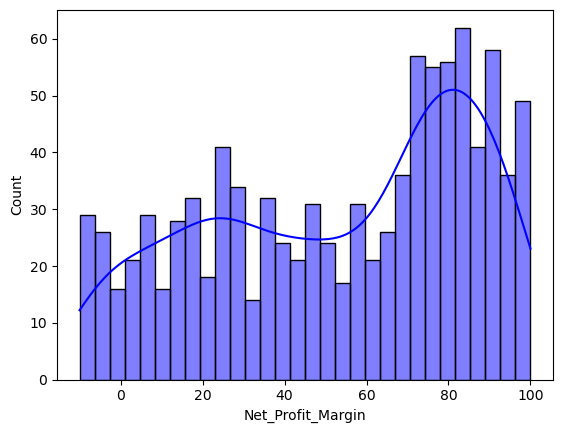

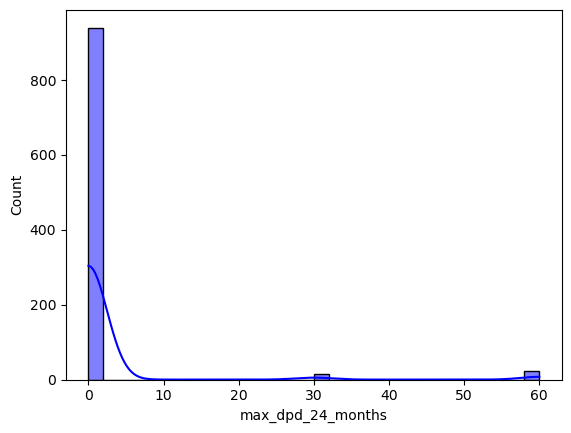

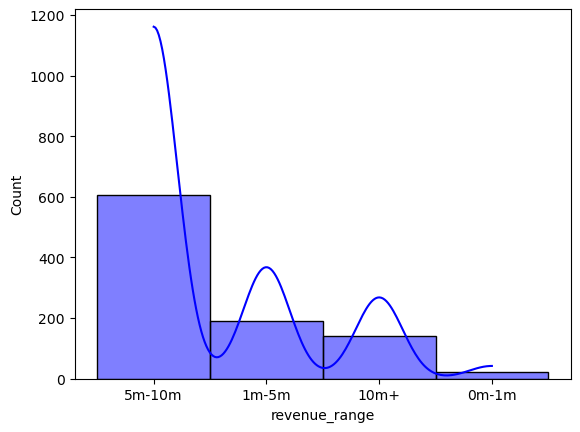

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
mv_columns=["Net_Profit_Margin","max_dpd_24_months","revenue_range"]
for col in mv_columns:
    plt.figure()
    sns.histplot(data=df1,x=col,bins =30,color="blue",kde=True)
    plt.show()


As is evident from the histogram plots that none of the columns with missing values assume a normal distribution.The net_profit_margin curve is bimodal. There are  outliers in the max_dpd_24_months column ,the curves are heavily skewed and a single measure like mean() can not be used to fill the missing values to preserve the distribution.
Since the max_dpd_24_months column has outliers it is better to use median as the missing value imputation method.


In [17]:
df1["max_dpd_24_months"].mean()

np.float64(1.8998978549540346)

In [18]:
df1["max_dpd_24_months"].median()

0.0

In [19]:
df1["max_dpd_24_months"].fillna(df1["max_dpd_24_months"].median(),inplace = True)
df1["max_dpd_24_months"].isnull().sum()

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\3054728329.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df1["max_dpd_24_months"].fillna(df1["max_dpd_24_months"].median(),inplace = True)


np.int64(0)

In [20]:
df1["max_dpd_24_months"].median()

0.0

In [21]:
df1["max_dpd_24_months"].mean()

np.float64(1.86)

Here we observe that the mean has slightly decreased from 1.89 to 1.86  but the median has remained at 0

The net_profit_margin exhibits characteristics of a bimodal and potentially left-skewed distribution. The presence of two distinct peaks (or "humps") around the 20-30% range and the 80-90% range suggests that the data may come from two different underlying groups or systems mixed together. Since there are no outliers we may use mean or median as missing values imputer.For more robustness we shall use median() 

In [22]:
df1["Net_Profit_Margin"].mean()

np.float64(53.561671763506624)

In [23]:
npm_med=df1["Net_Profit_Margin"].median()

In [24]:
df1.fillna({"Net_Profit_Margin":npm_med},inplace = True)
df1["Net_Profit_Margin"].isnull().sum()

np.int64(0)

In [25]:
df1["Net_Profit_Margin"].mean()

np.float64(53.703)

In [26]:
npm_med

61.0

As we can observe that the mean and median have remained the same after imputation

In [27]:
df1["revenue_range"] # Its is a categorical column and hence we shall use mode as the imputation technique 

0      5m-10m
1      5m-10m
2       1m-5m
3      5m-10m
4      5m-10m
        ...  
995     1m-5m
996      10m+
997    5m-10m
998    5m-10m
999    5m-10m
Name: revenue_range, Length: 1000, dtype: object

In [28]:
revenue_range_mode = df1["revenue_range"].mode()[0]
revenue_range_mode

'5m-10m'

In [29]:
# the mode of the column represents the value that has the highest frequency within the column and that value shall be used to 
# fill in the missing values in the dataset


In [30]:
df1["revenue_range"].fillna(df1["revenue_range"].mode()[0],inplace=True)


In [31]:
revenue_range_mode

'5m-10m'

In [32]:
df1["revenue_range"].isnull().sum()

np.int64(0)

In [33]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 35 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   Unnamed: 0                  1000 non-null   int64         
 1   id                          1000 non-null   int64         
 2   date                        1000 non-null   datetime64[ns]
 3   saving_ratio                1000 non-null   float64       
 4   debt_saving_ratio           1000 non-null   float64       
 5   default_flag                1000 non-null   int64         
 6   max_dpd_6_months            1000 non-null   int64         
 7   max_dpd_12_months           1000 non-null   int64         
 8   max_dpd_24_months           1000 non-null   float64       
 9   problematic_cheque_count    1000 non-null   int64         
 10  customer_segment            1000 non-null   object        
 11  duration_in_month           1000 non-null   int64        

Now we treated as ll th missing values.
Now we will check for any duplicate values in the dataset

In [34]:
df1.duplicated().sum()

np.int64(0)

It appears that there are no duplicate values in the dataset
All the columns contain non null values in the specified format

In [35]:
plt.style.use('dark_background')  # Set Matplotlib style to dark background

In [36]:
 # Set Seaborn style and palette
sns.set_style('darkgrid')
sns.set_palette('pastel')

In [37]:
df1.describe() # brief statistical discription of the unique values in the dataset

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,duration_in_month,credit_amount,installment_as_income_perc,present_res_since,average_credit_duration,credits_this_bank,people_under_maintenance,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin
count,1000.000000,1000.000000,1000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,499.500000,500.500000,2021-12-17 15:53:16.799999744,0.354370,0.334280,0.300000,1.200000,2.070000,1.860000,1.493000,20.903000,3271.258000,2.973000,2.845000,35.546000,1.407000,11.550000,4.305000,438.112000,57.202000,66.617000,49.827000,-1.234000,53.703000
min,0.000000,1.000000,2020-01-01 00:00:00,0.020000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,10.000000,0.000000,1.000000,-10.000000,0.000000,0.000000,-100.000000,-10.000000
25%,249.750000,250.750000,2020-12-25 18:00:00,0.190000,0.170000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000,1365.500000,2.000000,2.000000,27.000000,1.000000,10.000000,2.000000,239.000000,28.000000,37.000000,25.000000,-52.250000,26.000000
50%,499.500000,500.500000,2021-12-12 12:00:00,0.320000,0.300000,0.000000,0.000000,0.000000,0.000000,1.000000,18.000000,2319.500000,3.000000,3.000000,33.000000,1.000000,10.000000,4.000000,438.500000,55.000000,66.000000,48.000000,-4.000000,61.000000
75%,749.250000,750.250000,2022-12-10 12:00:00,0.460000,0.440000,1.000000,0.000000,0.000000,0.000000,3.000000,24.000000,3972.250000,4.000000,4.000000,42.000000,2.000000,10.000000,6.000000,632.250000,84.000000,92.000000,76.000000,52.000000,81.000000
max,999.000000,1000.000000,2023-12-30 00:00:00,1.020000,1.000000,1.000000,30.000000,60.000000,60.000000,3.000000,72.000000,18424.000000,4.000000,4.000000,75.000000,4.000000,20.000000,10.000000,1000.000000,150.000000,150.000000,100.000000,100.000000,100.000000
std,288.819436,288.819436,NaN,0.226289,0.226307,0.458487,5.881717,9.965662,9.686807,1.157277,12.058814,2822.736876,1.118715,1.103718,11.375469,0.577654,3.620858,2.679021,243.424919,38.391446,37.072668,29.030809,59.478273,32.000388


In [38]:
# Target Variable Distribution

In [39]:
exclude_columns=df1[['default_flag','id','Unnamed: 0']]
target=df1['default_flag']

In [40]:
numerical_cols = df1.select_dtypes(include=np.number).columns.tolist()
print(f"numerical_columns :", np.array(numerical_cols))


numerical_columns : ['Unnamed: 0' 'id' 'saving_ratio' 'debt_saving_ratio' 'default_flag'
 'max_dpd_6_months' 'max_dpd_12_months' 'max_dpd_24_months'
 'problematic_cheque_count' 'duration_in_month' 'credit_amount'
 'installment_as_income_perc' 'present_res_since'
 'average_credit_duration' 'credits_this_bank' 'people_under_maintenance'
 'sector_risk' 'EBITDA' 'ROE' 'ROA' 'Revenue_Growth_Rate'
 'Int_coverage_ratio' 'Net_Profit_Margin']


default_flag
0    0.7
1    0.3
Name: proportion, dtype: float64


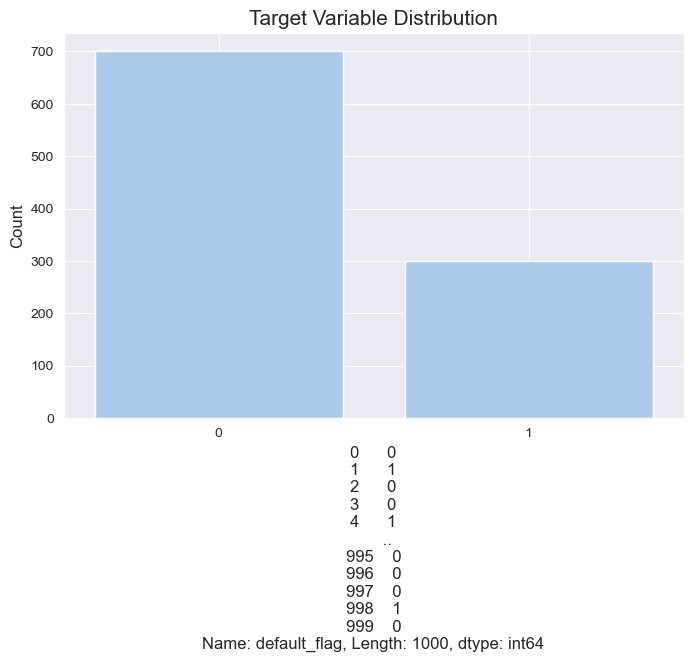

In [41]:

    print(pd.Series(target).value_counts(normalize=True)) # we add the normalise parameter to value_counts method to display the values w.r.t total
    plt.figure(figsize=(8, 5))
    sns.countplot(x=target, data=df1)
    plt.title('Target Variable Distribution', fontsize=15)
    plt.xlabel(target, fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.grid(True)
    plt.show()


In [42]:
# Numerical and Categorical Variables Analysis
numerical_cols = df1.select_dtypes(include=np.number).columns.tolist()
categorical_cols = df1.select_dtypes(include='object').columns.tolist()
print(f"categorical_cols :",np.array(categorical_cols))

categorical_cols : ['customer_segment' 'credit_history' 'purpose' 'savings'
 'sme_history_begin' 'other_debtors' 'sector' 'customer_profile'
 'business_type' 'revenue_range' 'foreign_stakeholders']


In [43]:
# Missing Value Analysis
missing_values = df1.isnull().sum()
missing_values[missing_values>0]# Result shows that all missing values are treated

Series([], dtype: int64)

<span style="font-size: 20px;color: blue;font-family: Arial">Histograms (or histplots) of independent features—such as Credit amount, duration_in_month, or credit_history —provide a visual audit of the data's distribution. These insights are critical for refining the components used to calculate Expected Loss (EL)<span>
    
<span style="font-size: 15px;color: red;font-family: Arial"> Expected Loss = Probability of Default(PD) X Loss Given Default(LGD)xExposure at Default(EAD)<span>

# 1. Identifying Risk Concentration
<span style="font-size: 20px; color: green;font-family:Arial"> Histograms reveal where most of the portfolio's exposure lies. For example, a heavy right tail in a "Loan Amount" histogram indicates a small number of very large loans, which disproportionately affects the EAD.<span>

# 2. Detection of Outliers and Data Quality Issues
<span style="font-size: 20px; color: green;font-family:Arial"> Outlier Identification: Extreme values in numerical features (like an unusually high income or loan amount) can distort the calculation of average losses.

Action: You may need to treat these outliers (e.g., through capping or removal) to ensure the EAD and LGD estimates are not biased by unrepresentative cases.<span>

# 3. Guiding Feature Engineering and Model Calibration
<span style="font-size: 20px; color: green;font-family:Arial">Non-linear Relationships: Histograms help identify if a feature needs transformation (like log scaling for skewed distributions) to better fit statistical models like Logistic Regression.

Action: Use these insights to create "risk buckets." For instance, binning "Age" or "Credit Score" into categories allows to assign specific PD values to different borrower profiles, leading to a more granular and accurate portfolio EL.<span>



In the following hist plots we shall observerve the distribution of the data to understand

1-Modes of Central Tendency

2-Modes of Dispersion

3-Distribution of values

4-Outliers

5-Skewness


saving_ratio:
  Mean: 0.35437
  Median: 0.32
  Standard Deviation: 0.2262892173964767


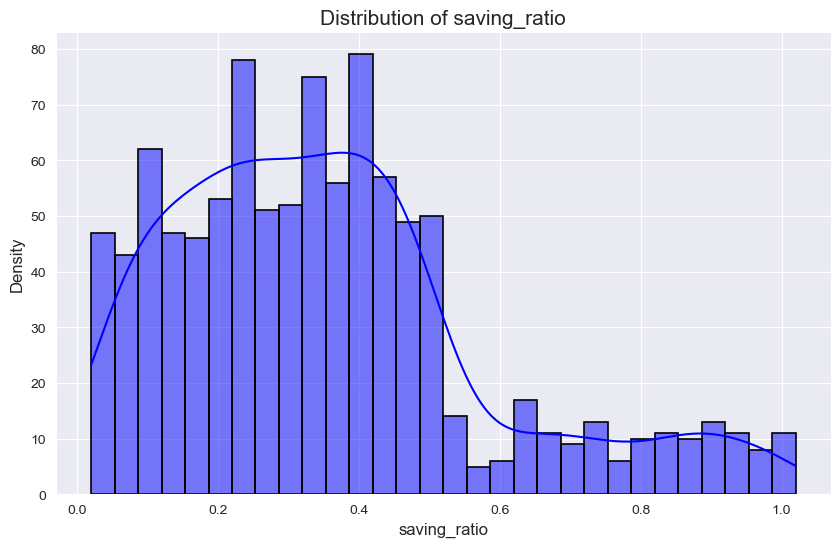


debt_saving_ratio:
  Mean: 0.33427999999999997
  Median: 0.3
  Standard Deviation: 0.22630708450354914


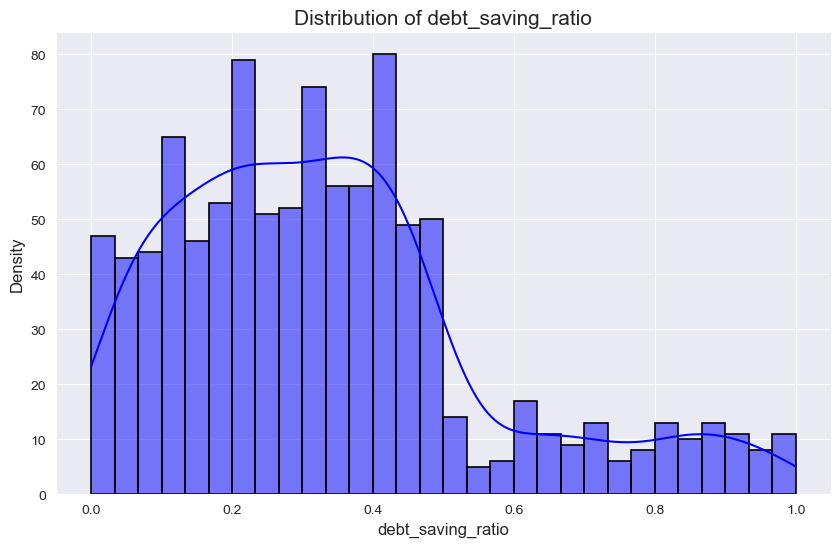


max_dpd_6_months:
  Mean: 1.2
  Median: 0.0
  Standard Deviation: 5.8817169767506154


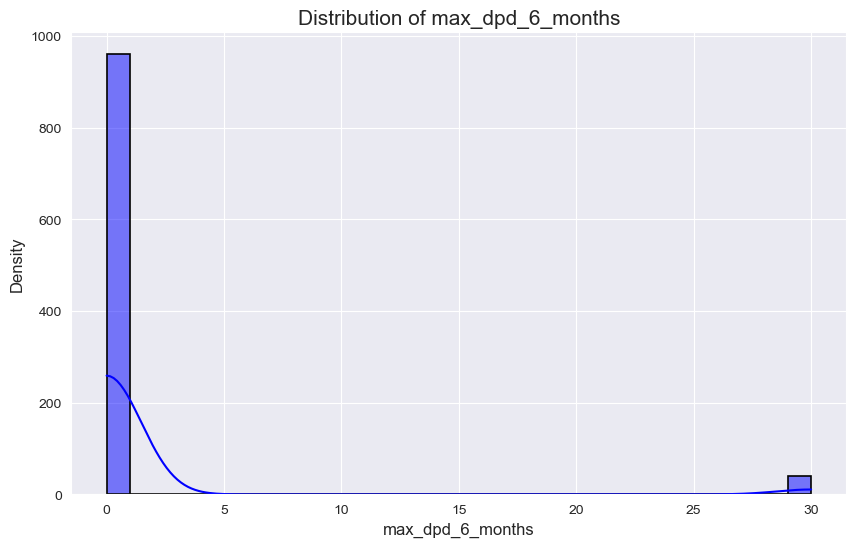


max_dpd_12_months:
  Mean: 2.07
  Median: 0.0
  Standard Deviation: 9.965661765001528


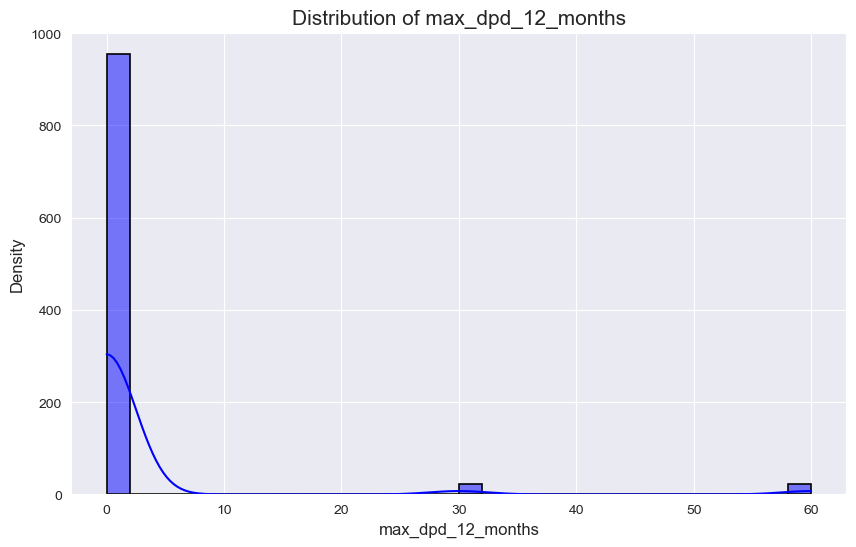


max_dpd_24_months:
  Mean: 1.86
  Median: 0.0
  Standard Deviation: 9.686807226028392


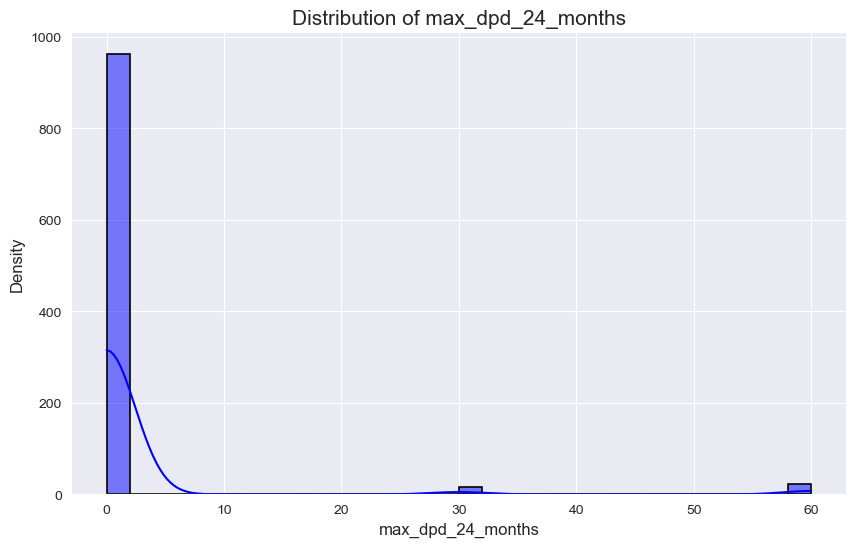


problematic_cheque_count:
  Mean: 1.493
  Median: 1.0
  Standard Deviation: 1.15727710177394


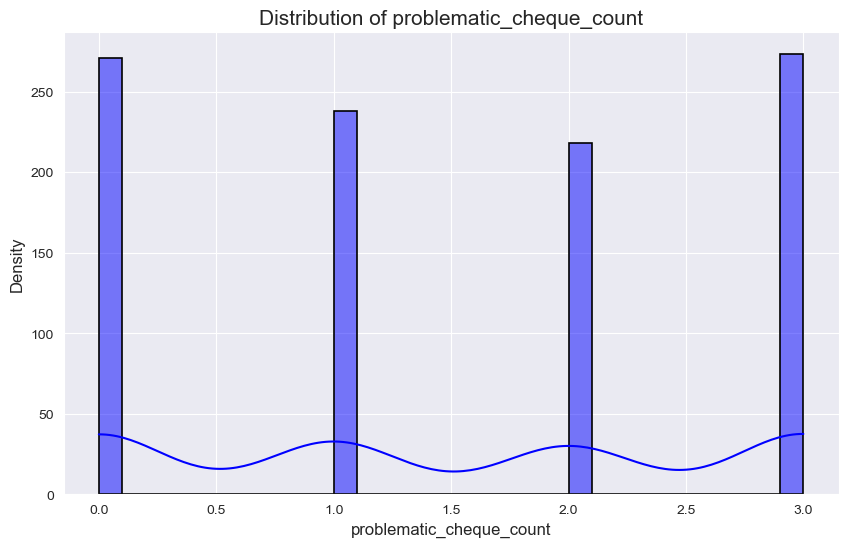


duration_in_month:
  Mean: 20.903
  Median: 18.0
  Standard Deviation: 12.058814452756392


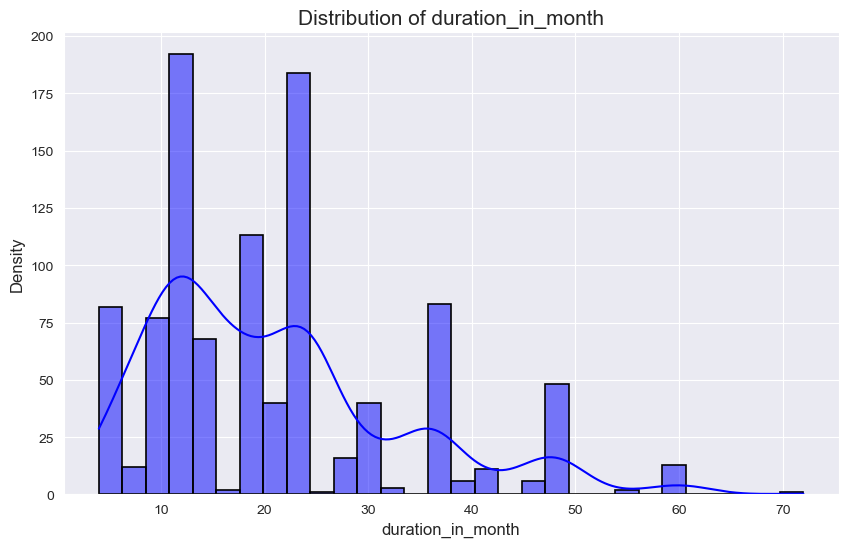


credit_amount:
  Mean: 3271.258
  Median: 2319.5
  Standard Deviation: 2822.73687596044


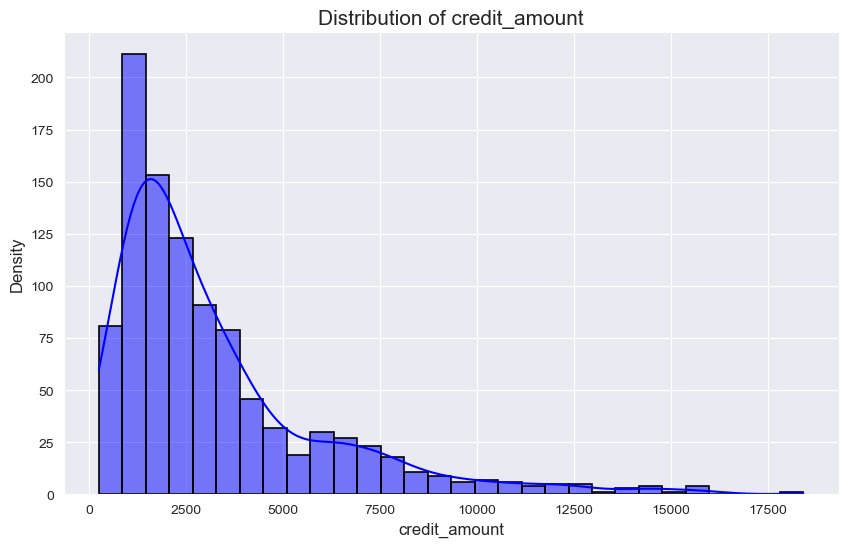


installment_as_income_perc:
  Mean: 2.973
  Median: 3.0
  Standard Deviation: 1.1187146743126737


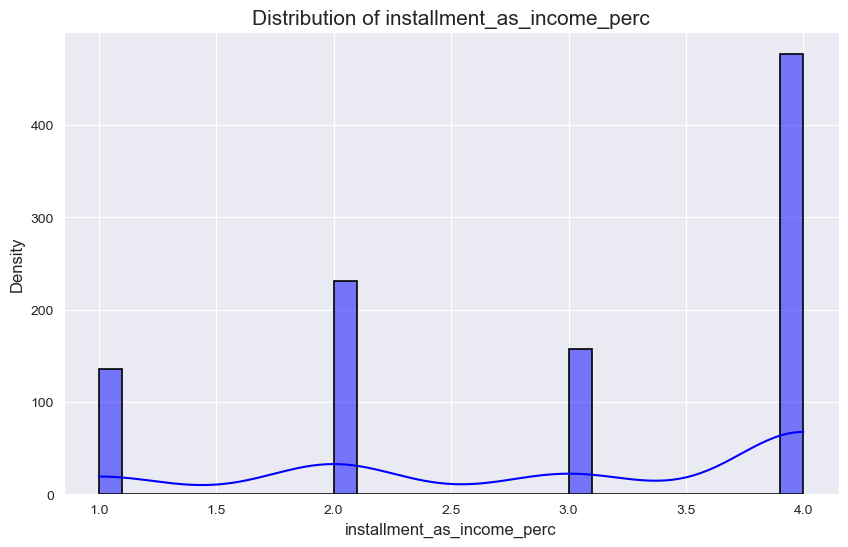


present_res_since:
  Mean: 2.845
  Median: 3.0
  Standard Deviation: 1.1037178956568579


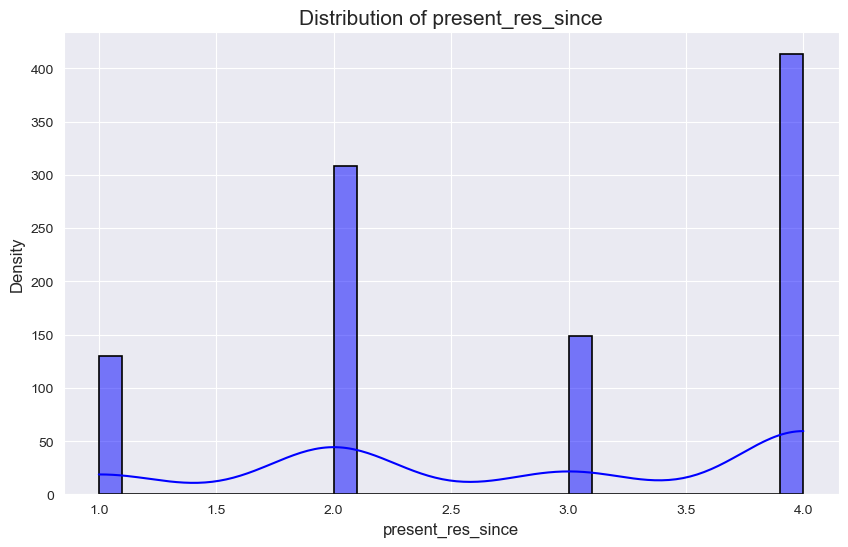


average_credit_duration:
  Mean: 35.546
  Median: 33.0
  Standard Deviation: 11.375468574317502


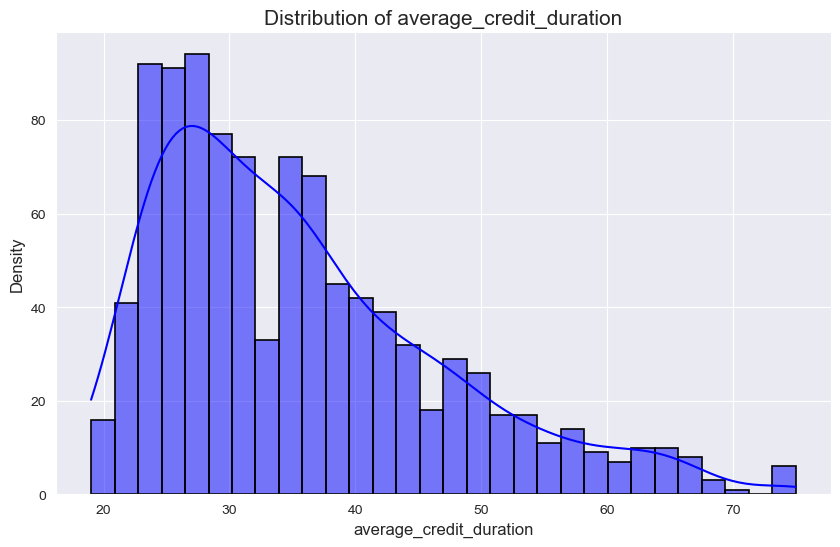


credits_this_bank:
  Mean: 1.407
  Median: 1.0
  Standard Deviation: 0.5776544682460991


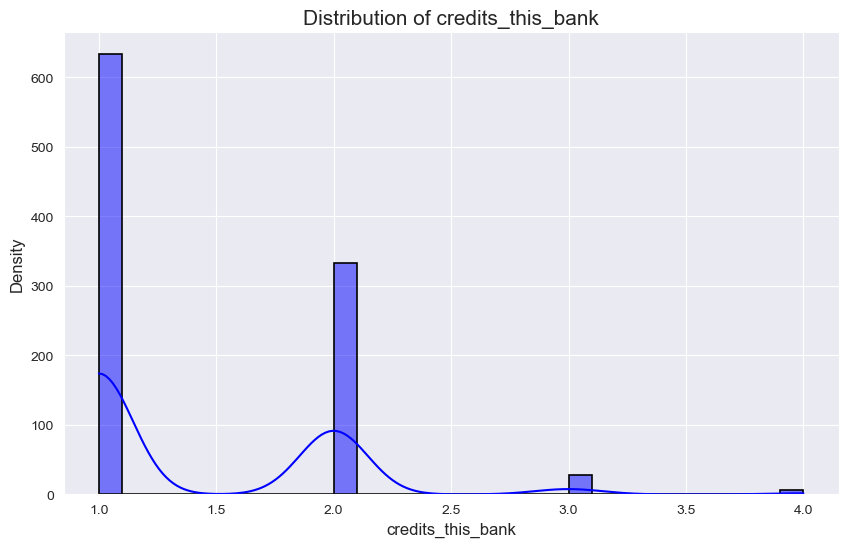


people_under_maintenance:
  Mean: 11.55
  Median: 10.0
  Standard Deviation: 3.620857717531956


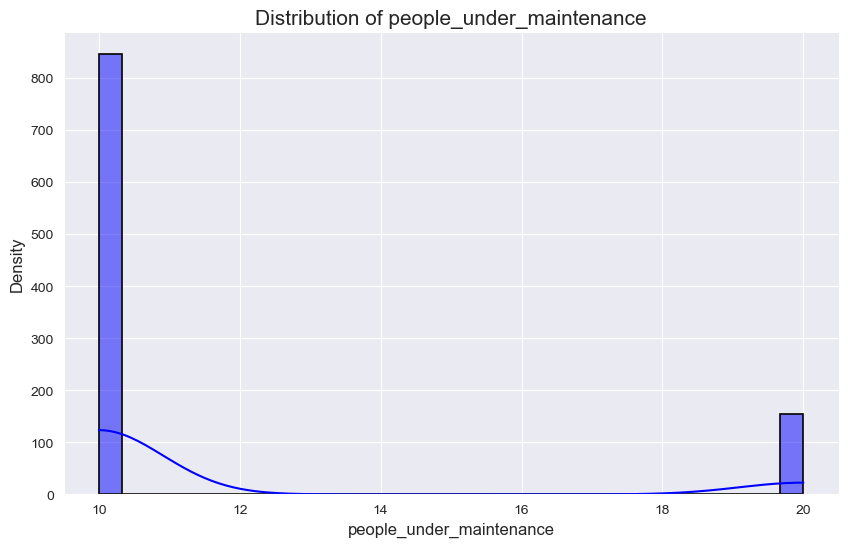


sector_risk:
  Mean: 4.305
  Median: 4.0
  Standard Deviation: 2.679020745002207


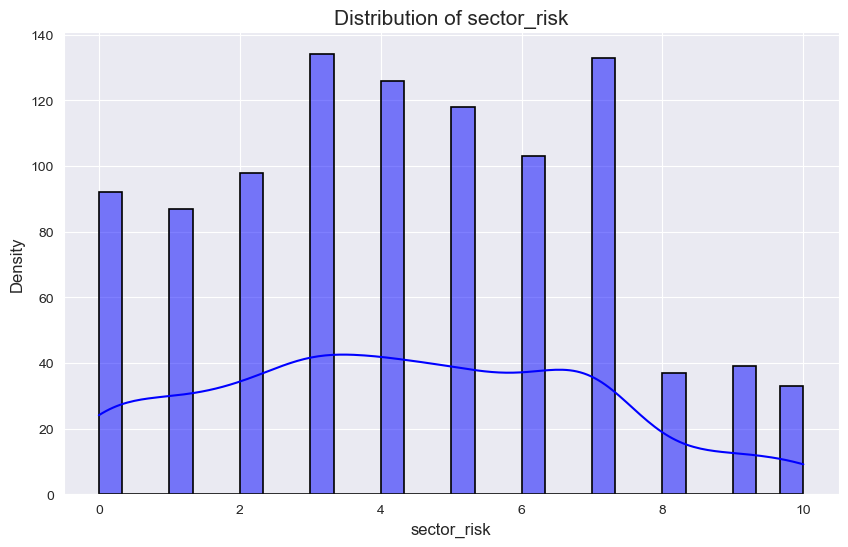


EBITDA:
  Mean: 438.112
  Median: 438.5
  Standard Deviation: 243.42491891165756


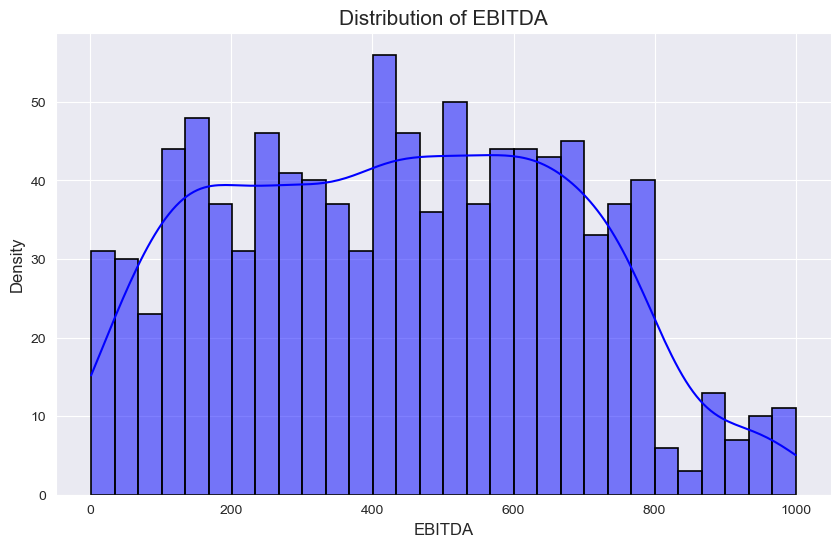


ROE:
  Mean: 57.202
  Median: 55.0
  Standard Deviation: 38.39144565002857


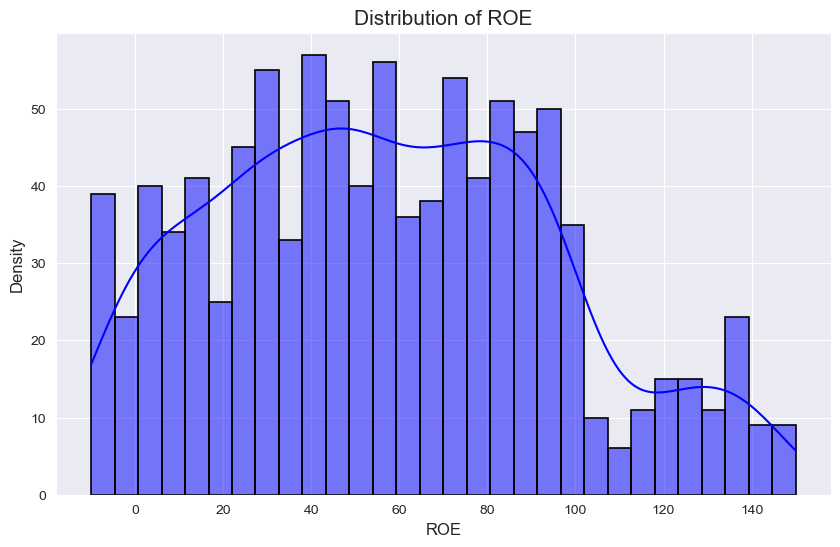


ROA:
  Mean: 66.617
  Median: 66.0
  Standard Deviation: 37.07266774449462


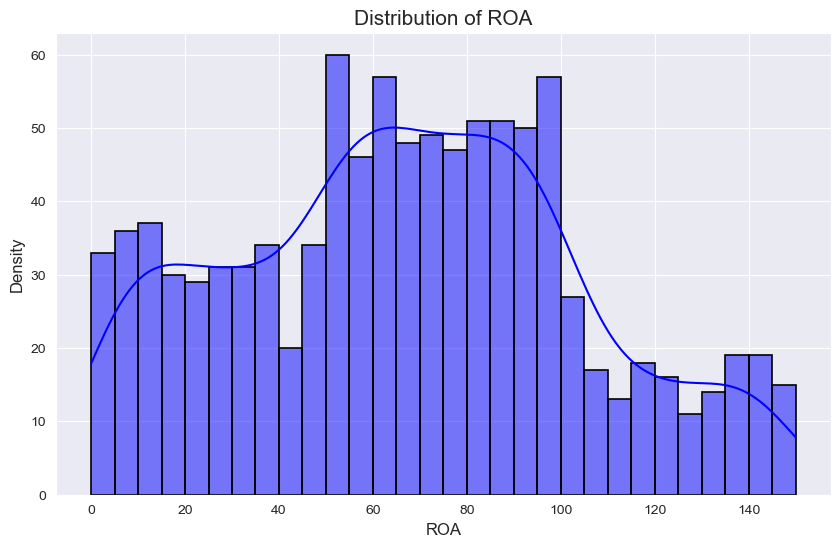


Revenue_Growth_Rate:
  Mean: 49.827
  Median: 48.0
  Standard Deviation: 29.030808787542604


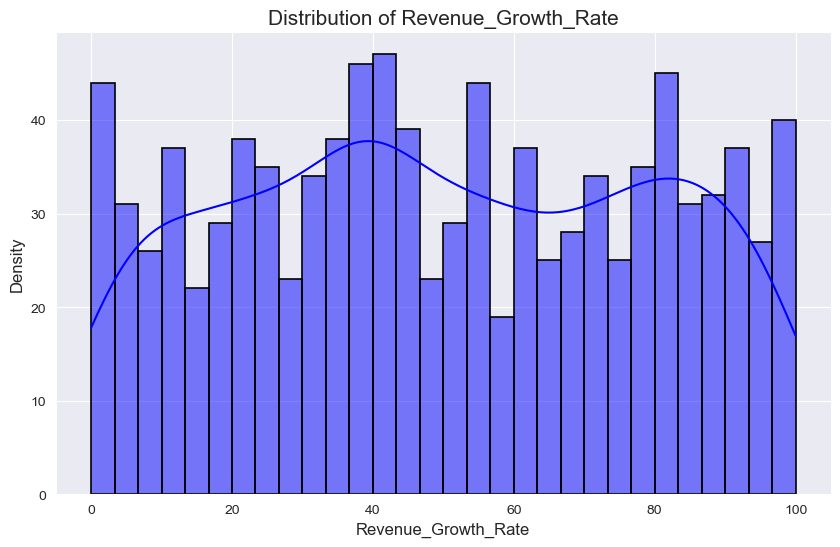


Int_coverage_ratio:
  Mean: -1.234
  Median: -4.0
  Standard Deviation: 59.47827257838706


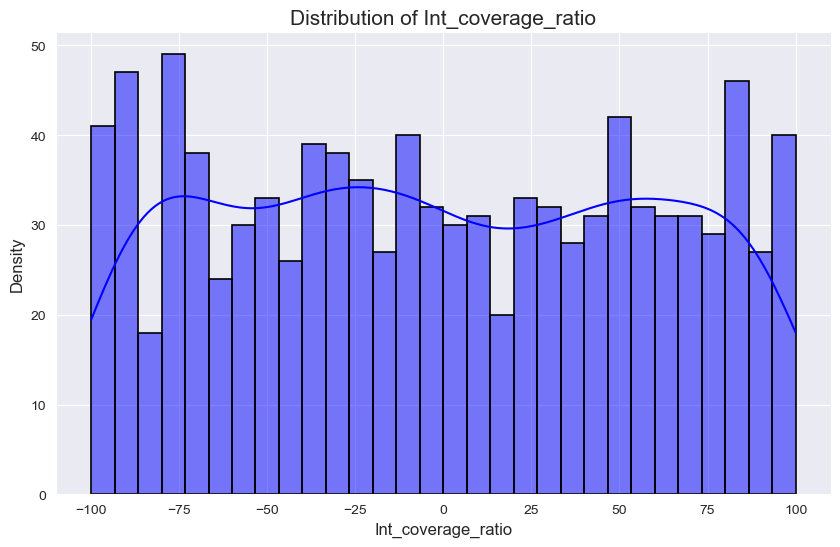


Net_Profit_Margin:
  Mean: 53.703
  Median: 61.0
  Standard Deviation: 32.00038774477296


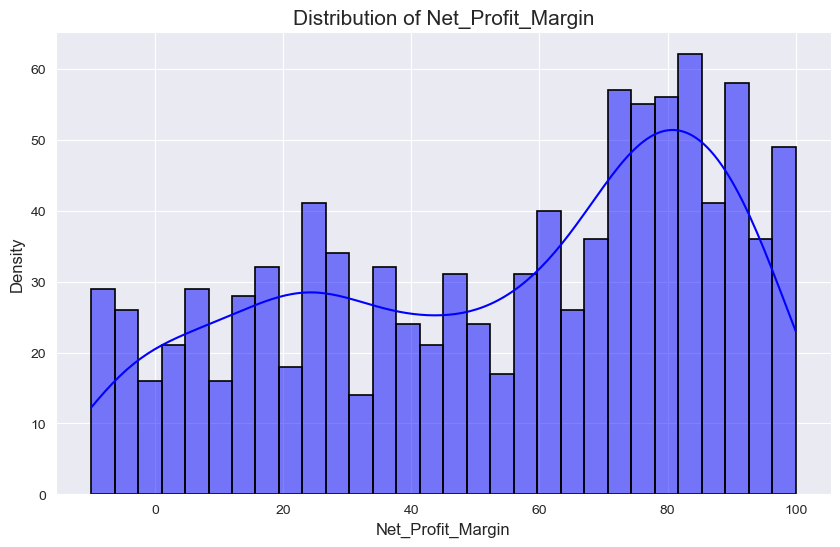

In [44]:
# Plotting distribution of each indiviual Numerical column using sns.histplot
numerical_cols = [col for col in numerical_cols if col not in exclude_columns]
if numerical_cols:
        for col in numerical_cols:
            print(f"\n{col}:")
            print(f"  Mean: {df1[col].mean()}")
            print(f"  Median: {df1[col].median()}")
            print(f"  Standard Deviation: {df1[col].std()}")

            # Distribution plot with KDE
            plt.figure(figsize=(10, 6))
            sns.histplot(data=df1, x=col, kde=True, bins=30, color='blue', edgecolor='black', linewidth=1.2)
            plt.title(f'Distribution of {col}', fontsize=15)
            plt.xlabel(col, fontsize=12)
            plt.ylabel('Density', fontsize=12)
            plt.grid(True)
            plt.show()
                            

<span style="font-size: 20px;color: blue;font-family: Arial">Boxplots of independent features (e.g., credit_amount, loan_duration, or ROE,ROA) provide visual summaries of data distribution, central tendency, and variability<span>
    
Key actions conveyed by boxplots for estimating Expected Loss include:

# 1. Outlier Identification and Treatment
<span style="font-size: 15px;color: green;font-family: Arial">Action: Boxplots explicitly highlight extreme values (outliers) that may represent exceptionally high-risk cases or data entry errors.

Impact on EL: Outliers in "Credit_Amount" or "savings_ratio" can heavily distort PD and EAD estimates. Further action involves determining if these outliers are legitimate "tail risks" to be retained or if they should be replaced with boundary values (winsorization) using the boxplot’s whiskers to improve model stability.<span>

# 2. Portfolio Segmentation
<span style="font-size: 15px;color: green;font-family: Arial"> Action: By comparing boxplots across different categories (e.g., "Good" vs. "Bad" credit), analysts can identify features that significantly differentiate borrower behavior.

Impact on EL: If the median and interquartile range (IQR) of a feature like "Loan_Duration" vary significantly between risk classes, it signals the need for targeted segmentation. This allows for more granular EL estimation for specific sub-portfolios rather than applying a single average rate.<span>

# 3. Assessing Data Variability and Skewness
<span style="font-size: 15px;color: green;font-family: Arial">Action: The position of the median line and the relative length of the whiskers indicate skewness and variance.

Impact on EL: Wide boxes (large IQR) for features like "LGD" suggest high variability in recovery rates, signaling that a simple mean may not be sufficient for loss provisioning. This often leads to using quantile-based modeling or selecting robust algorithms (like Random Forest) that are less sensitive to data spread. <span>

# 4. Direct Support for Risk Parameter Refinement
<span style="font-size: 15px;color: green;font-family: Arial">PD (Probability of Default): Comparing boxplots of borrower age or income against default status helps validate which features should be used in logistic regression or scoring models.
LGD (Loss Given Default): Boxplots of collateral values or recovery rates help identify the "typical" loss severity and the potential for extreme losses in specific asset classes.
EAD (Exposure at Default): Boxplots of credit utilization or loan balance at the time of default help refine the "credit conversion factors" used to estimate the maximum exposure.<span>

<span style="font-size: 20px;color: green;font-family: Arial">Interpreting boxplots of independent features in credit risk reveals critical statistical properties that guide data cleaning, feature engineering, and the ultimate calculation of Expected Loss (EL). 

The boxplot provides a "five-number summary"—minimum, first quartile (Q1), median (Q2), third quartile (Q3), and maximum—which reveals the following for credit risk modeling: 

1. Detection of Anomalous Risk Cases (Outliers) Boxplots explicitly flag data points beyond the whiskers (typically (1.5times {IQR}) as outliers.

What it reveals: Extreme values in features like "Loan Amount" or "Applicant Income" that may represent legitimate high-risk borrowers or data entry errors.

Action for EL: These outliers can skew Probability of Default (PD) and Exposure at Default (EAD) estimates. Analysts use boxplot boundaries to decide whether to trim (remove) or winsorize (cap/floor) these values to prevent them from disproportionately influencing the model. 

2. Assessment of Feature Variability and Reliability The width of the box (Interquartile Range or IQR) and the length of the whiskers indicate the spread and dispersion of the data.

What it reveals: High variability in a feature like "Collateral Value" suggests that Loss Given Default (LGD) estimates may be less stable and more sensitive to market fluctuations.

Action for EL: A large IQR signals that a simple mean-based estimate of EL might be insufficient; the model may require more complex, robust algorithms (like Random Forest) or quantile-based adjustments to account for this uncertainty. 

3. Identification of Distribution Skewness The position of the median line within the box and the relative length of the whiskers reveal whether the feature distribution is symmetric or skewed.

What it reveals: Financial features like income are often right-skewed (median closer to the bottom/Q1), indicating a long tail of high-value observations.

Action for EL: Skewed distributions often violate the assumptions of linear regression models. This revelation prompts the use of log transformations or Box-Cox transformations to normalize the data before estimating PD, LGD, or EAD. 

4. Preliminary Feature Importance and Segmentation Side-by-side boxplots comparing features across different categories (e.g., "Default" vs. "Non-Default") reveal the predictive power of a variable.

What it reveals: If the medians of a feature (like "Credit Utilization") differ significantly between defaulted and non-defaulted groups, that feature is a strong candidate for inclusion in the PD model.Action for EL: This helps in feature selection and identifies where the portfolio should be segmented (e.g., by geography or industry) to calculate more accurate, granular EL components (EL=PDx LGDxEAD).<span>

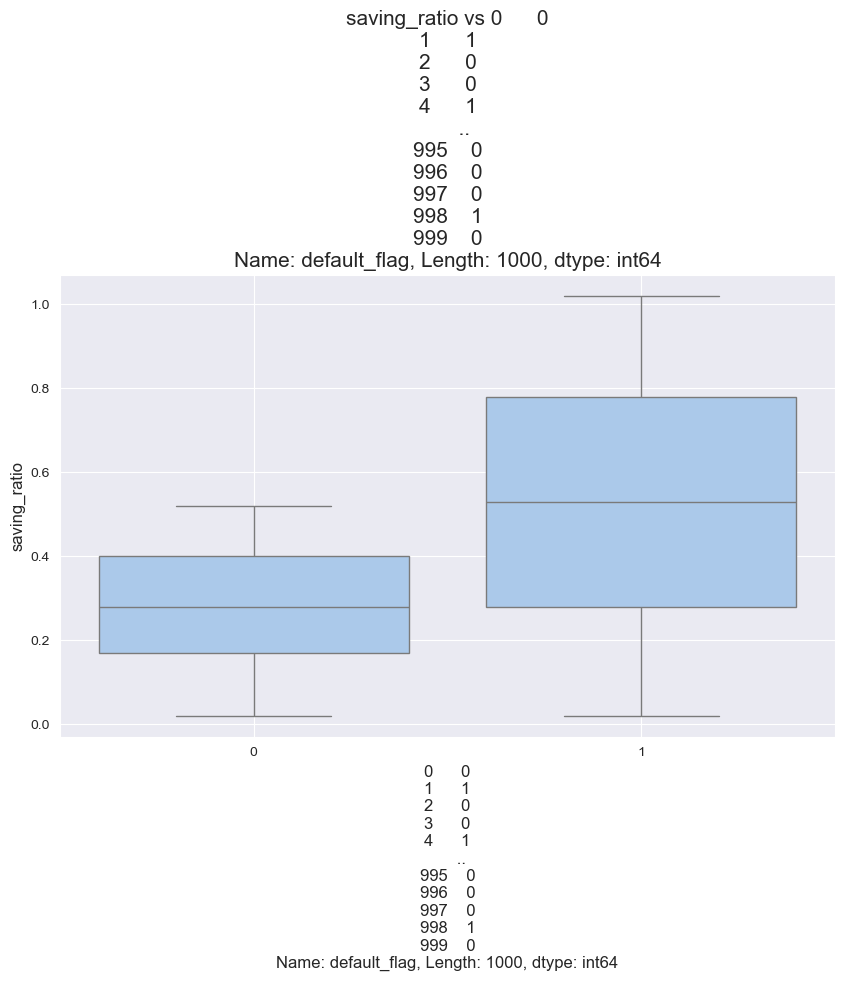

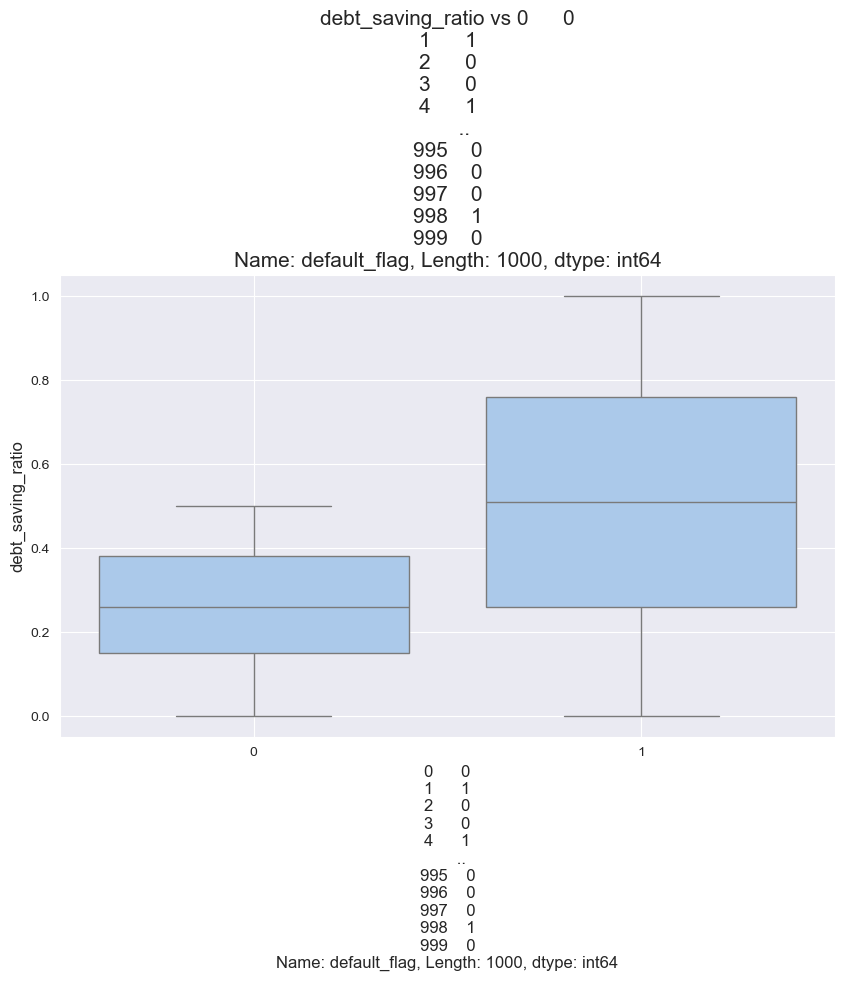

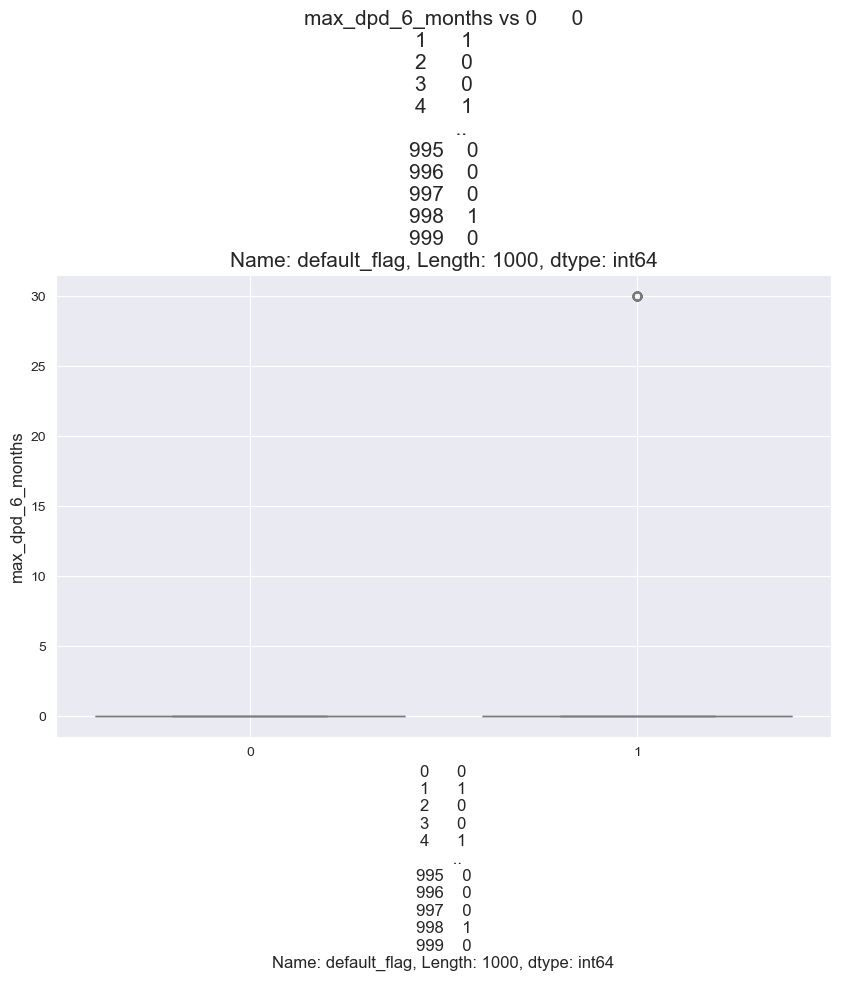

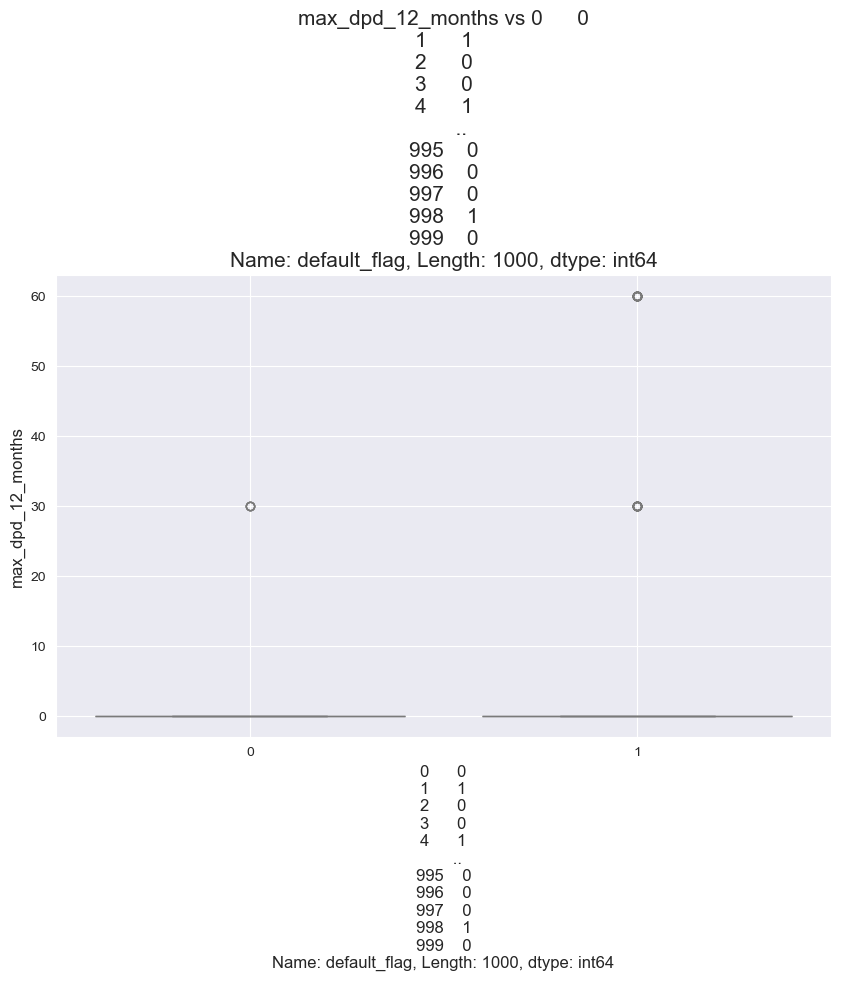

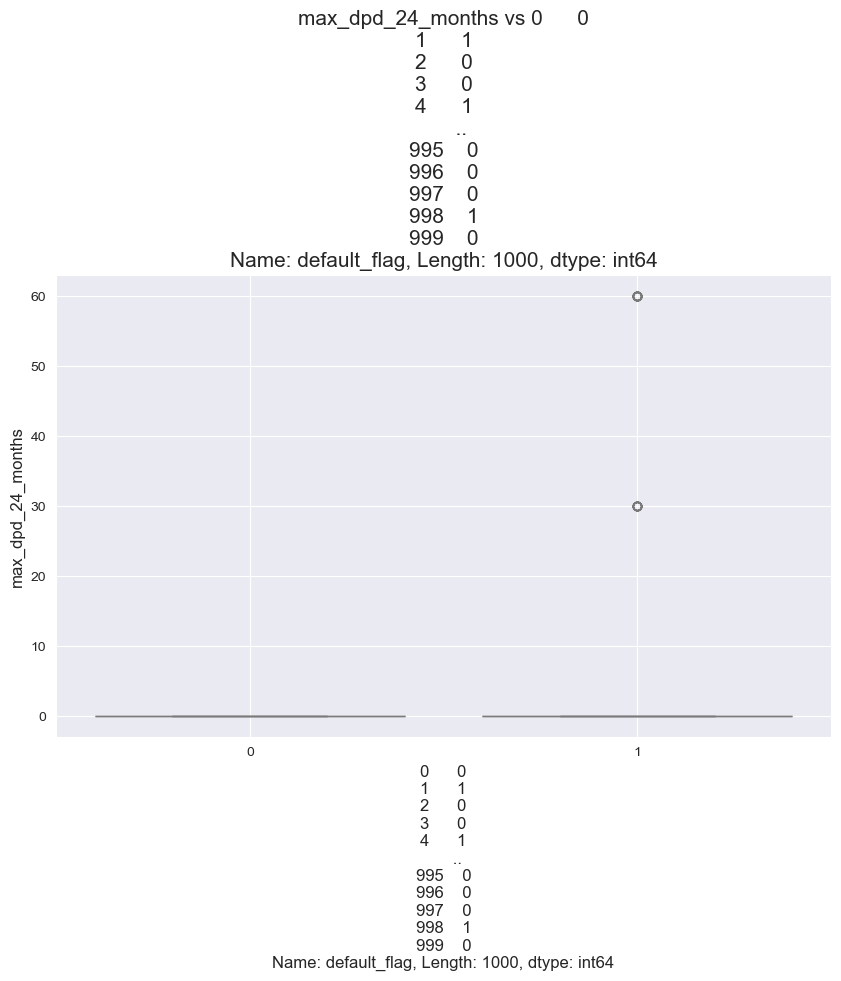

...

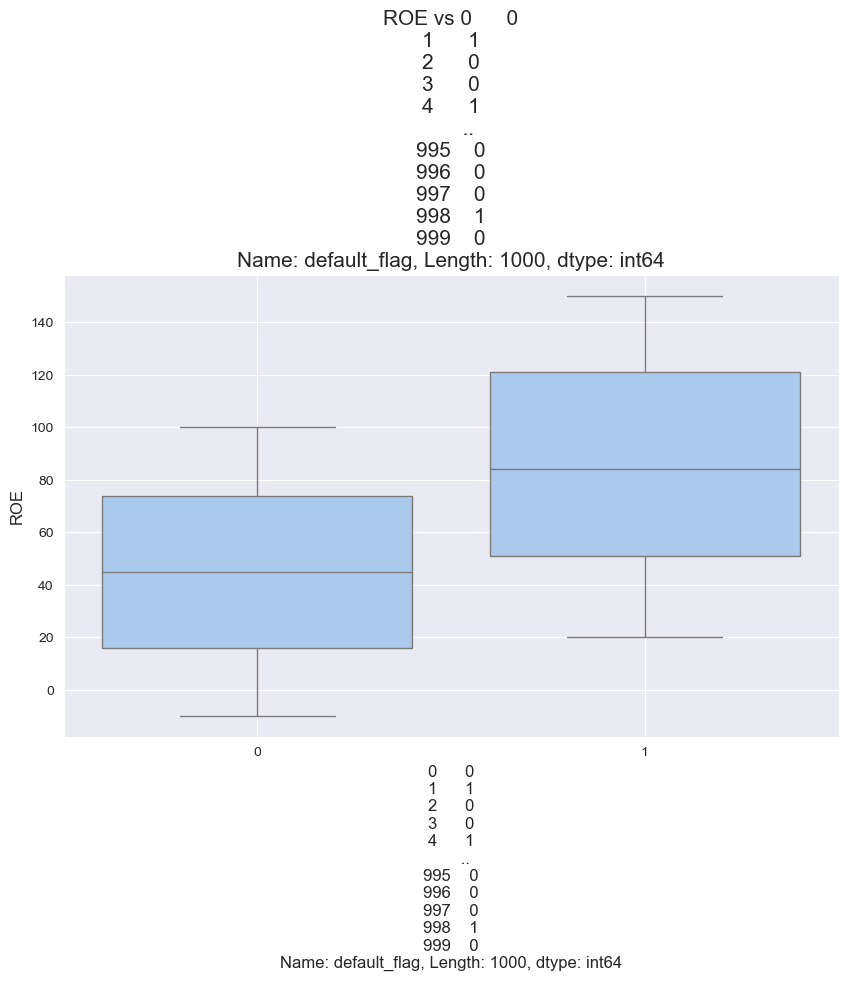

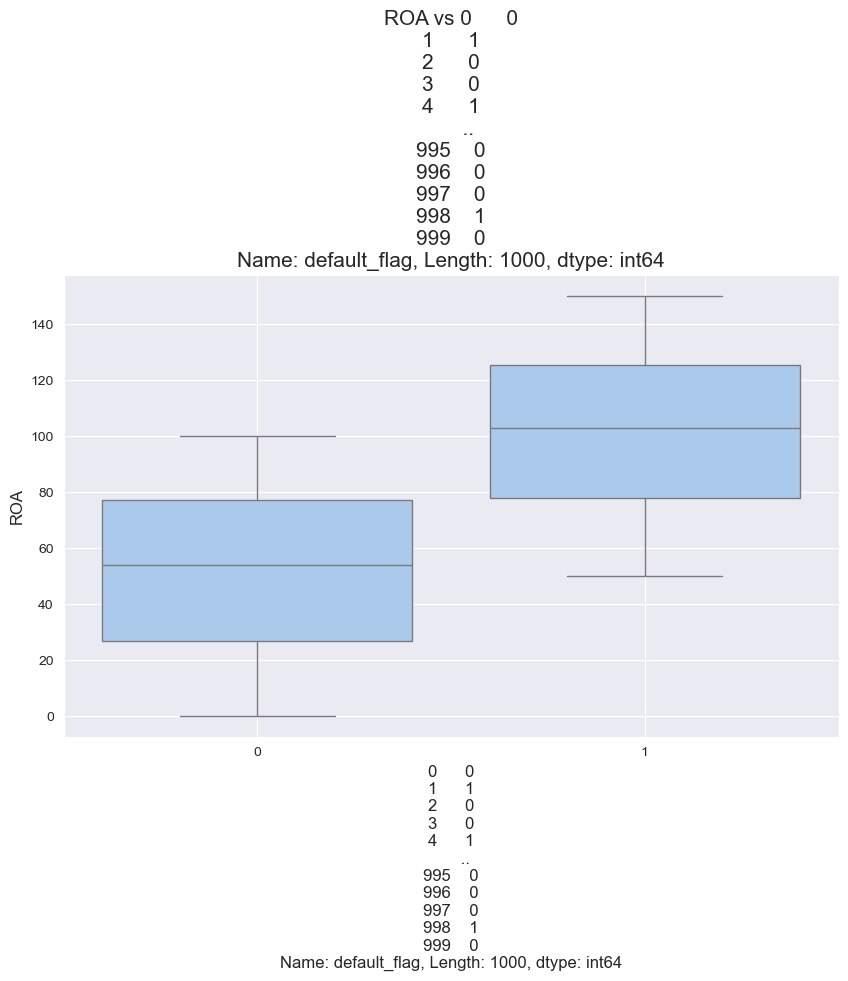

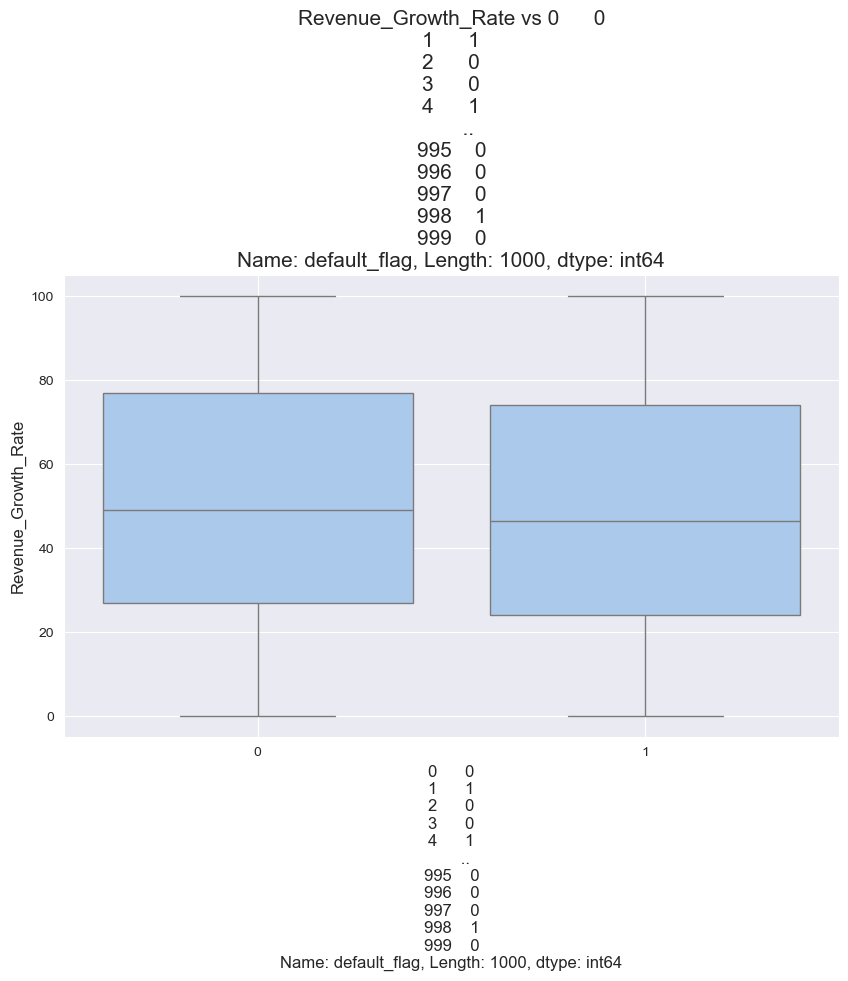

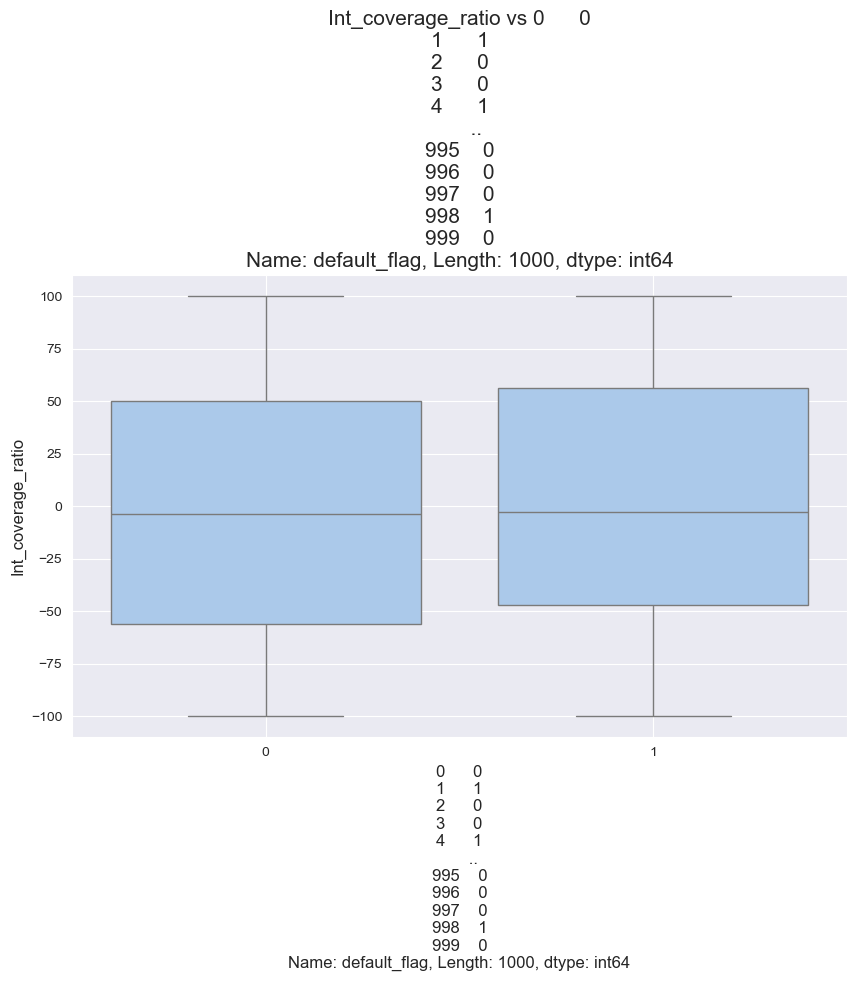

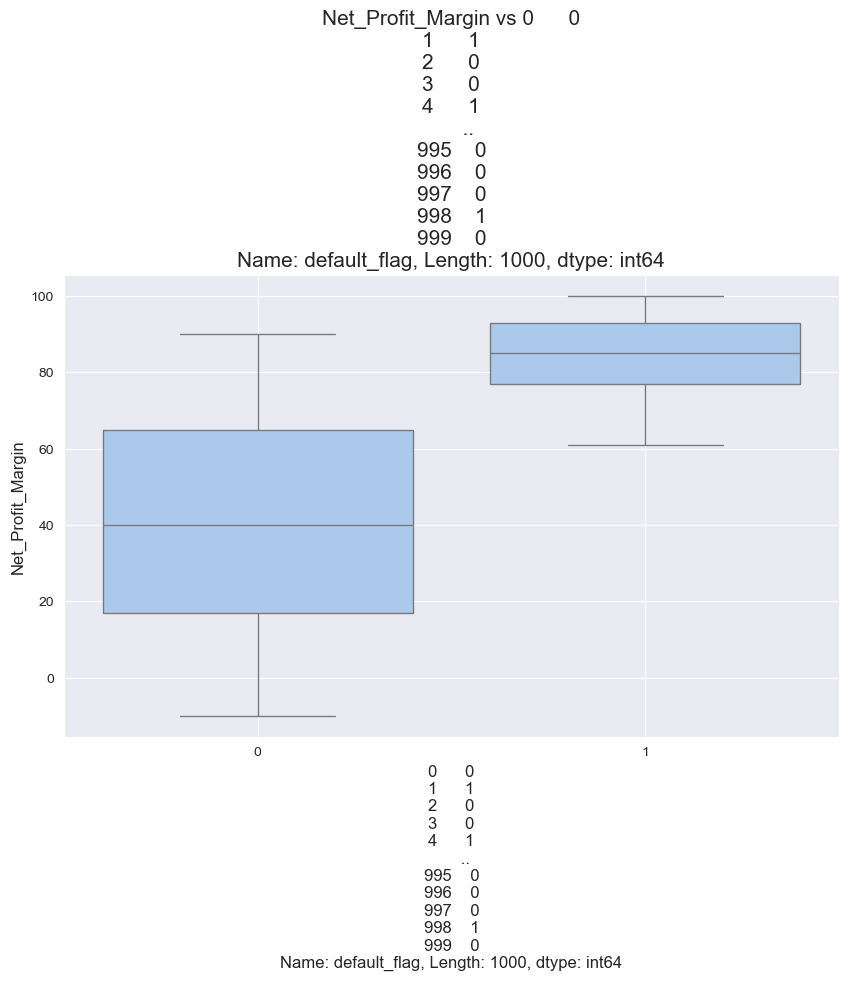

In [45]:
# Box plot of all the numerical columns in the dataset in both classes of the target variable(0,1)
numerical_cols=[col for col in numerical_cols if col not in exclude_columns]
for col in numerical_cols:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=target, y=col, data=df1)
    plt.title(f'{col} vs {target}', fontsize=15)
    plt.xlabel(target, fontsize=12)
    plt.ylabel(col, fontsize=12)
    plt.grid(True)
    plt.show()

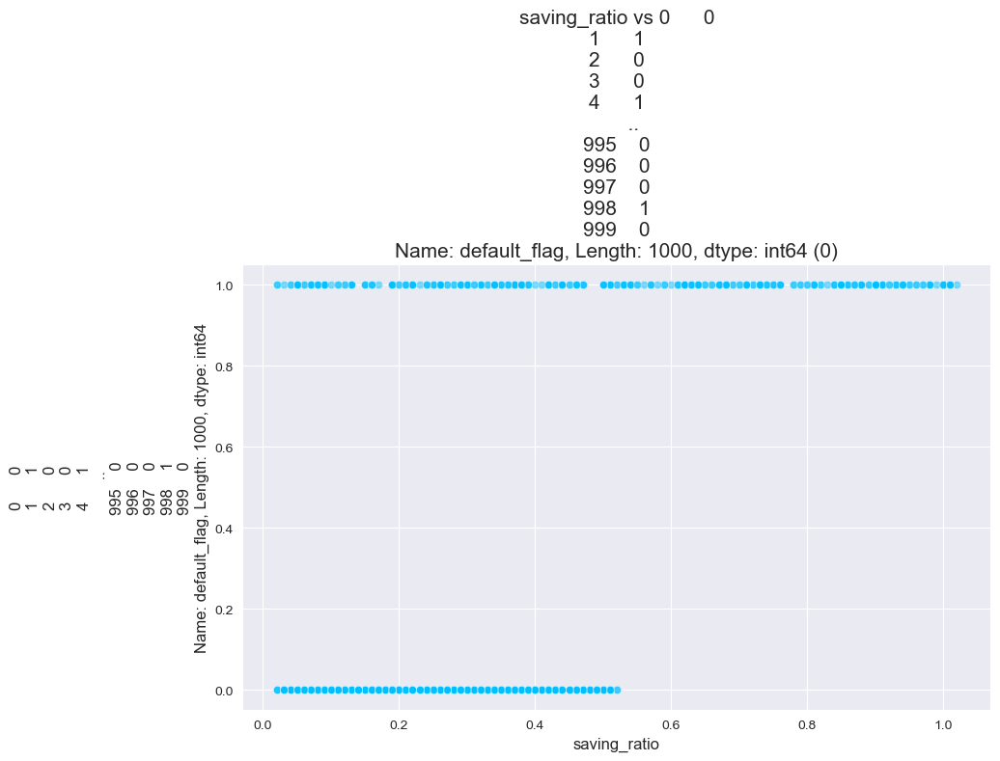

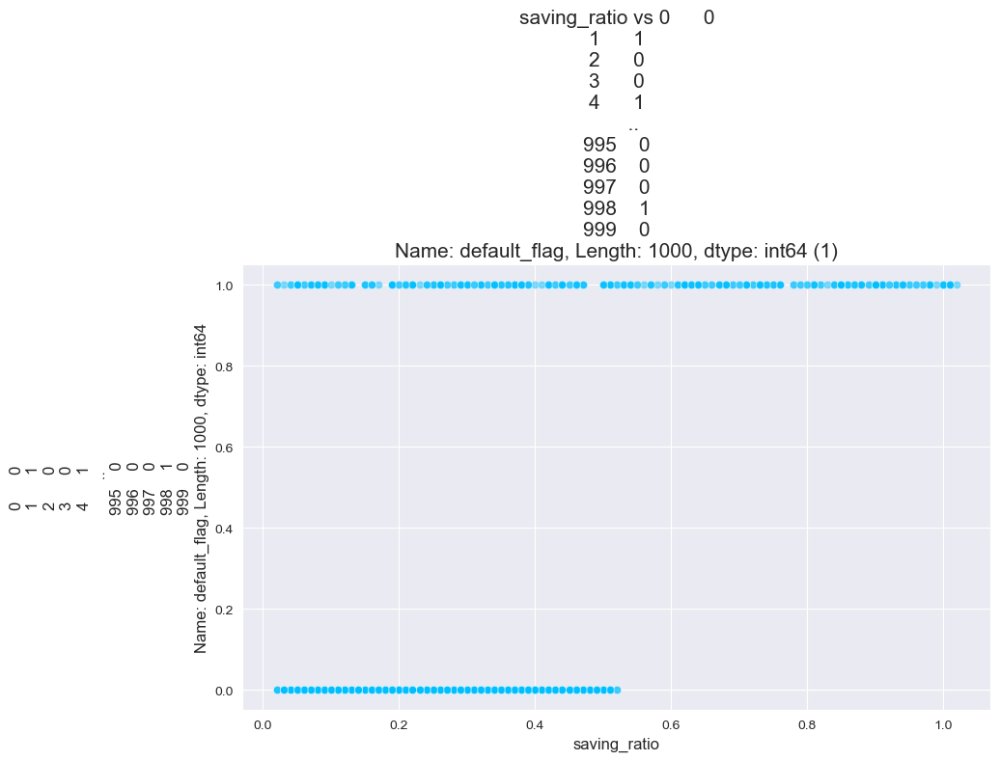

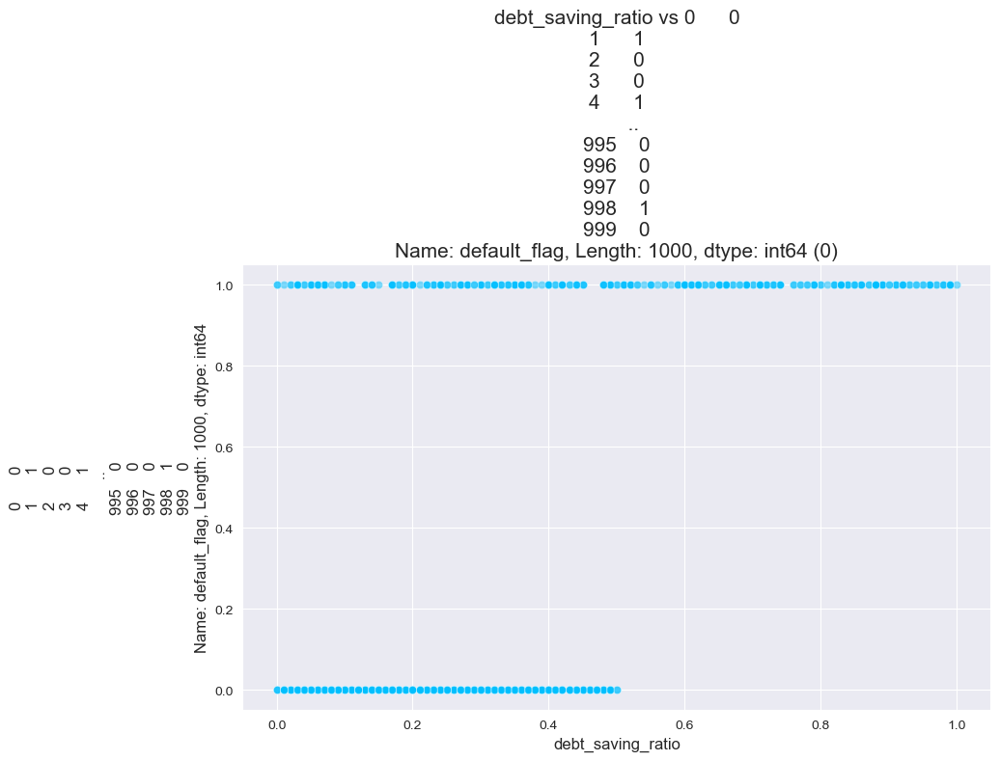

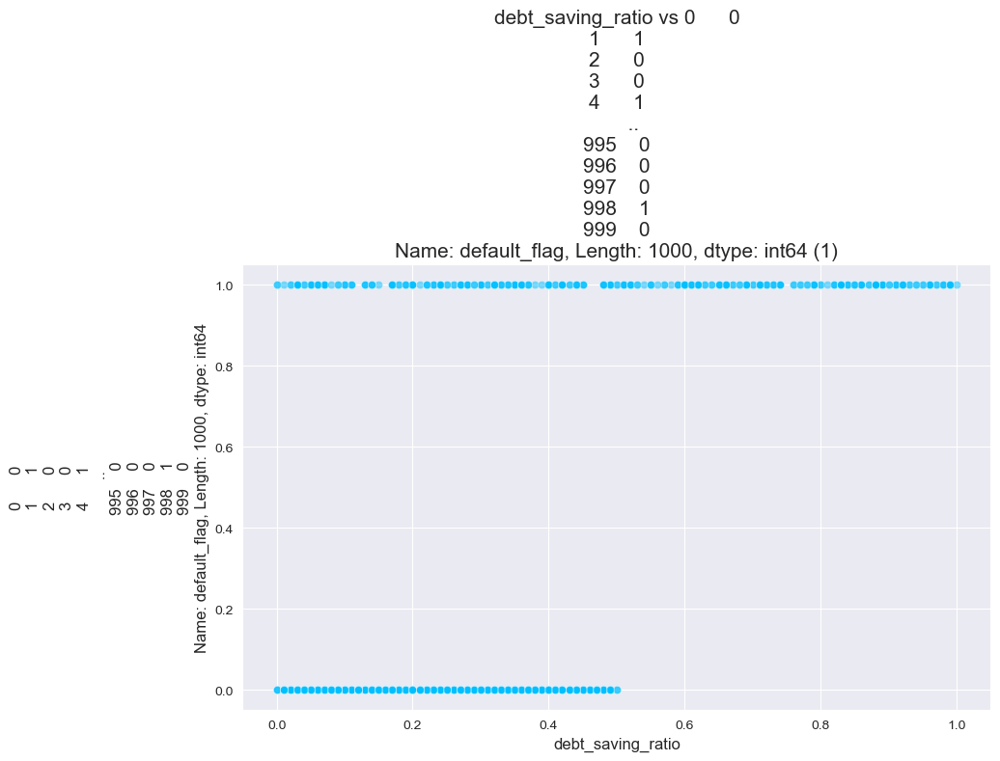

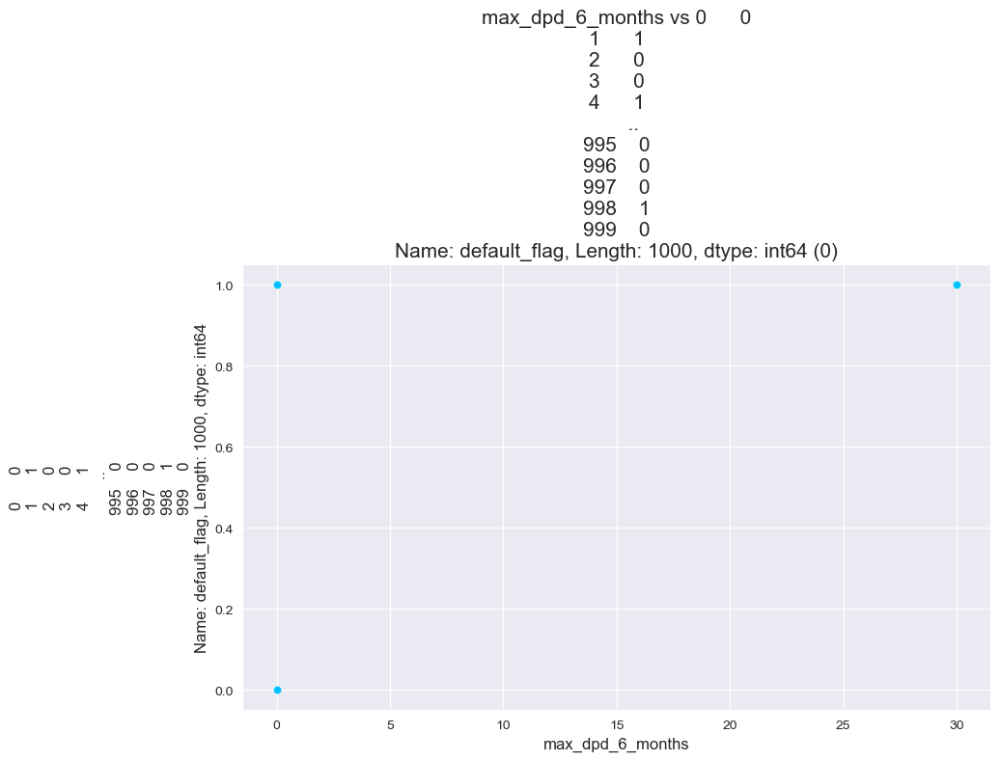

...

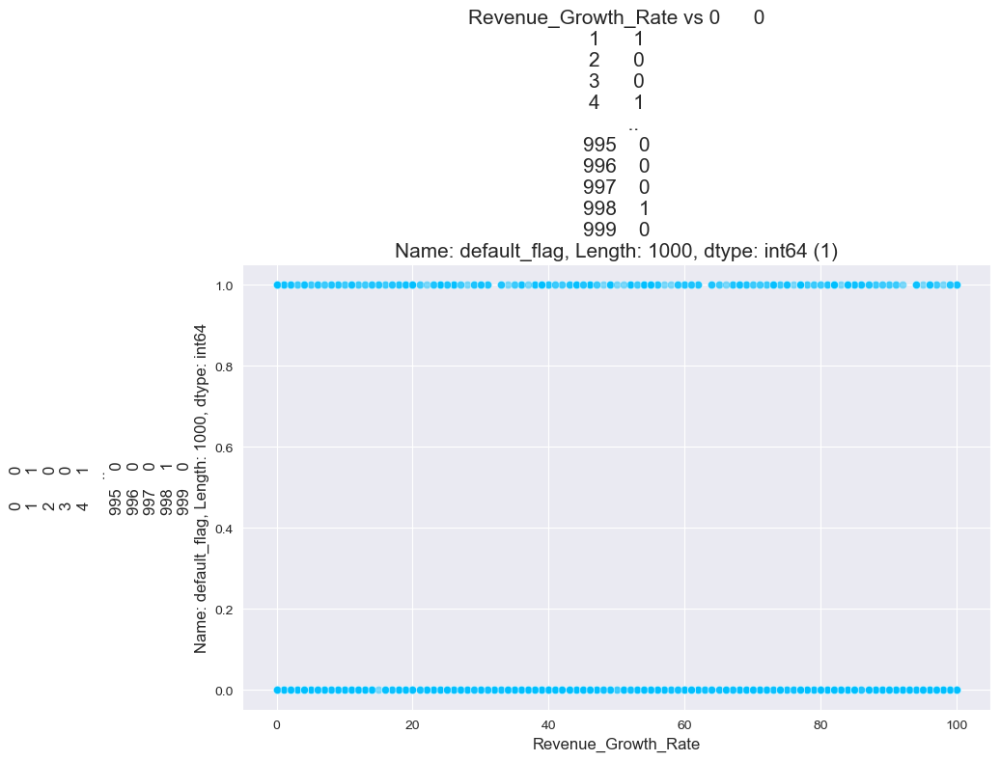

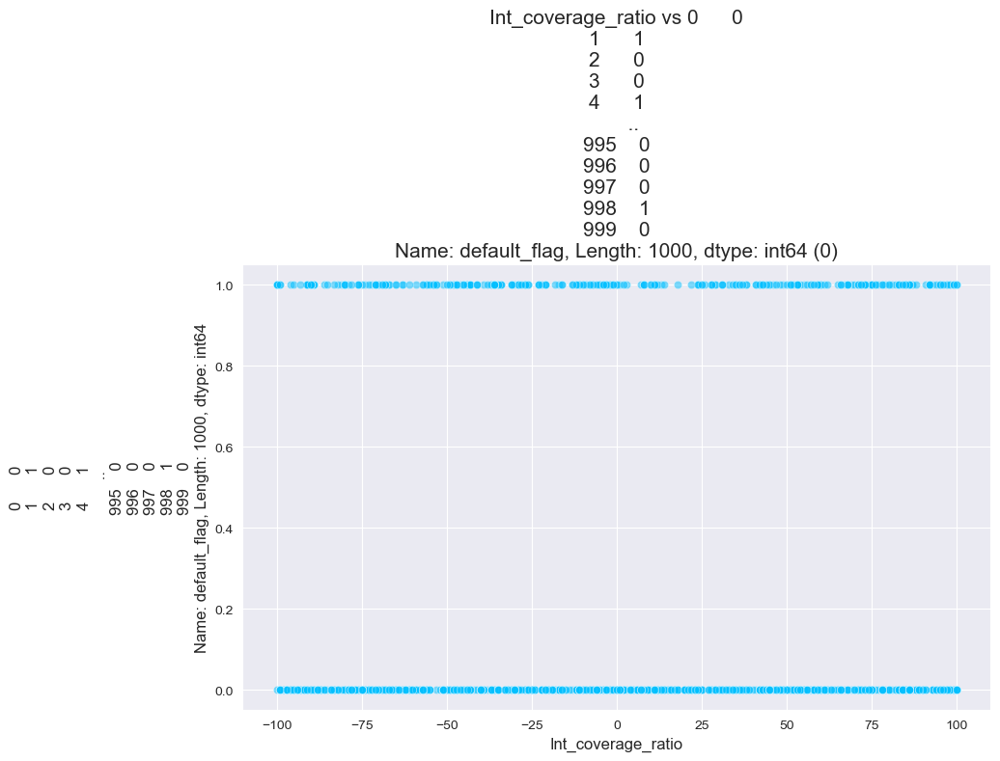

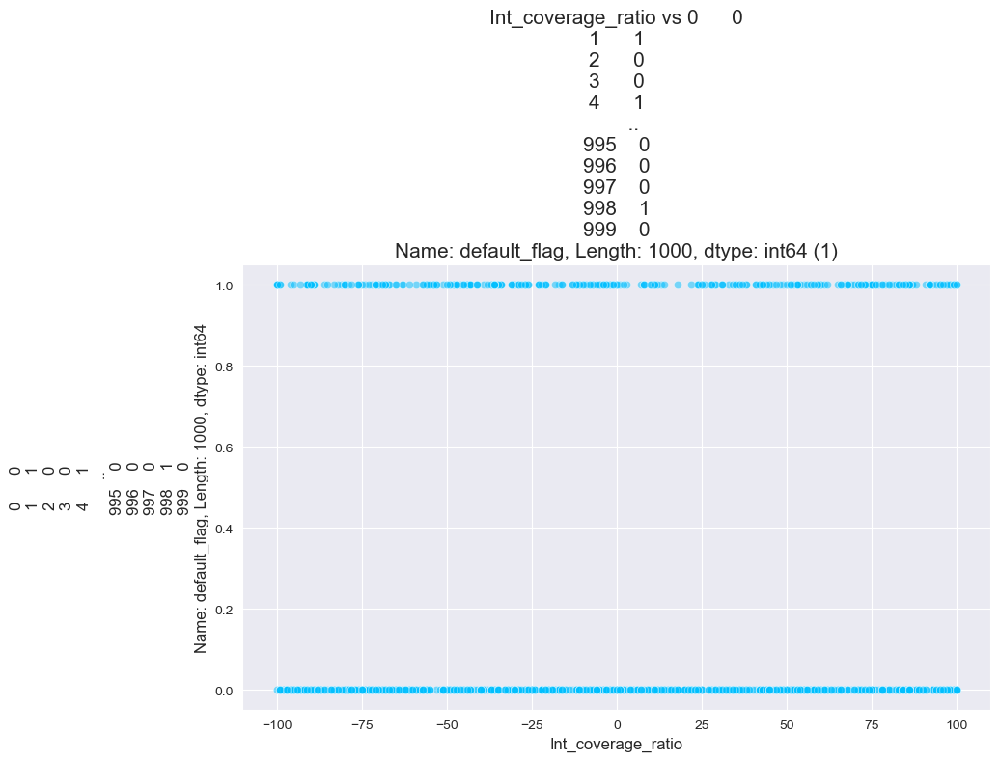

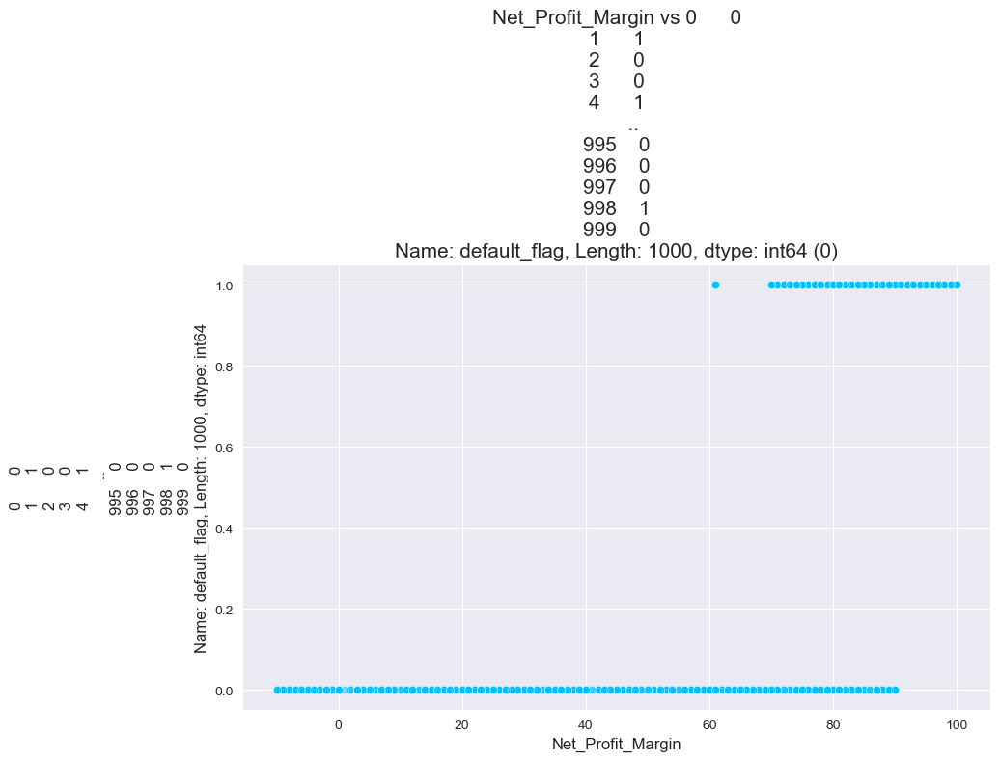

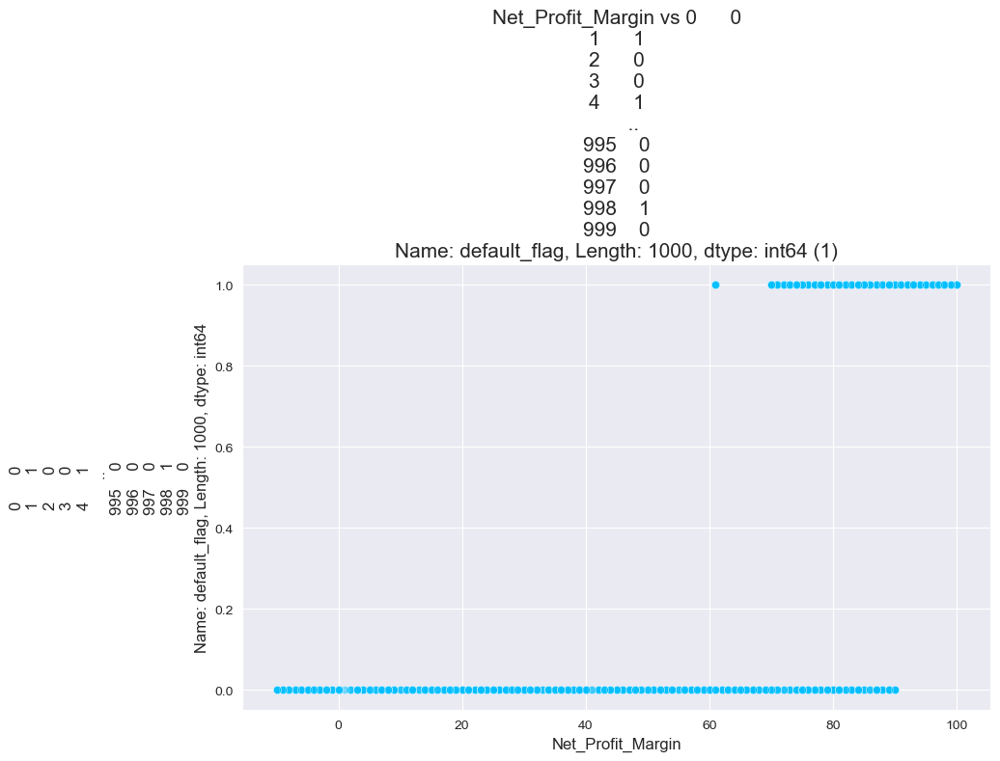

In [46]:
# Separate scatter plots for default_flag = 0 and default_flag = 1
numerical_cols=[col for col in numerical_cols if col not in exclude_columns]
for col in numerical_cols:
    for flag_value in df1['default_flag'].unique():
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=col, y=df1['default_flag'], data=df1, alpha=0.5, color='deepskyblue')
        plt.title(f'{col} vs {target} ({flag_value})', fontsize=15)
        plt.xlabel(col, fontsize=12)
        plt.ylabel(target, fontsize=12)
        plt.grid(True)
        plt.show()

The above code shows the distribution of the independent features across the default and no default flags and reflects the feature distribution 
across the target value which may help to decide which feature can introduce bias in the predicted output and hence needs to treated before application in the model.

# In a credit risk model, determining the correlation between independent features and the default flag (the target variable) is a fundamental step in feature engineering that ensures the model is both accurate and efficient.
This analysis helps in the following specific ways:

## 1. Identifying Predictive Power (Feature Selection)
Correlation acts as a primary filter to separate useful signals from noise.

Relevance: Features with a high absolute correlation with the default flag (whether positive or negative) are strong candidates for inclusion because they directly help distinguish between "good" and "bad" borrowers.

Efficiency: Features with near-zero correlation can often be discarded early, reducing computational costs and model complexity. 

## 2. Eliminating Redundancy (Multicollinearity)
Correlation analysis is used to identify independent features that provide identical information.

Redundancy Check: If two independent features are highly correlated with each other (e.g., above 0.7 or 0.9), they are considered redundant. Including both can lead to unstable model coefficients and overfitting.

Decision Rule: When two features are redundant, practitioners typically retain the one with the higher correlation to the default flag (or higher Information Value) and drop the other. 

## 3. Guiding Feature Transformation
The strength and nature of the correlation dictate how data should be pre-processed.

Non-linear Relationships: If a standard Pearson correlation is low but the feature is logically important, it may signal a non-linear relationship. This prompts engineers to use techniques like Weight of Evidence (WoE) encoding or binning to capture the risk trend more effectively.

Interaction Terms: Identifying how features correlate with the target in different segments can lead to the creation of interaction features (e.g., combining "Income" and "Loan Amount" into a "Debt-to-Income" ratio). 

## 4. Detecting Data Leakage
Unusually high correlations (e.g., >0.95) between an independent feature and the default flag can be a red flag for data leakage

Early Warning: This often indicates that the feature contains information from the future (information that wouldn't be available at the time of the loan application), such as "Number of late payment notices sent". 

## 5. Ensuring Regulatory Compliance & Interpretability
In highly regulated financial environments, models must be "explainable."

Transparency: Correlation provides a straightforward statistical justification for why a specific variable (like "Credit Utilization") is being used to judge a borrower's risk. This helps meet audit and regulatory requirements by proving a clear link to default

In [47]:
# Correlation Analysis for numerical columns
numerical_cols=[col for col in numerical_cols if col not in exclude_columns]
target="default_flag"
for col in numerical_cols:
    # Calculate correlation using the column name string
    corr = df1[col].corr(df1[target])
    
    print(f"Correlation of '{col}' with {target}: {corr:.2f}")

Correlation of 'saving_ratio' with default_flag: 0.50
Correlation of 'debt_saving_ratio' with default_flag: 0.50
Correlation of 'max_dpd_6_months' with default_flag: 0.31
Correlation of 'max_dpd_12_months' with default_flag: 0.29
Correlation of 'max_dpd_24_months' with default_flag: 0.29
Correlation of 'problematic_cheque_count' with default_flag: 0.02
Correlation of 'duration_in_month' with default_flag: 0.21
Correlation of 'credit_amount' with default_flag: 0.15
Correlation of 'installment_as_income_perc' with default_flag: 0.07
Correlation of 'present_res_since' with default_flag: 0.00
Correlation of 'average_credit_duration' with default_flag: -0.09
Correlation of 'credits_this_bank' with default_flag: -0.05
Correlation of 'people_under_maintenance' with default_flag: -0.00
Correlation of 'sector_risk' with default_flag: 0.52
Correlation of 'EBITDA' with default_flag: 0.23
Correlation of 'ROE' with default_flag: 0.47
Correlation of 'ROA' with default_flag: 0.62
Correlation of 'Reve

Numerical Columns showing highest correlation with the target are
1-ROA-0.62

2-sector_risk-0.52

3-saving_ratio-0.50

4-debt_saving_ratio-0.50

5-ROE-0.47

There are also few features that have near to 0 correlation with the default flag indicating they must have minimal predictive power

# Correlation Analysis for categorical columns with the target variable
Since correlation can be establisehed only when there linear relationship between two quantitative variables hence by using sklearn labelencoder() we convert the categorical features (hashable Strings) into normalised numeric format.

Each feature with unique(n) classes is assigned in the range 0 to (n-1) in the normalised format.

le.classes_ attribute stores the unique original categories, allowing you to see the mapping from integer to original label.

The inverse_transform() method can convert the encoded numerical values back to their original labels. 

In [48]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

label_encoder = LabelEncoder()
target_name = 'default_flag' 

for col in categorical_cols:
    # 1. Encode the feature
    encoded_feature = label_encoder.fit_transform(df1[col])
    
    # 2. Convert to Series and align index with df1 to ensure proper correlation
    s_encoded = pd.Series(encoded_feature, index=df1.index)
    
    # 3. Calculate correlation using the column name string
    corr = s_encoded.corr(df1[target_name])
    
    print(f"Correlation of '{col}' with {target_name}: {corr:.2f}")



Correlation of 'customer_segment' with default_flag: 0.26
Correlation of 'credit_history' with default_flag: 0.10
Correlation of 'purpose' with default_flag: -0.00
Correlation of 'savings' with default_flag: -0.13
Correlation of 'sme_history_begin' with default_flag: 0.00
Correlation of 'other_debtors' with default_flag: -0.03
Correlation of 'sector' with default_flag: 0.03
Correlation of 'customer_profile' with default_flag: 0.11
Correlation of 'business_type' with default_flag: 0.12
Correlation of 'revenue_range' with default_flag: -0.03
Correlation of 'foreign_stakeholders' with default_flag: 0.08


<span style="font-size: 15px;color: blue;font-family: Arial">From  2026 dython package supports to establish association between categorical variables(nominal,ordinal) with the binary target.
in a single step all the variables are processed and there corresponding association coefficients  be obtained<span>

In [49]:
from dython.nominal import associations

# Returns a dataframe containing associations between all categorical features and the target
results = associations(df1, nominal_columns='auto', compute_only=True)
target_correlations = results['corr'][target]
print(target_correlations)

Unnamed: 0                    0.034606
id                            0.034606
date                         -0.038248
saving_ratio                  0.496870
debt_saving_ratio             0.496898
default_flag                  1.000000
max_dpd_6_months              0.311805
max_dpd_12_months             0.291156
max_dpd_24_months             0.293453
problematic_cheque_count      0.019054
customer_segment              0.351740
duration_in_month             0.214927
credit_history                0.248378
purpose                       0.182806
credit_amount                 0.154739
savings                       0.189997
sme_history_begin             0.135530
installment_as_income_perc    0.072404
other_debtors                 0.081519
present_res_since             0.002967
sector                        0.154012
average_credit_duration      -0.091127
customer_profile              0.113310
business_type                 0.134907
credits_this_bank            -0.045732
revenue_range            

### For categorical features the maximum correlation value is 
customer_segment-0.35

business_type-0.13

customer_profile 0.11

Few other features bear negative association depicting inverse relationship between the feature and target variable and its predictive power(downside) as compared to the features with positive correlation


customer_segment:
  Unique Categories: 4
  Value Counts:
customer_segment
large_sme     0.394
micro_sme     0.274
medium_sme    0.269
small_sme     0.063
Name: proportion, dtype: float64


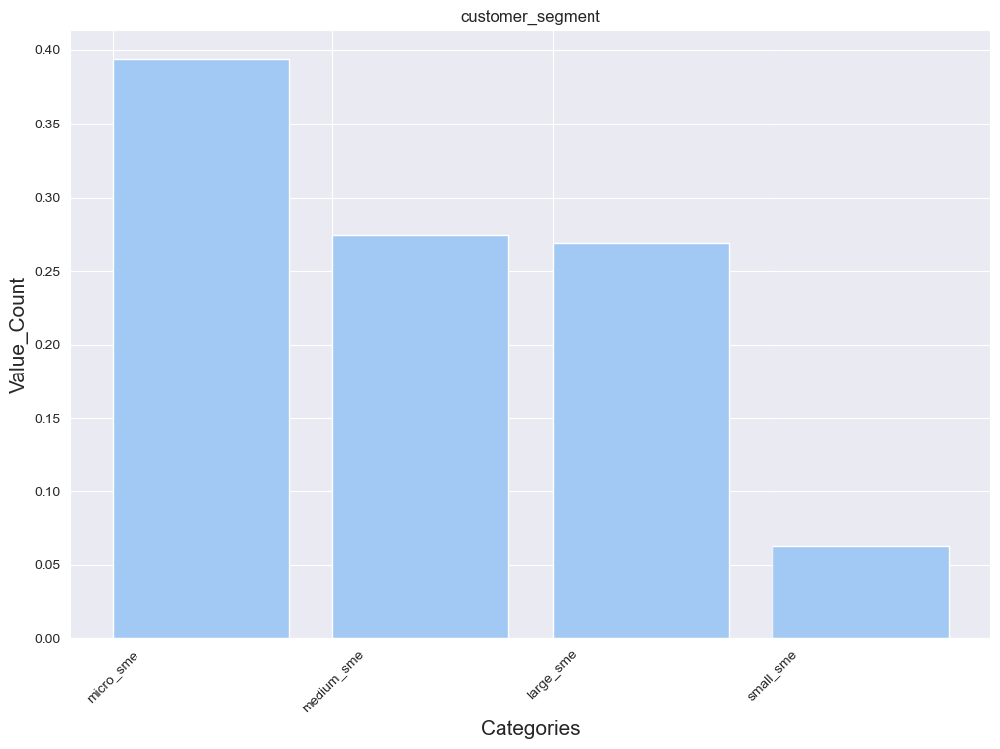


credit_history:
  Unique Categories: 5
  Value Counts:
credit_history
existing credits paid back duly till now                       0.530
critical account/ other credits existing (not at this bank)    0.293
delay in paying off in the past                                0.088
all credits at this bank paid back duly                        0.049
no credits taken/ all credits paid back duly                   0.040
Name: proportion, dtype: float64


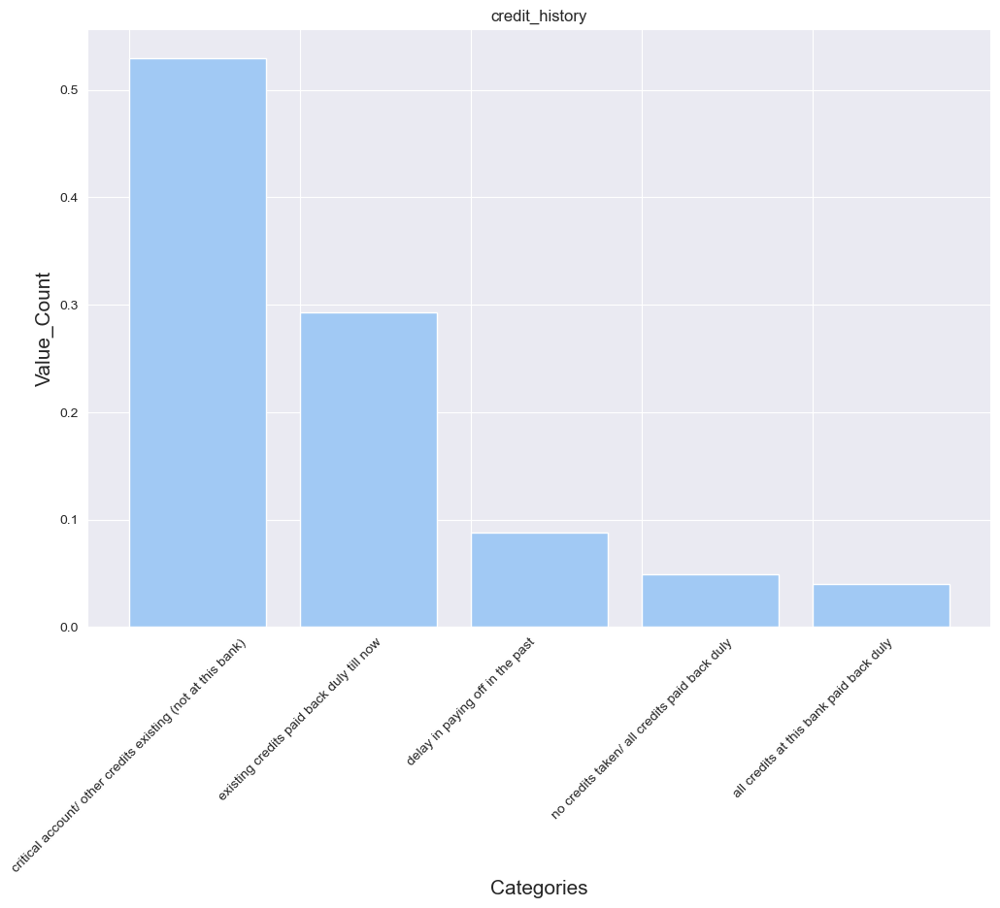


purpose:
  Unique Categories: 11
  Value Counts:
purpose
domestic appliances    0.280
car (new)              0.234
rent_payment           0.181
car (used)             0.103
business               0.092
lease_investment       0.050
education              0.022
repairs                0.012
furniture/equipment    0.012
retraining             0.009
Name: proportion, dtype: float64


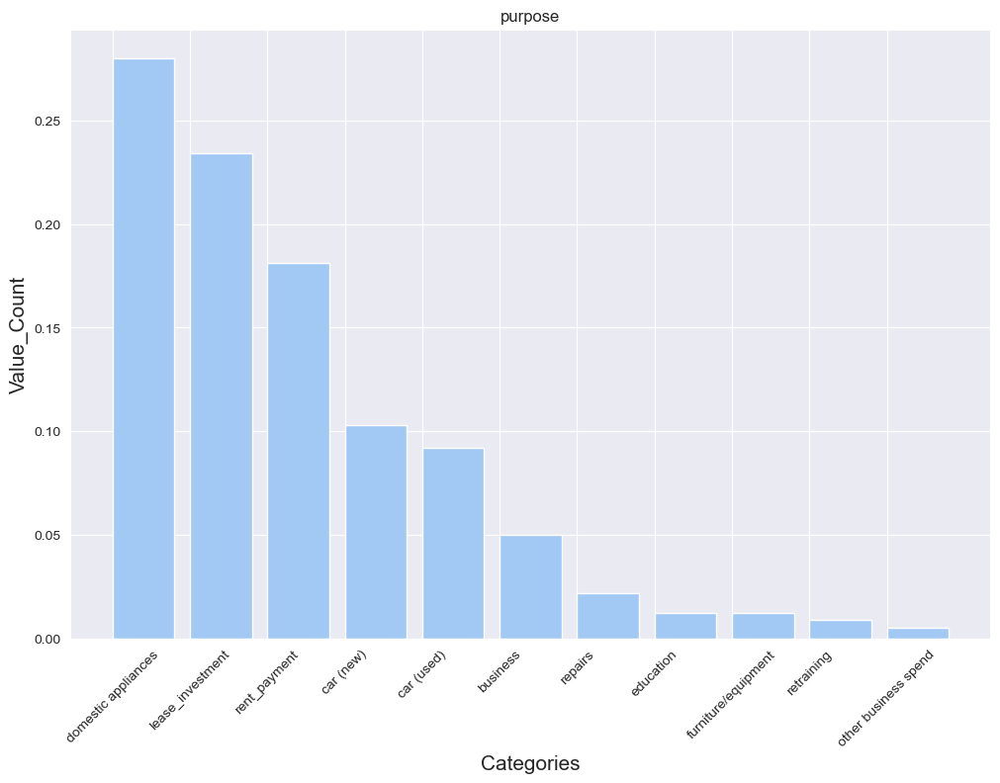


savings:
  Unique Categories: 5
  Value Counts:
savings
... < 100 DM                   0.603
unknown/ no savings account    0.183
100 <= ... < 500 DM            0.103
500 <= ... < 1000 DM           0.063
.. >= 1000 DM                  0.048
Name: proportion, dtype: float64


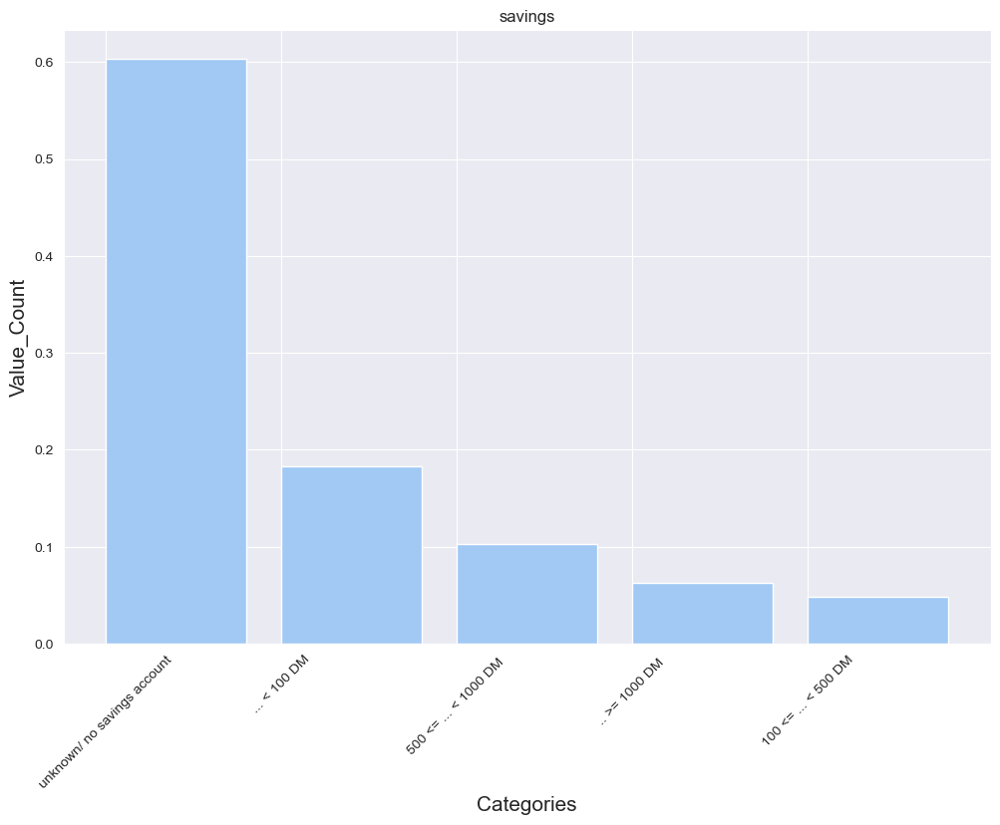


sme_history_begin:
  Unique Categories: 5
  Value Counts:
sme_history_begin
1 <= ... < 4 years    0.339
.. >= 7 years         0.253
4 <= ... < 7 years    0.174
... < 1 year          0.172
new company           0.062
Name: proportion, dtype: float64


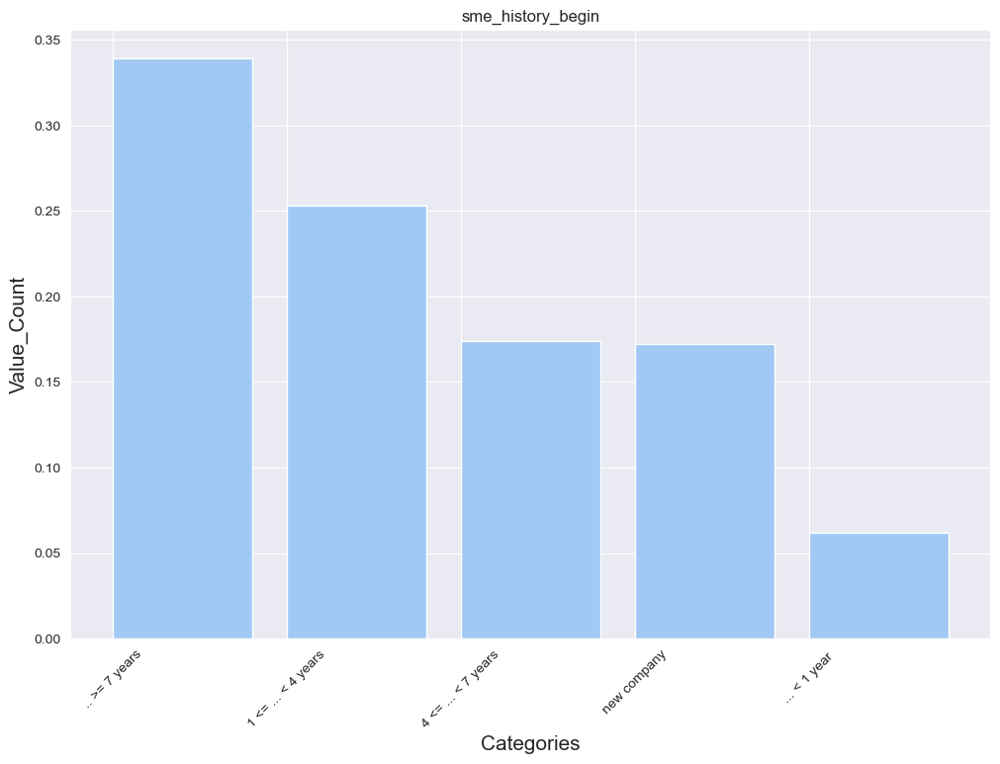


other_debtors:
  Unique Categories: 3
  Value Counts:
other_debtors
none            0.907
guarantor       0.052
co-applicant    0.041
Name: proportion, dtype: float64


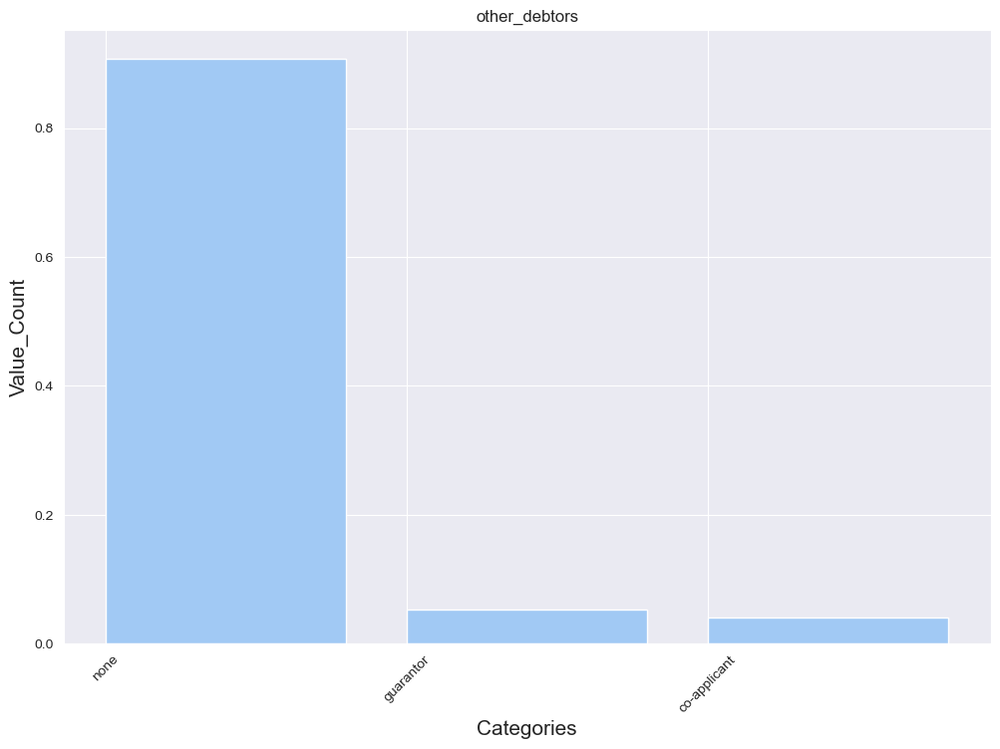


sector:
  Unique Categories: 4
  Value Counts:
sector
Construction          0.332
Real Estate           0.282
Oil and gas           0.232
Telecommunications    0.154
Name: proportion, dtype: float64


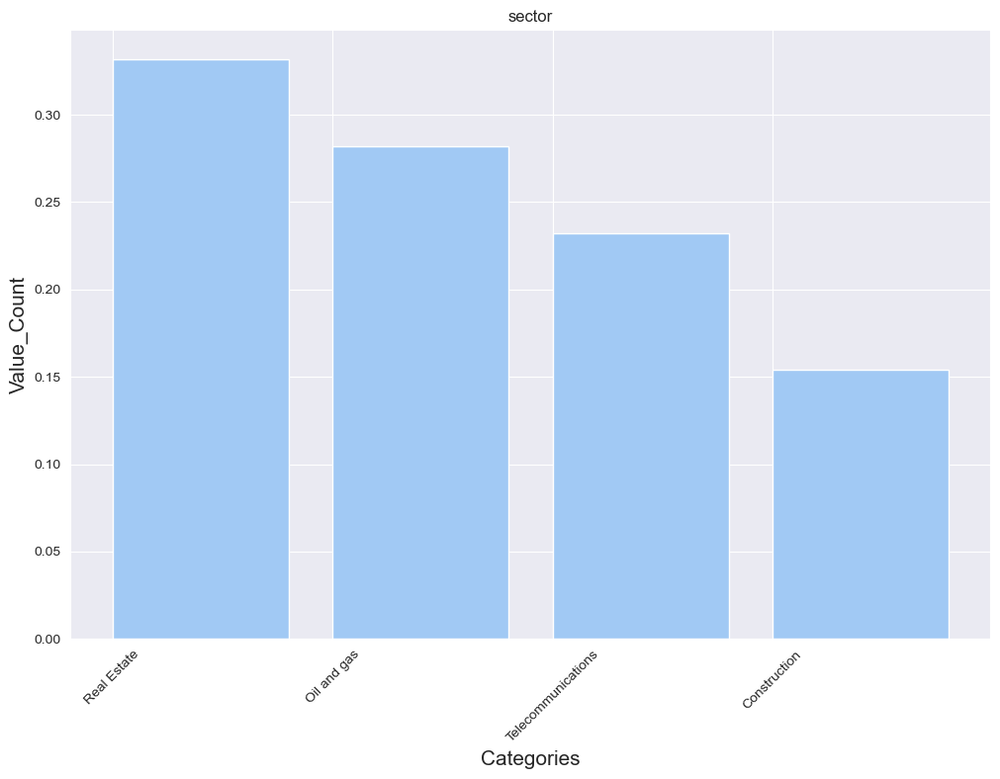


customer_profile:
  Unique Categories: 3
  Value Counts:
customer_profile
individual_consumers    0.814
small_businesses        0.139
large_enterprises       0.047
Name: proportion, dtype: float64


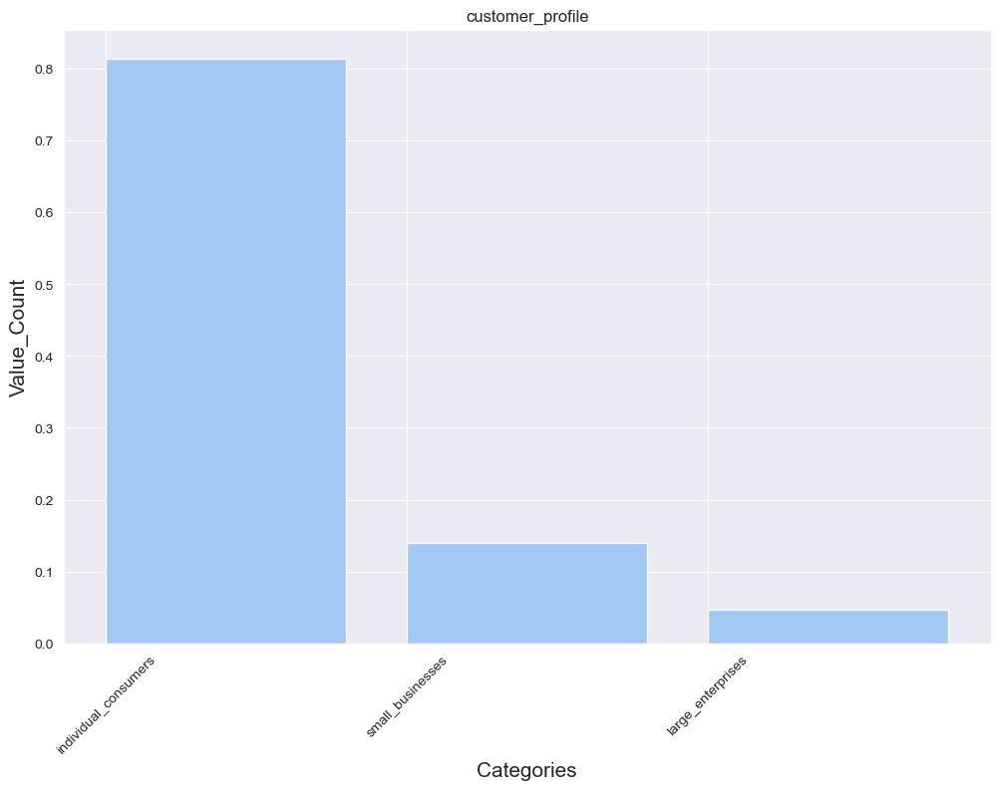


business_type:
  Unique Categories: 3
  Value Counts:
business_type
corporation            0.713
sole_proprietorship    0.179
partnership            0.108
Name: proportion, dtype: float64


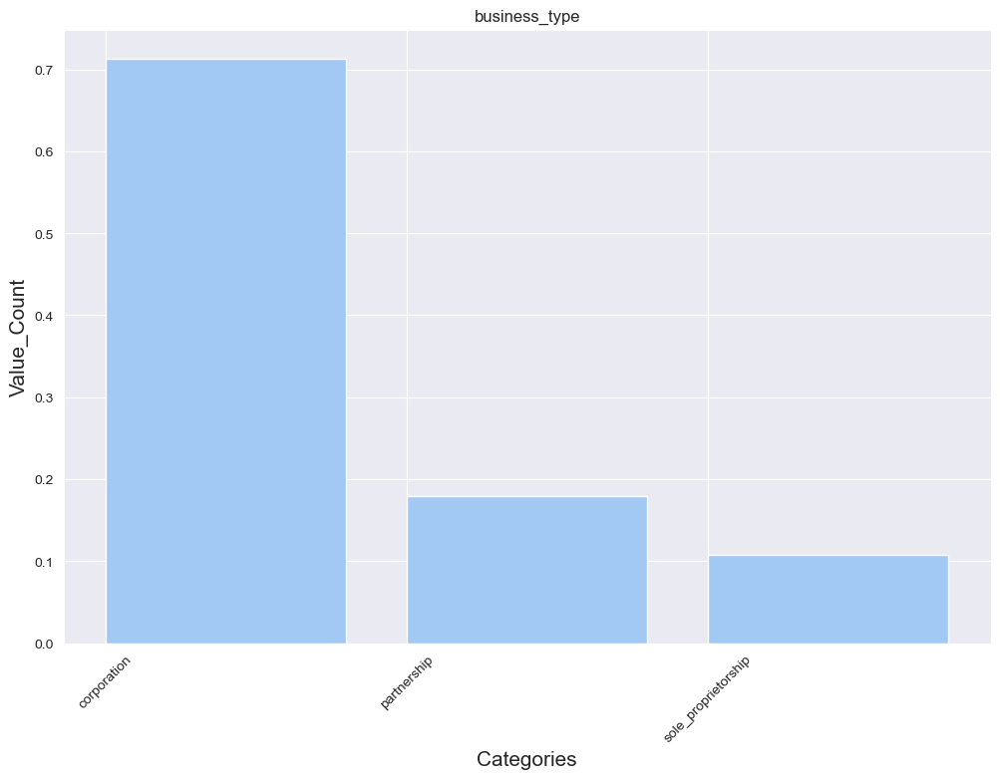


revenue_range:
  Unique Categories: 4
  Value Counts:
revenue_range
5m-10m    0.646
1m-5m     0.192
10m+      0.140
0m-1m     0.022
Name: proportion, dtype: float64


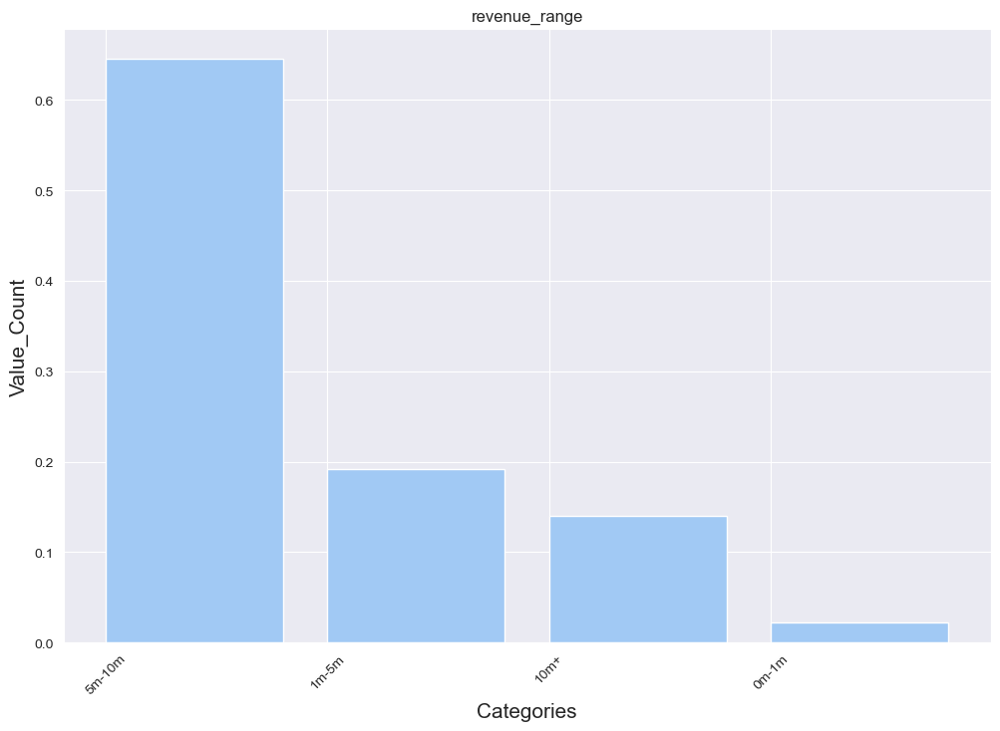


foreign_stakeholders:
  Unique Categories: 2
  Value Counts:
foreign_stakeholders
yes    0.963
no     0.037
Name: proportion, dtype: float64


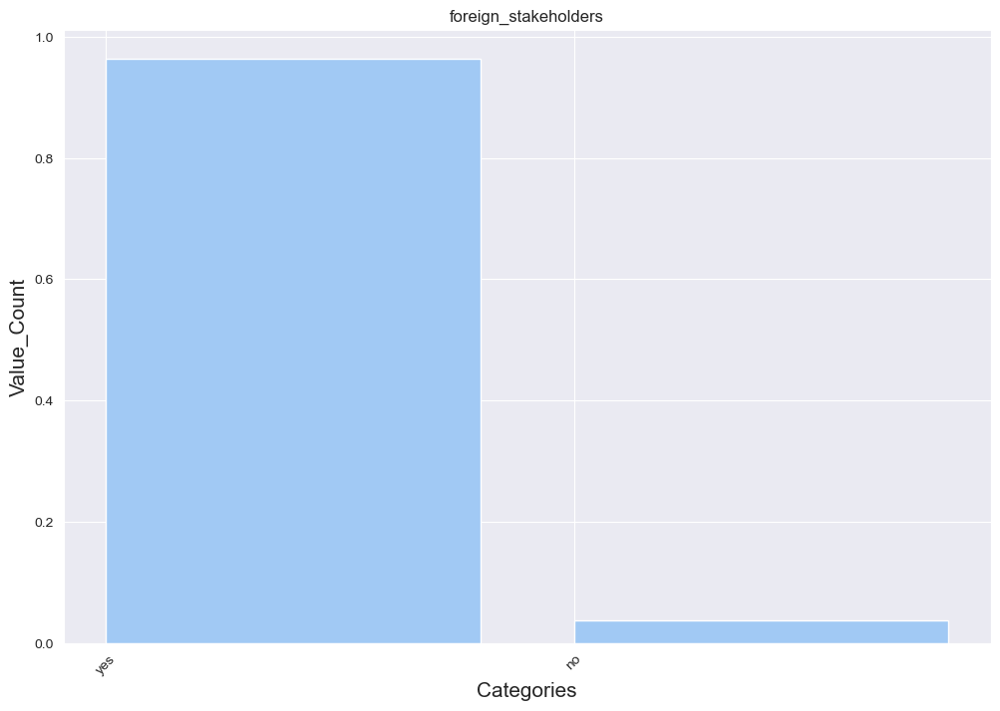

In [50]:
# Categorical Variables details
categorical_cols = [col for col in categorical_cols if col not in exclude_columns]
for col in categorical_cols:
    print(f"\n{col}:")
    print(f"  Unique Categories: {df1[col].nunique()}")
    print(f"  Value Counts:\n{df1[col].value_counts(normalize=True).head(10)}") # By using normalize parameter we are calculating the proportion of the segement values to the total values  
    plt.figure(figsize=(12,8))    
    plt.bar(x=df1[col].unique(),height=df1[col].value_counts(normalize=True).head(11),align='edge',data=df1[col])
    plt.title(col)
    plt.xlabel("Categories",fontsize=15)
    plt.ylabel("Value_Count",fontsize=15)
    plt.xticks(rotation=45)
    plt.show()


# How much does each of the categorical column impact the default_flag.
Using the groupby method to calculate the average default by each of the categorical columns

In [51]:
default_flag='default_flag'
cat_cols=[col for col in categorical_cols]
for col in cat_cols:
    average_target=df1.groupby(col)[default_flag].mean().sort_values(ascending=False)
    print(average_target)

customer_segment
micro_sme     0.492701
medium_sme    0.390335
small_sme     0.222222
large_sme     0.116751
Name: default_flag, dtype: float64
credit_history
no credits taken/ all credits paid back duly                   0.625000
all credits at this bank paid back duly                        0.571429
existing credits paid back duly till now                       0.318868
delay in paying off in the past                                0.318182
critical account/ other credits existing (not at this bank)    0.170648
Name: default_flag, dtype: float64
purpose
lease_investment        0.440000
furniture/equipment     0.416667
other business spend    0.400000
car (new)               0.380342
education               0.363636
business                0.347826
repairs                 0.333333
rent_payment            0.320442
domestic appliances     0.221429
car (used)              0.165049
retraining              0.111111
Name: default_flag, dtype: float64
savings
... < 100 DM                   0

# Check for Variability,Stability,Significance ad Risk Distribution across Feature Categories

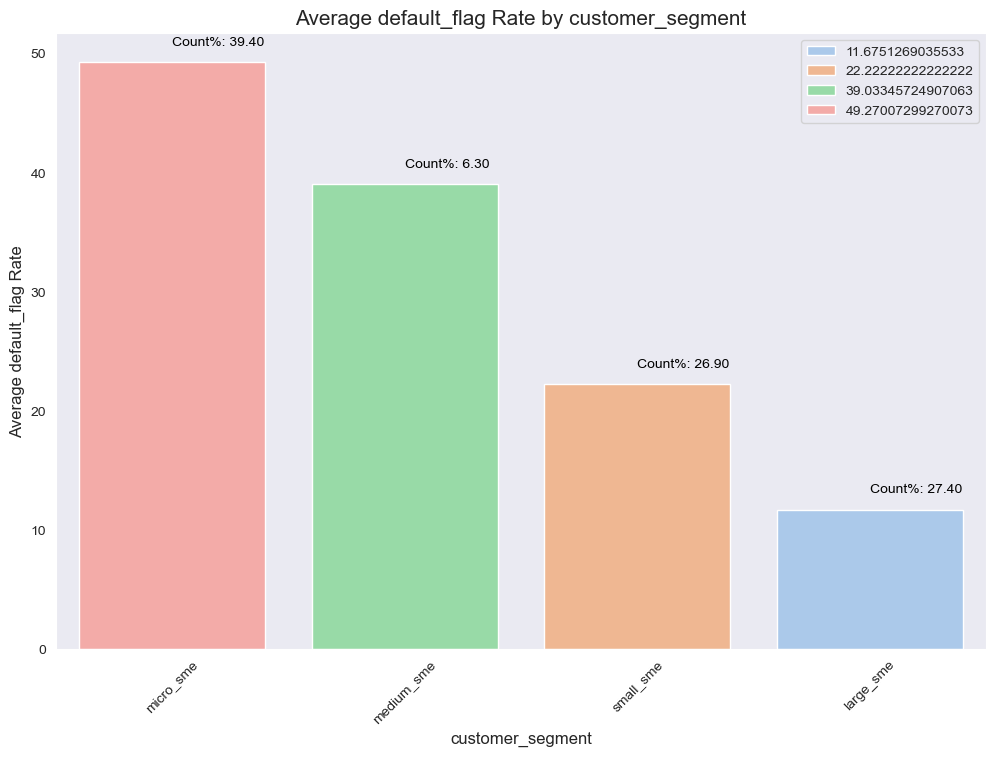

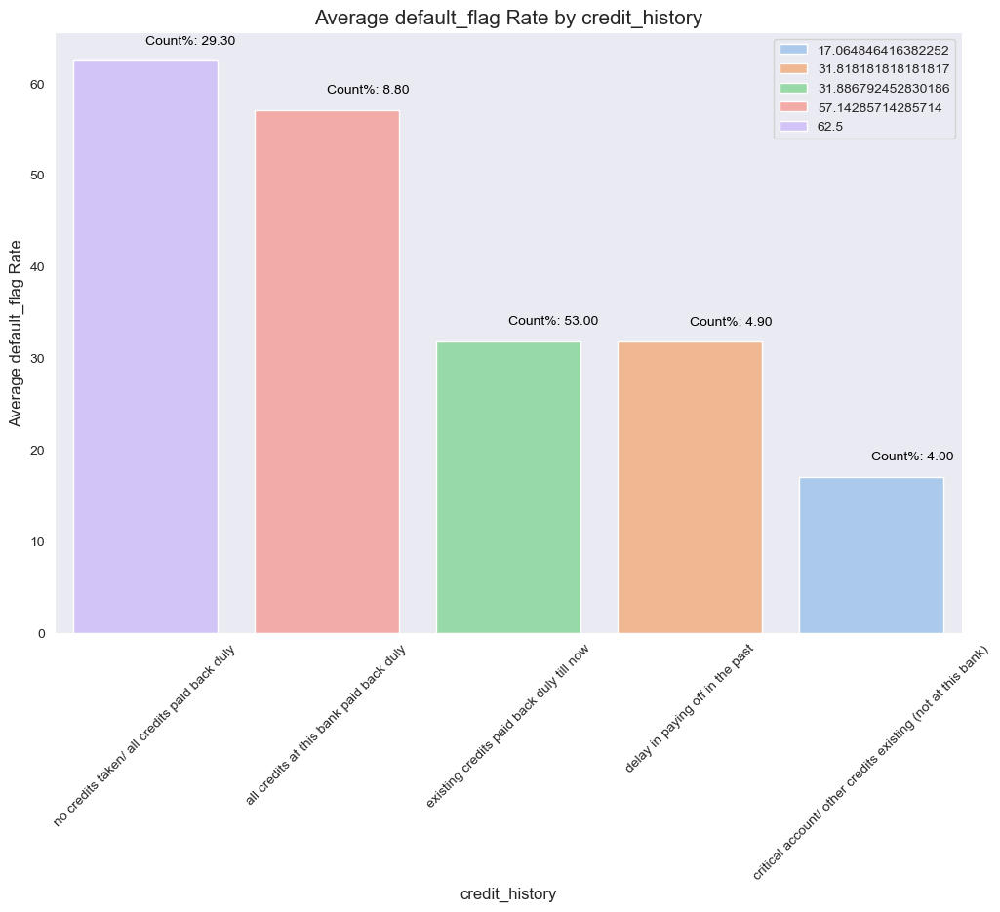

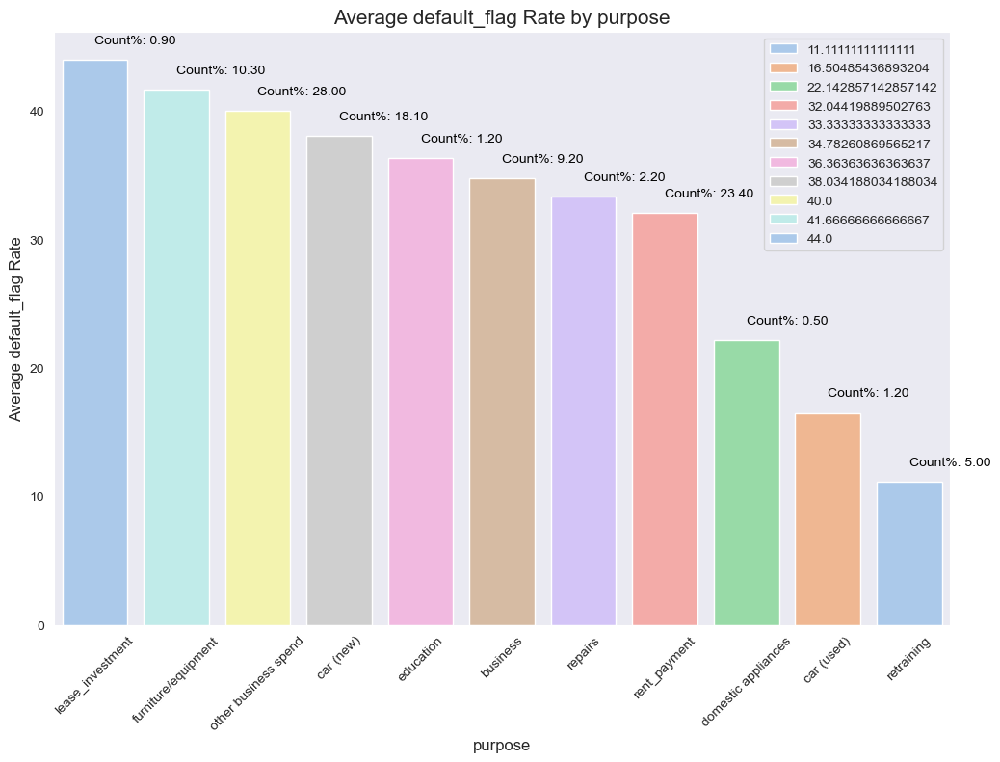

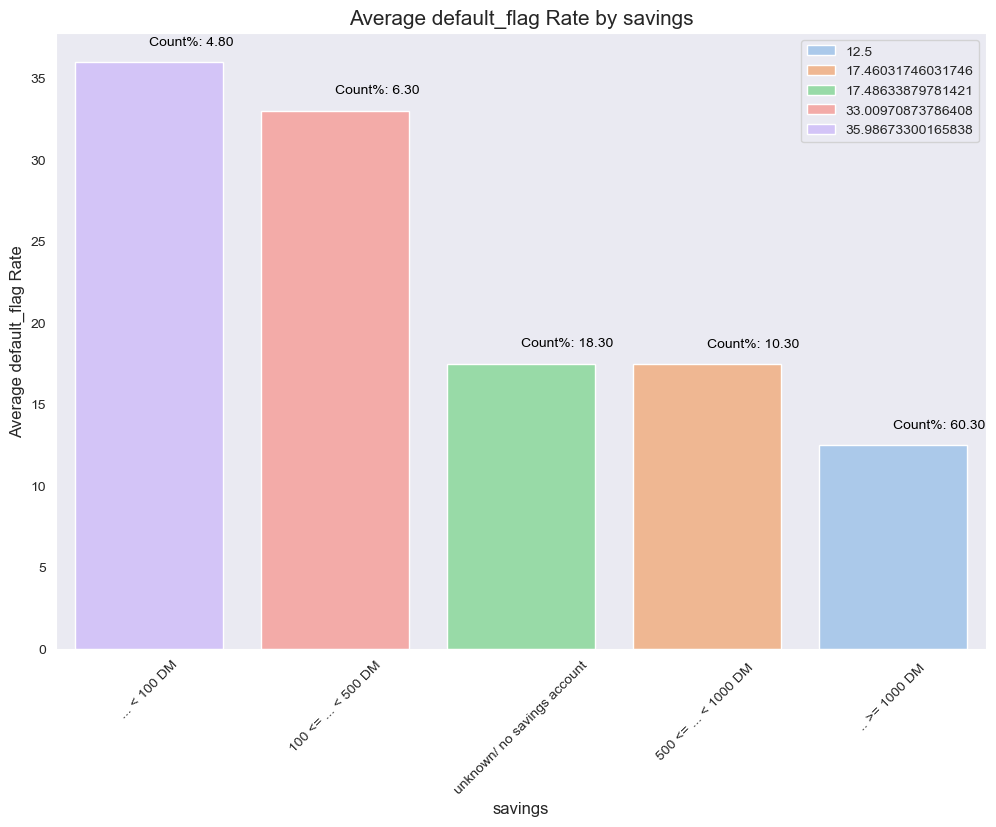

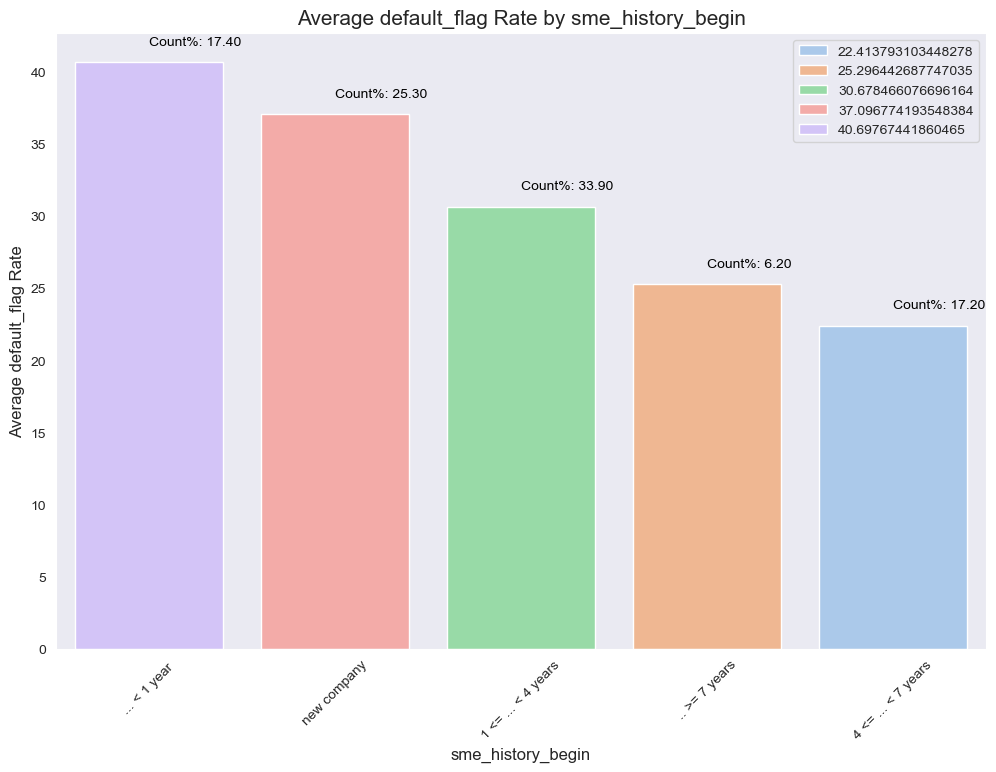

...

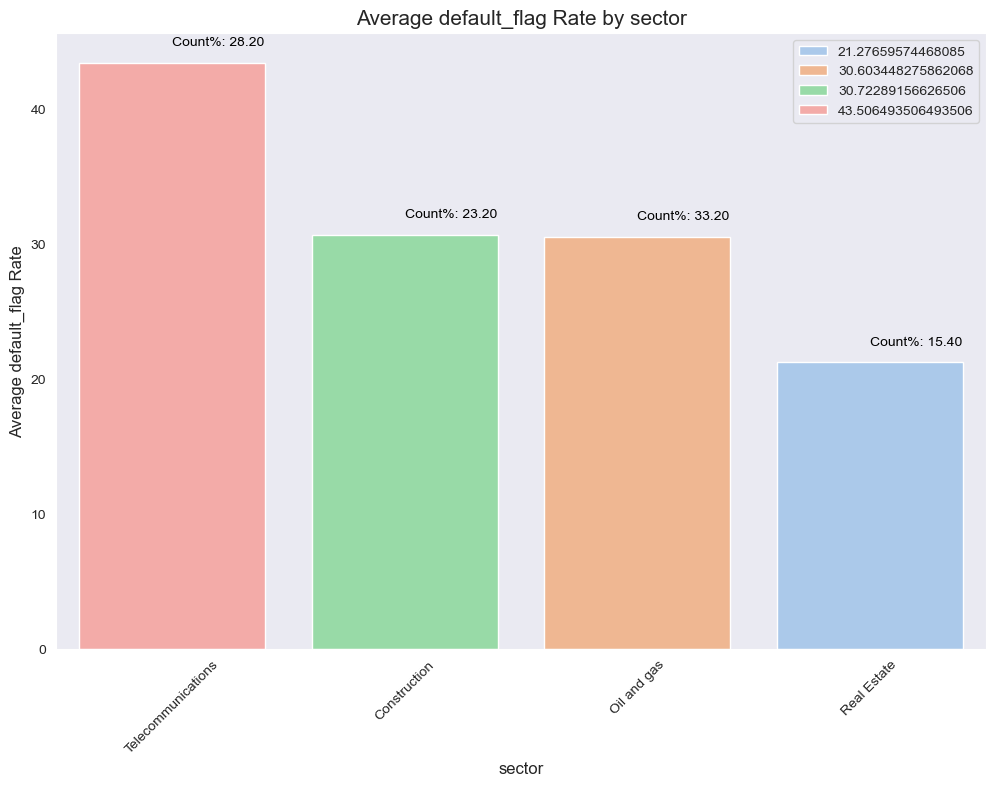

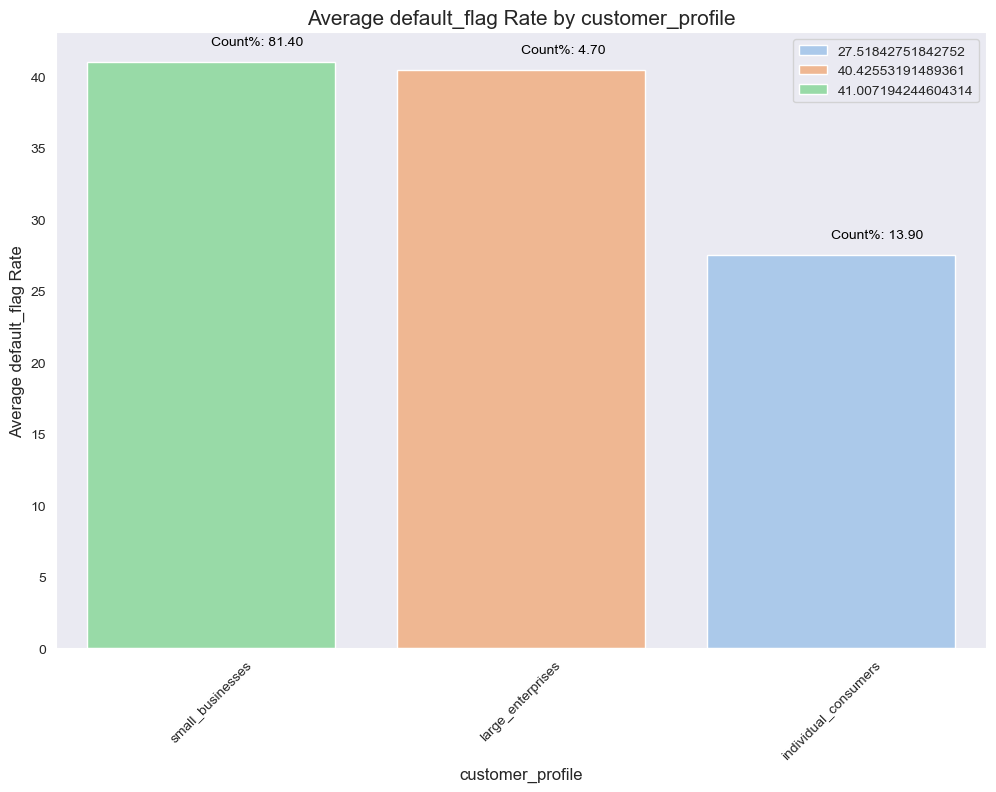

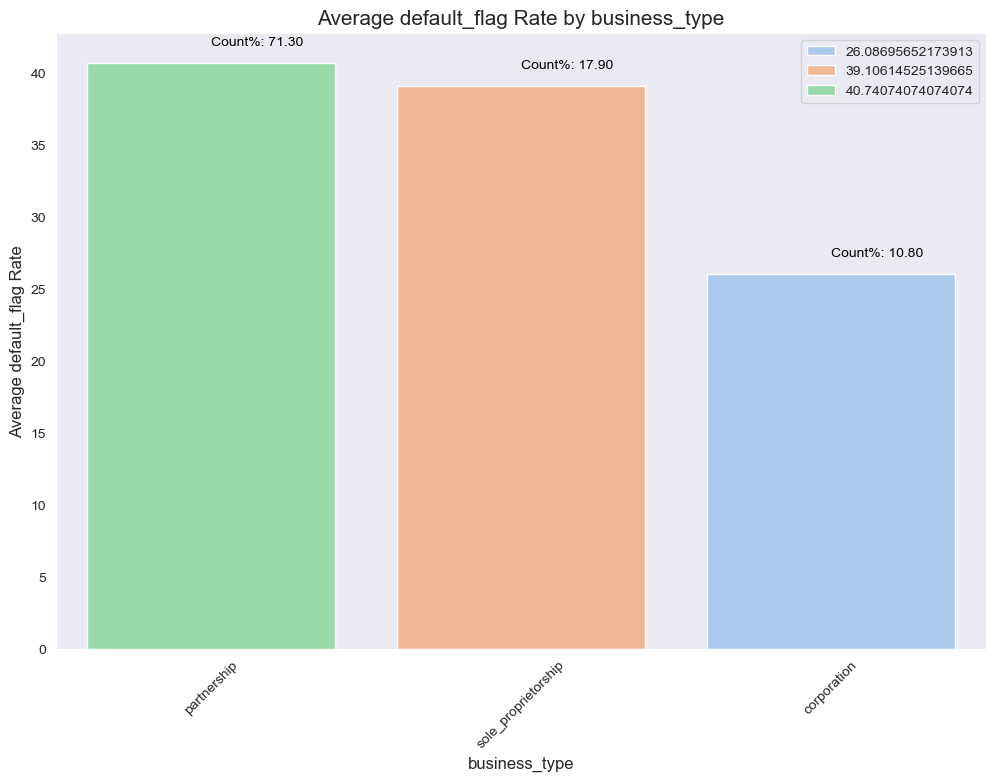

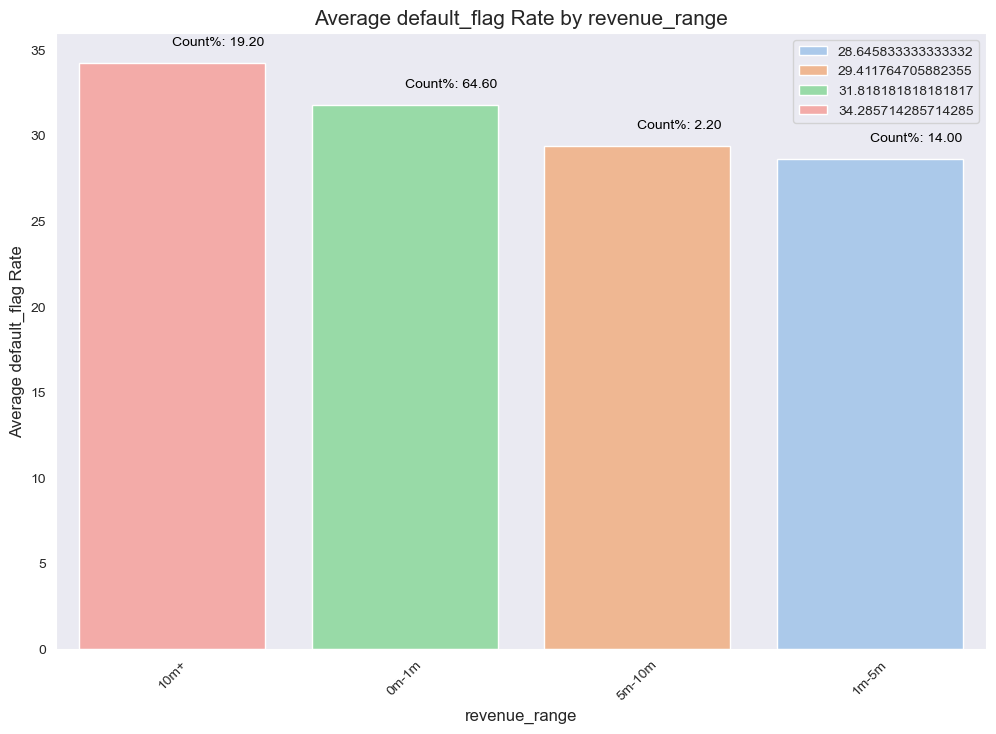

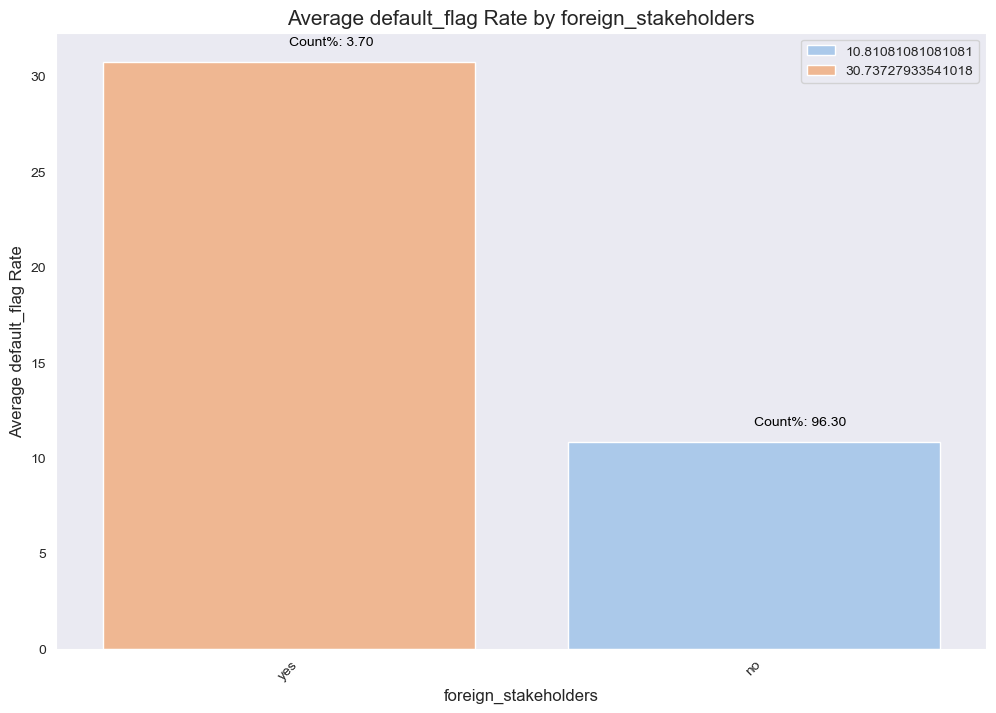

Categorical columns empty 


In [52]:
for col in categorical_cols:

    # Compute average default rate
    avg_defaults = 100*(
        df1.groupby(col)[target]
           .mean()
           .sort_values(ascending=False)
    )

    # Count categories aligned with sorted index
    count_per_category_perc= 100*(df1[col].value_counts(normalize=True).reindex(avg_defaults.index))

    plt.figure(figsize=(12, 8))
    ax = sns.barplot(x=avg_defaults.index, y=avg_defaults.values, palette='pastel',hue=avg_defaults.values)

    plt.title(f'Average {target} Rate by {col}', fontsize=15)
    plt.xlabel(col, fontsize=12)
    plt.ylabel(f'Average {target} Rate', fontsize=12)
    plt.xticks(rotation=45)
    plt.grid(False)

    # Annotate bar counts
    for p, count in zip(ax.patches, count_per_category_perc):
        ax.annotate(
            f'Count%: {count:.2f}',
            (p.get_x() + p.get_width()/2., p.get_height()),# places the annotation on the centre of the bar
            ha='left', va='bottom',
            fontsize=10, color='black',# Alignment and Styling of the text
            xytext=(0, 10),
            textcoords='offset points'
        )

    plt.show()

else:
    print("Categorical columns empty ")


<span style='font-size: 15px; color: red'>High Variability in Small Sample Sizes: Categories with a low count of data points (right side of the plot) will show extreme, unstable default rates. A few defaults in a small sample can cause an artificially high or low default rate, making them unreliable for modeling.<span>

<span style='font-size: 15px; color: green'>Stability in Large Sample Sizes: Categories with a high count of data points (left side of the plot) tend to cluster closer to a specific, more reliable average default rate, as they are less sensitive to individual default events.<span>

Identification of Data Limitations: It highlights which segments of the data have enough observations to be statistically meaningful and which segments are too sparse for accurate prediction.

Relationship Between Risk and Volume: It may reveal if certain risk segments (e.g., high default risk) are underrepresented in the dataset due to low count compared to others.


# Check for pairwise Correlation of Features

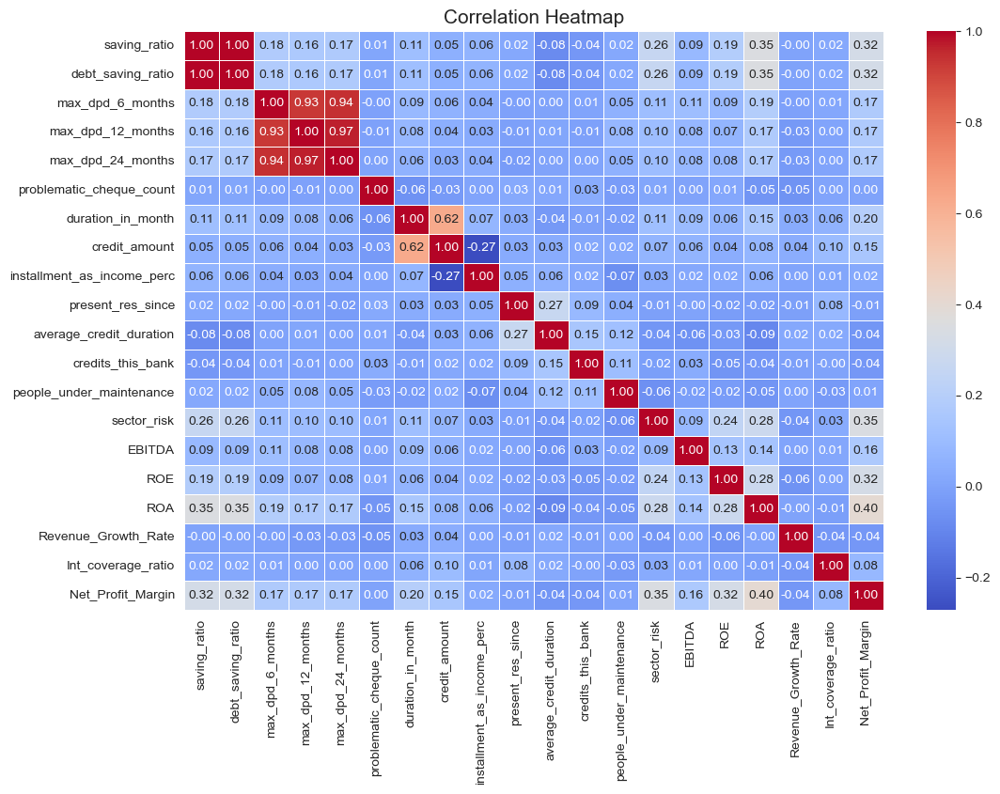

In [53]:
 #Pairwise relationships and correlations (for numerical variables)
plt.figure(figsize=(12, 8))
sns.heatmap(df1[numerical_cols].corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title("Correlation Heatmap", fontsize=15)
plt.show()

# The variables in red are highly correlated and the matrix is symmetrical about the diagonal.

In [54]:
# Extract year, month, and year-month
df1['year'] = df1['date'].dt.year
df1['month'] = df1['date'].dt.month
df1['year_month'] = df1['date'].dt.to_period('M')  # 'M' gives the year-month format
# This extracted information from the date columns will help to conduct time series analysis over the dataset.


1. Correlation of Trends Over Time
===================================
<span style='font-size: 15px; color: red'>Positive Correlation: If both lines trend upward or downward together, it suggests that as the average value of your variable increases, the likelihood of default also increases. This indicates the variable might be a risk driver.<span>

<span style='font-size: 15px; color: green'>Negative/Inverse Correlation: If the lines move in opposite directions (e.g., the numerical value rises while defaults drop), the variable may be a protective factor or "risk mitigator.<span>

2. Predictive Lag or Lead Relationships
========================================
This plot can reveal if changes in the numerical variable precede changes in default rates. For instance, if a sharp drop in average "savings_ratio" occurs in 2024, but the "Default Flag" spike doesn't happen until 2025, the variable serves as a leading indicator for future risk.

4. Impact of Macroeconomic Shifts
====================================
By observing specific years, we can see how external shocks (like interest rate hikes) impacted both the variable and the default rate simultaneously.
Stability: If the numerical variable fluctuates wildly while the default flag remains flat, the variable may have a low correlation with credit risk over time, suggesting it might be a weak predictor for long-term modeling.

6. Identification of Anomalies
=================================
Divergences—where the historical relationship between the two lines suddenly breaks—can highlight regime shifts. For example, if a variable that usually tracks with defaults suddenly stops doing so , it may indicate a change in lending policy, consumer behavior, or data collection methods.


<span style="font-size: 20px;color: red">Be wary of spurious correlations. Because the two axes have different scales, the perceived strength of the relationship can be manipulated by adjusting the axis limits. Always verify the statistical significance of the relationship beyond just the visual trend. <span>


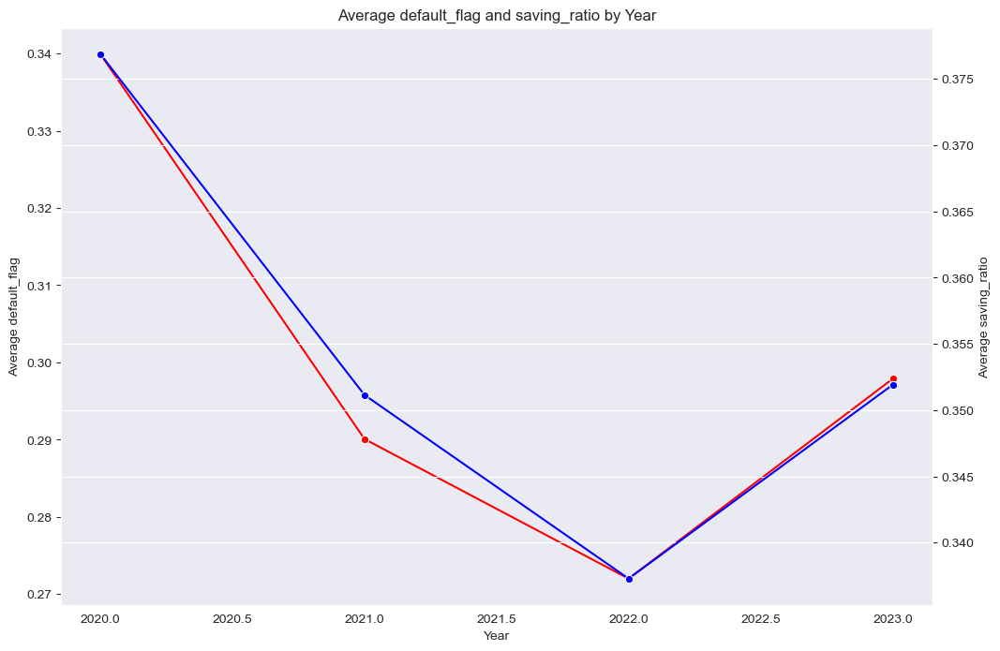

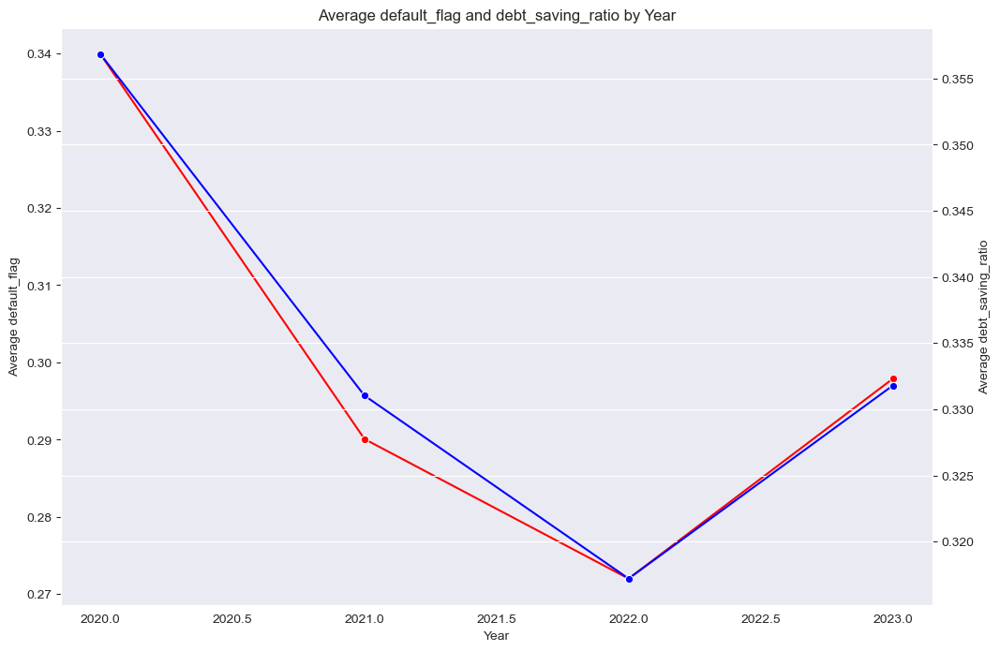

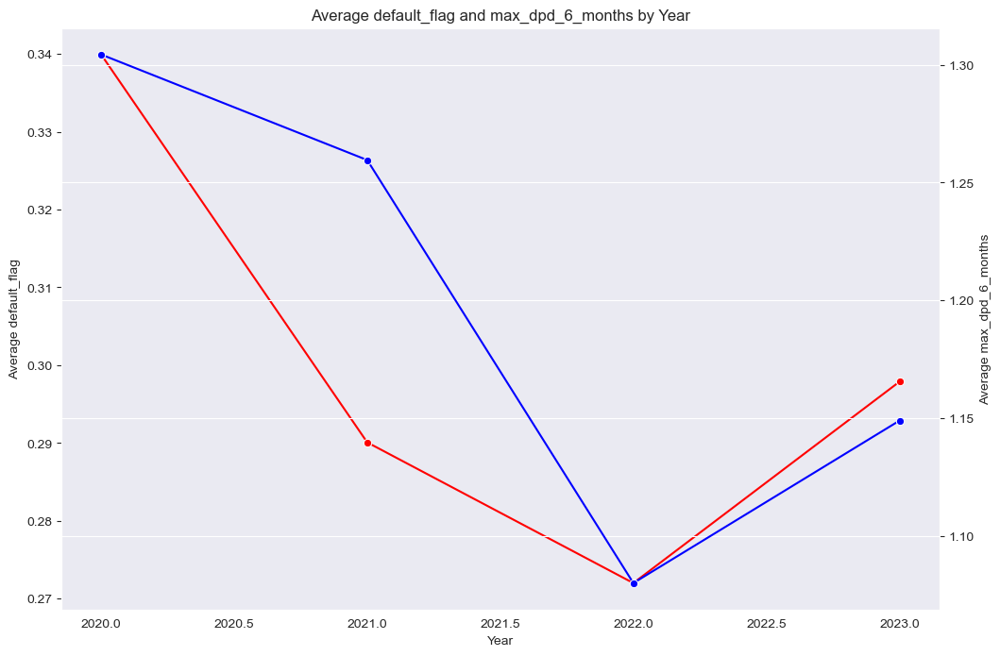

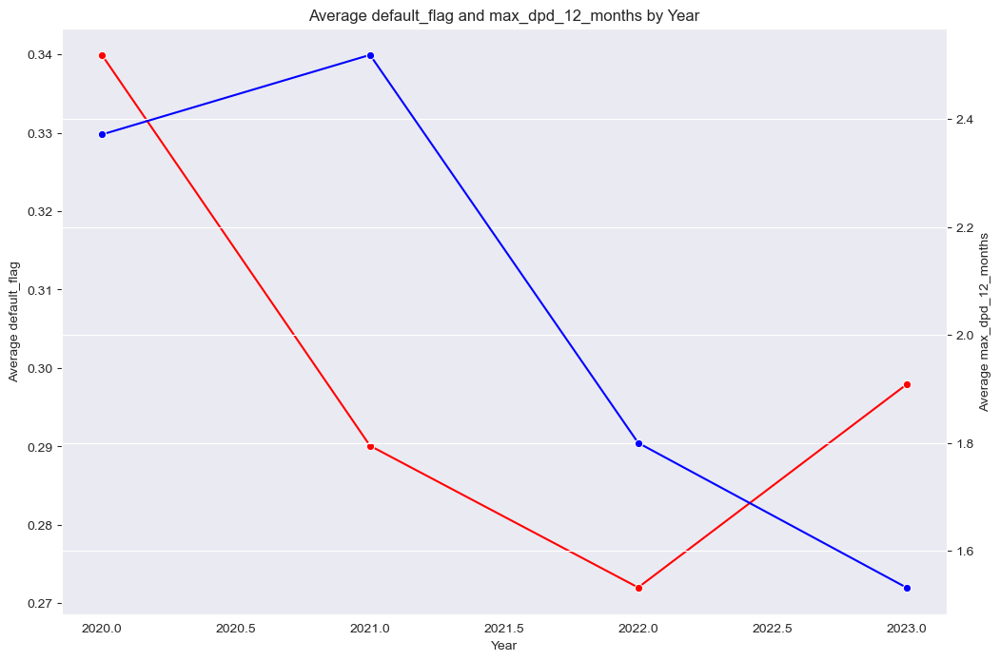

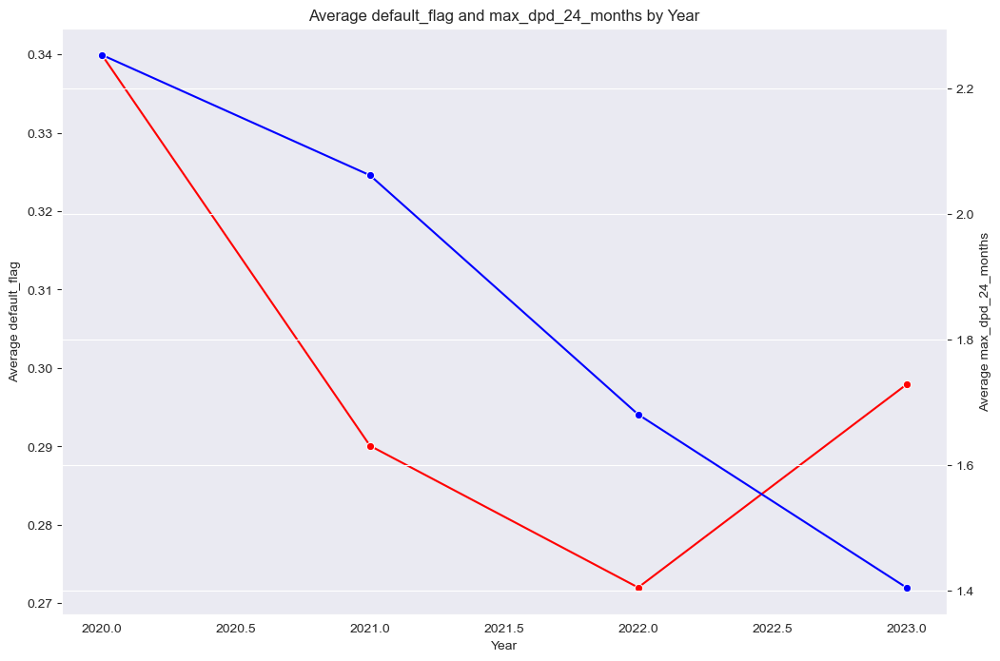

...

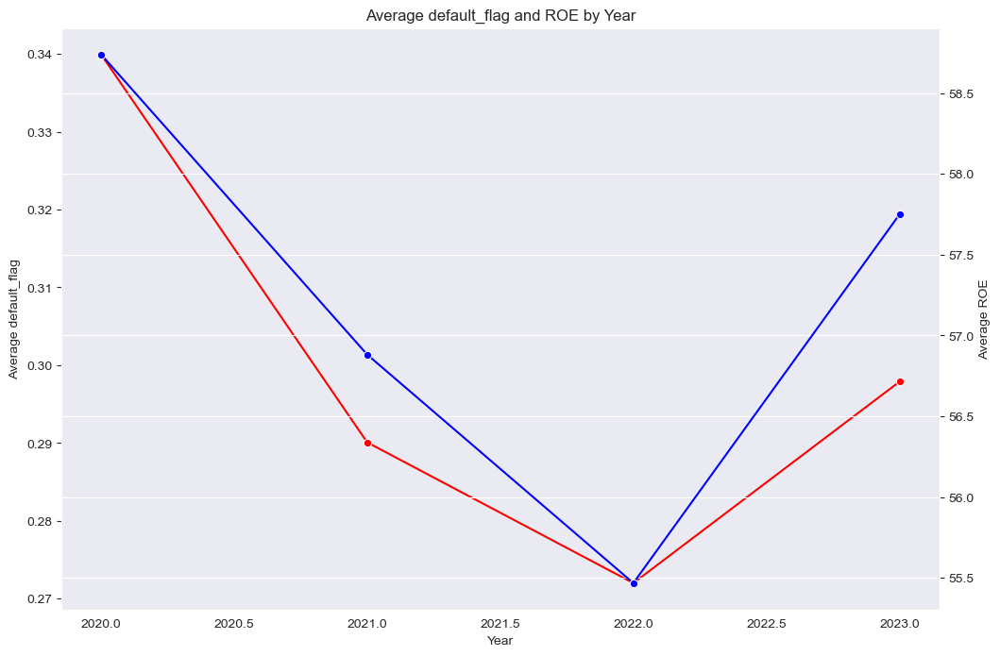

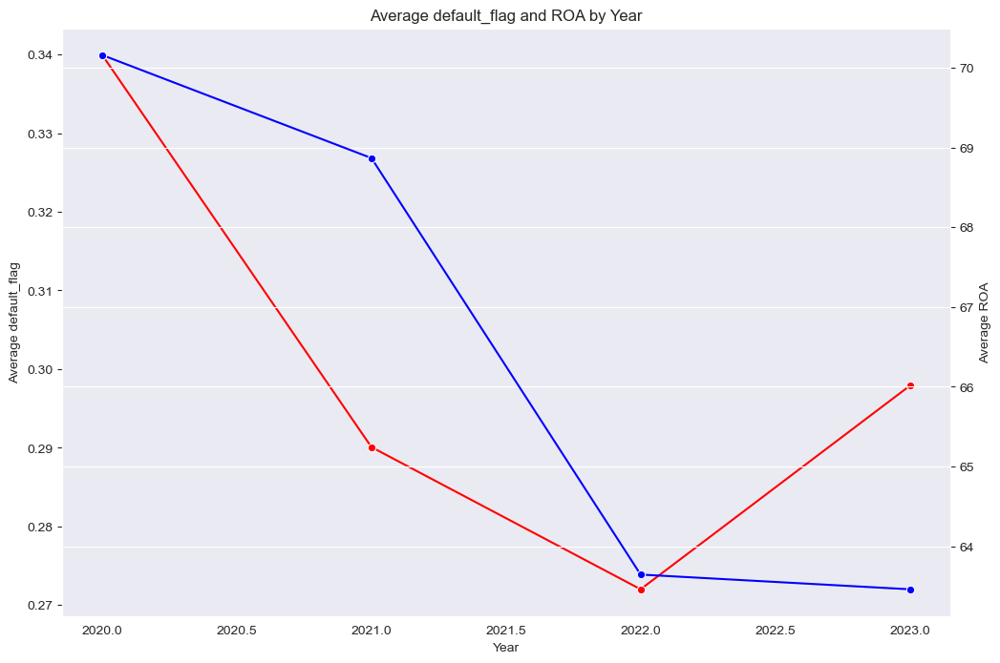

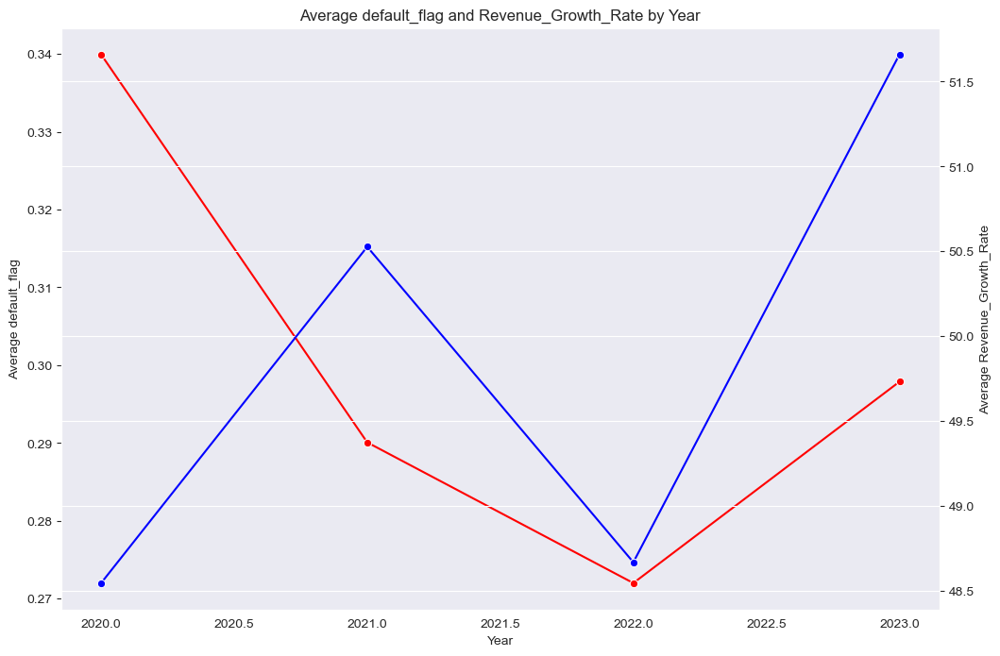

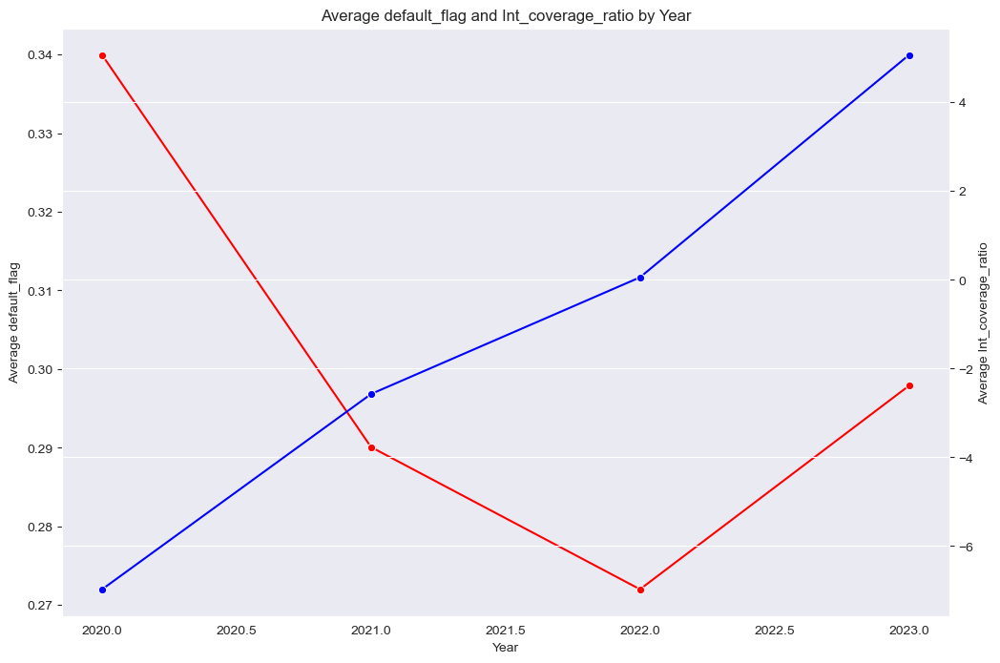

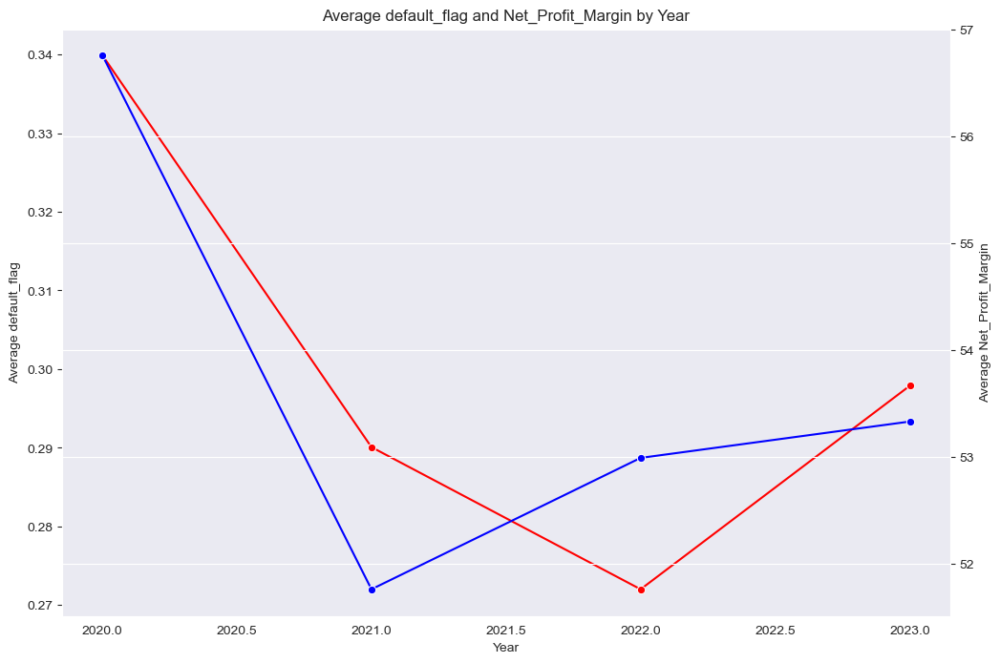

In [55]:
# To study the trends and patterns over a time frame which facilitates Grouping,Aggregation and Visualisation
# Now we shall plot each of the average numerical column values against the average default flag by year
#First we need to plot average default values by year
numerical_cols=[col for col in numerical_cols if col not in exclude_columns]
for col in numerical_cols:
    plt.figure(figsize=(12,8))
    avg_default_flag_year = df1.groupby('year')[target].mean()
    ax1 = sns.lineplot(x=avg_default_flag_year.index, y=avg_default_flag_year.values, marker='o', color='r')
    # Now we shall plot the average numerical value by year on the secondary axis
    # Average numerical variable by year on secondary axis
    ax2 = ax1.twinx()
    avg_numerical_var_year = df1.groupby('year')[col].mean()
    sns.lineplot(x=avg_numerical_var_year.index, y=avg_numerical_var_year.values, marker='o', color='b')

# set the titles and labels
    ax1.set_title(f'Average {target} and {col} by Year')
    ax1.set_xlabel('Year')
    ax1.set_ylabel(f'Average {target}')
    ax2.set_ylabel(f'Average {col}')
    ax1.grid(False)


C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


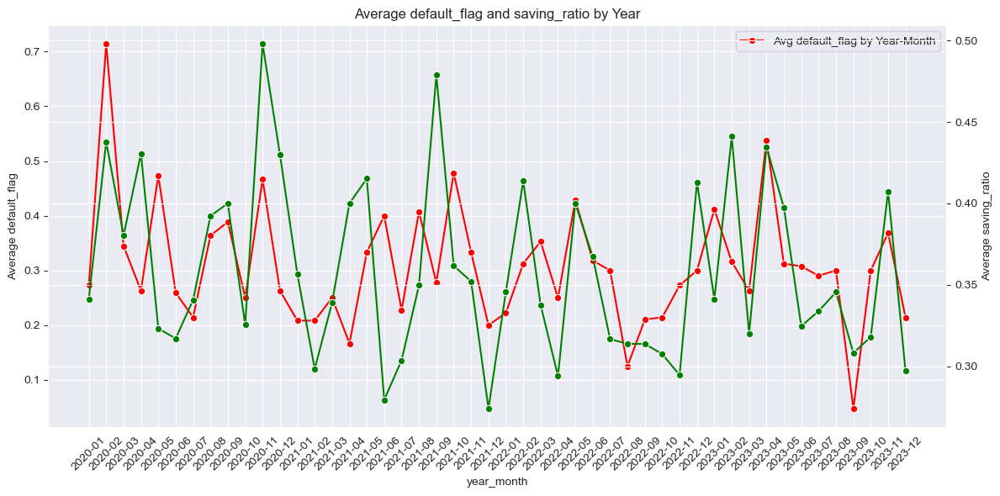

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


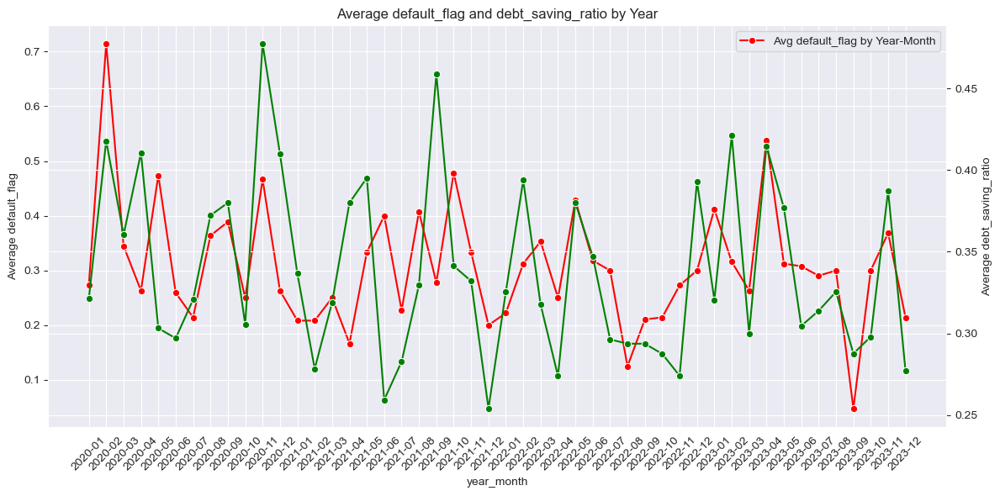

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


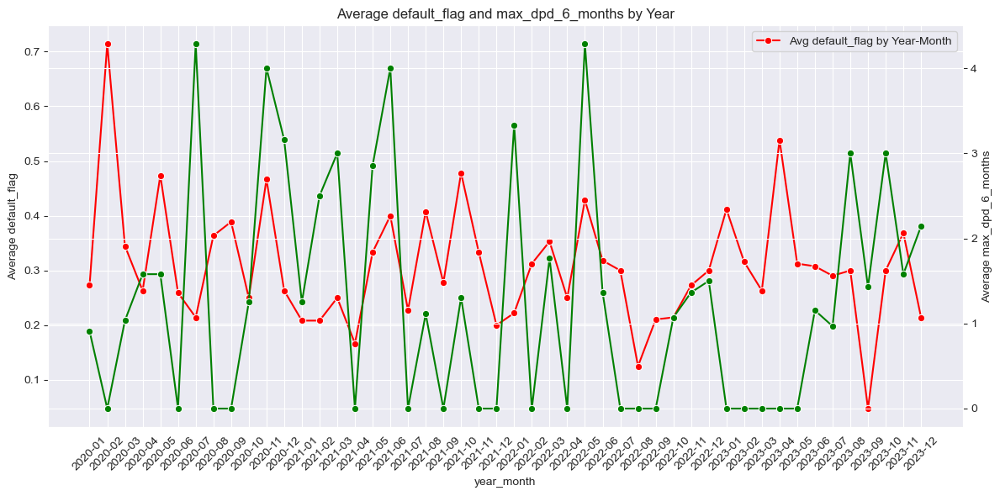

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


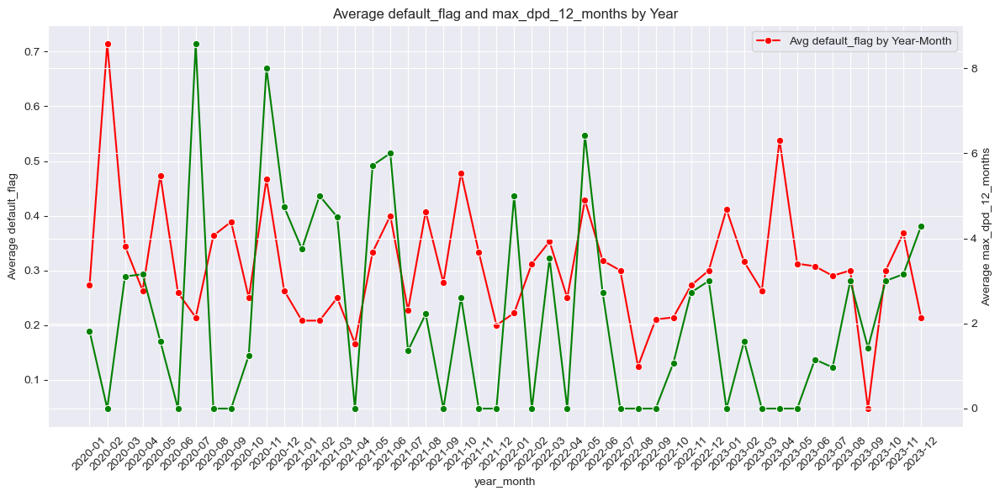

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


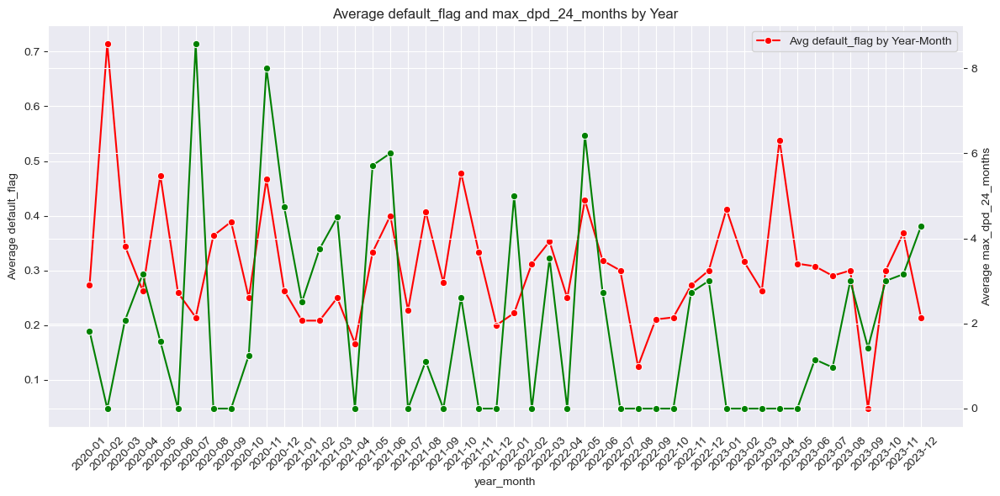

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


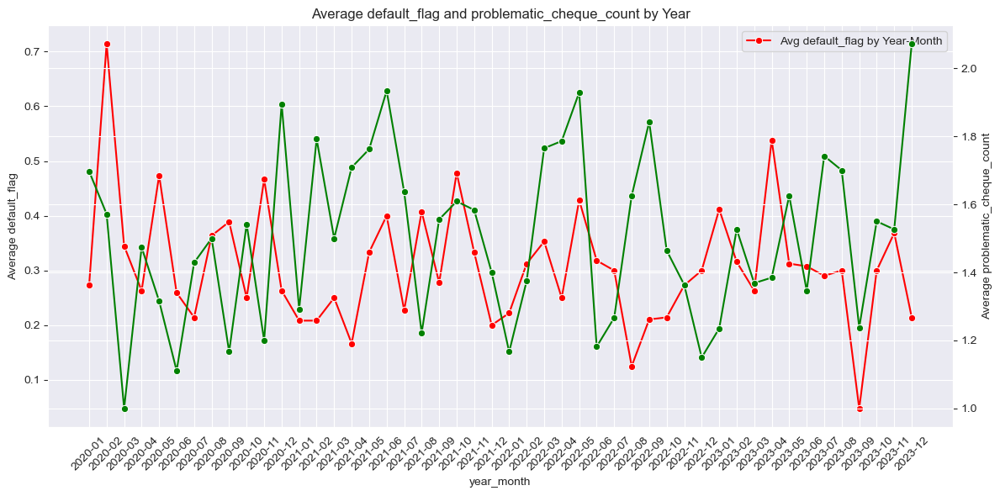

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


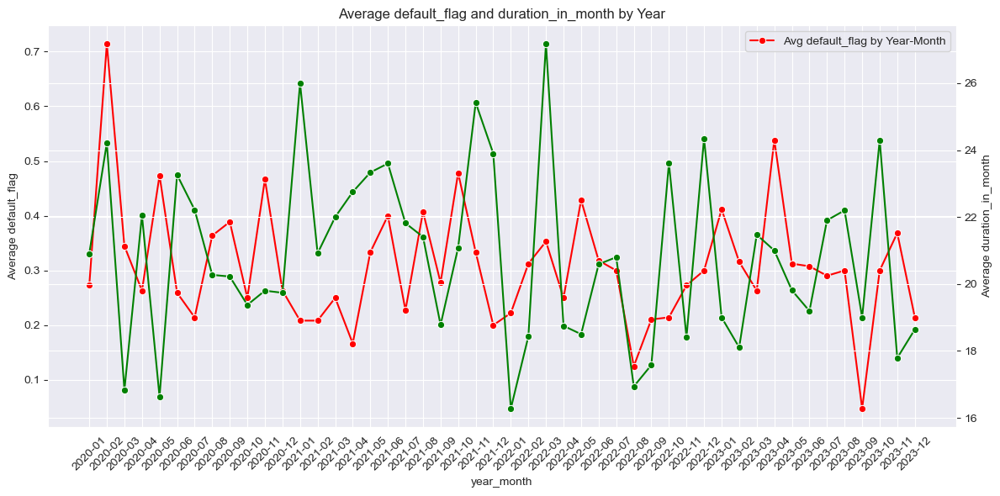

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


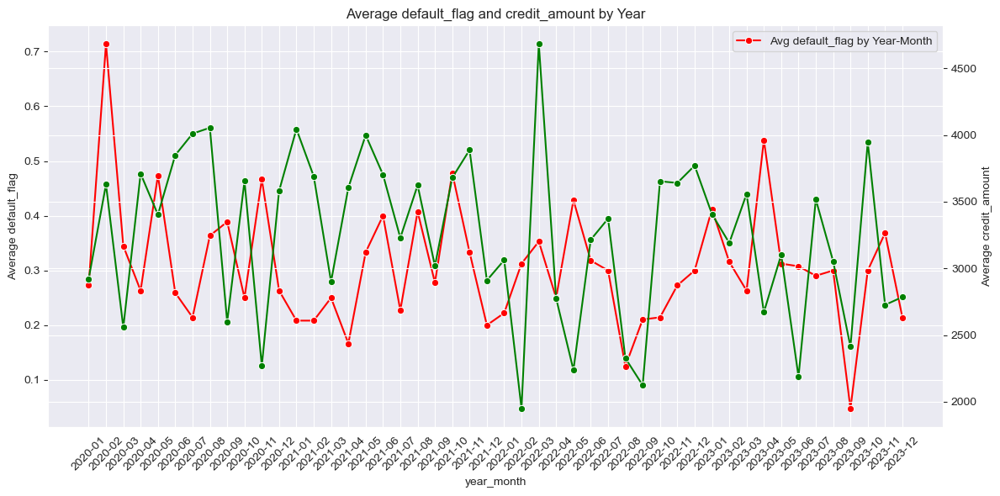

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


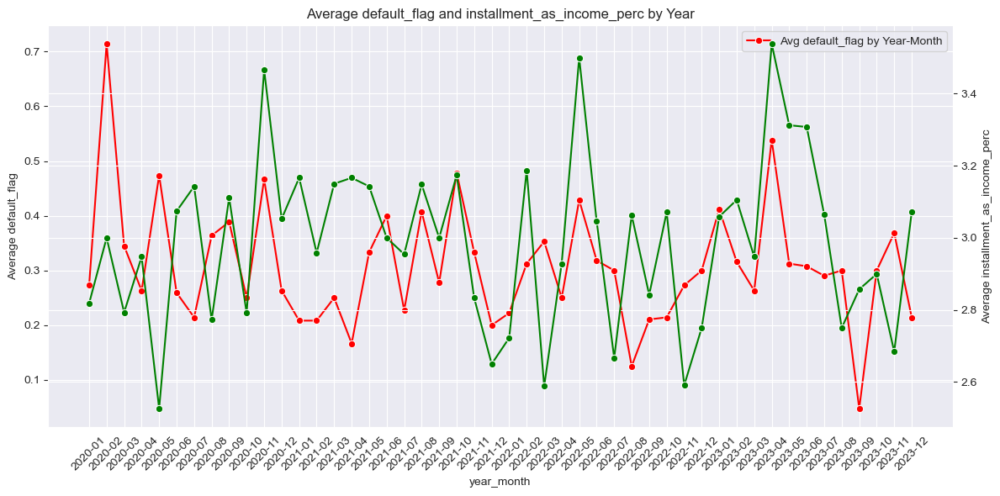

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


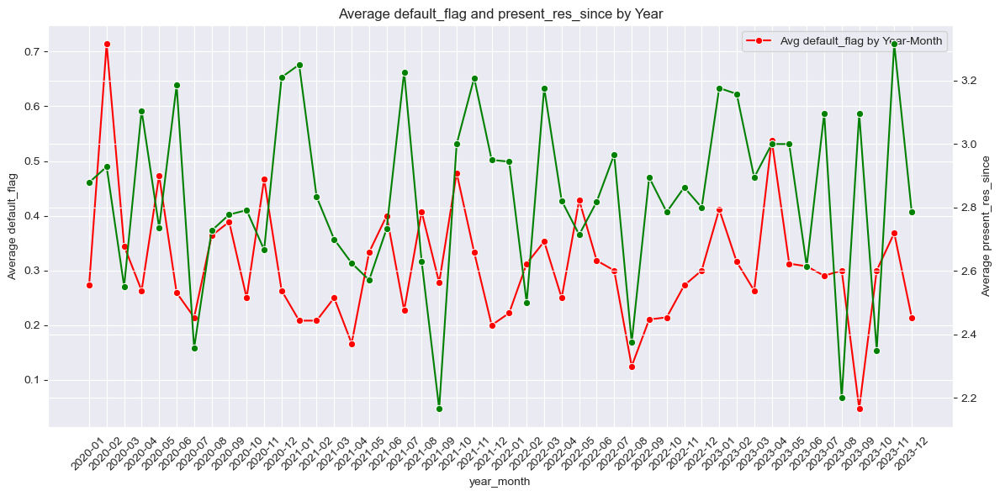

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


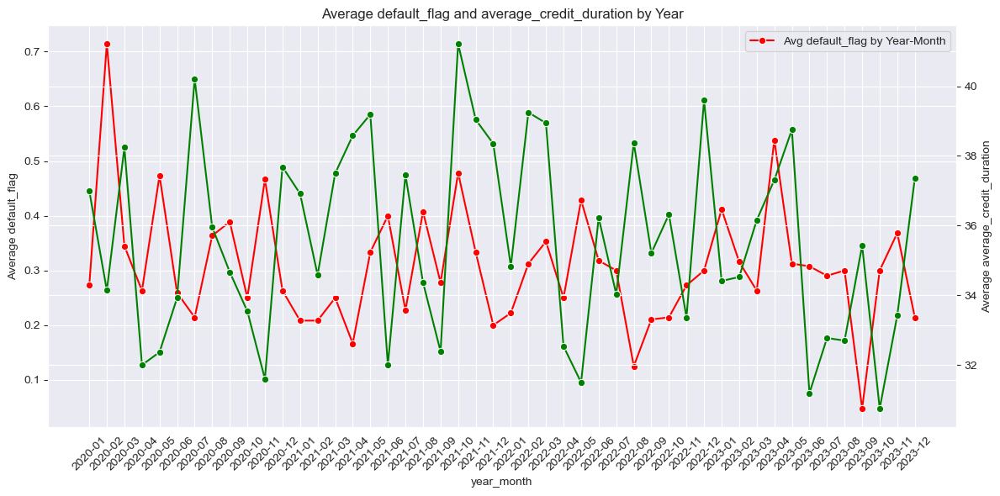

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


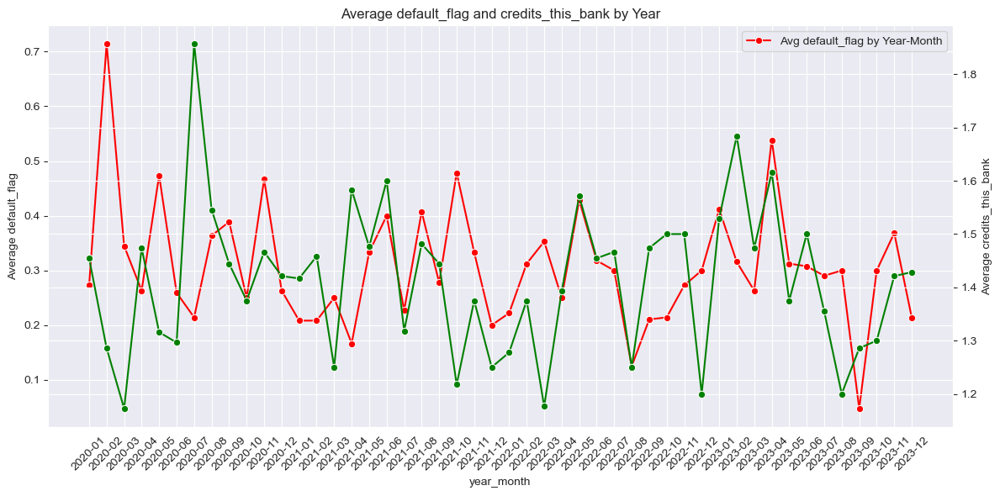

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


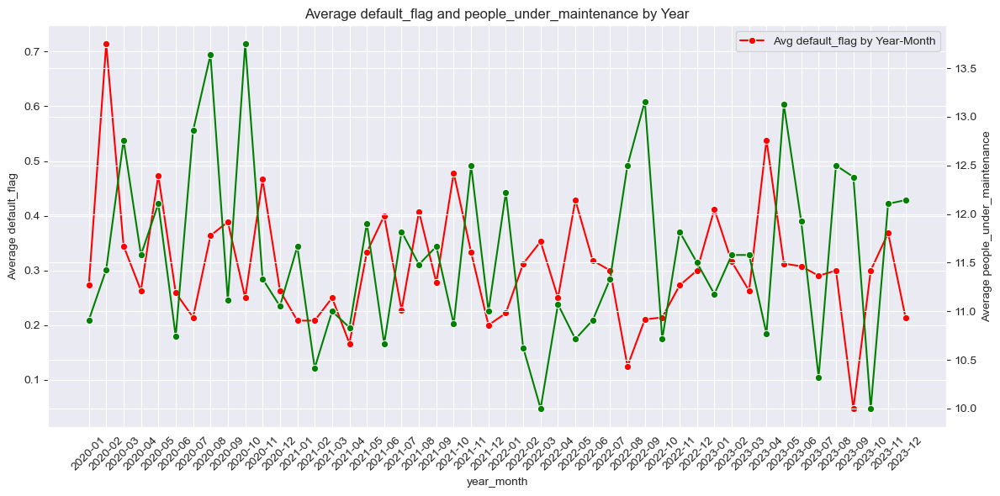

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


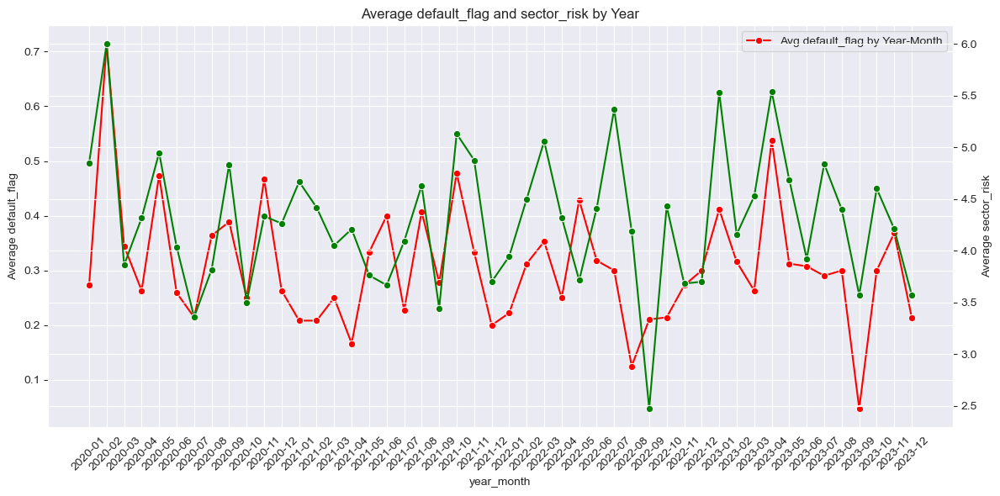

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


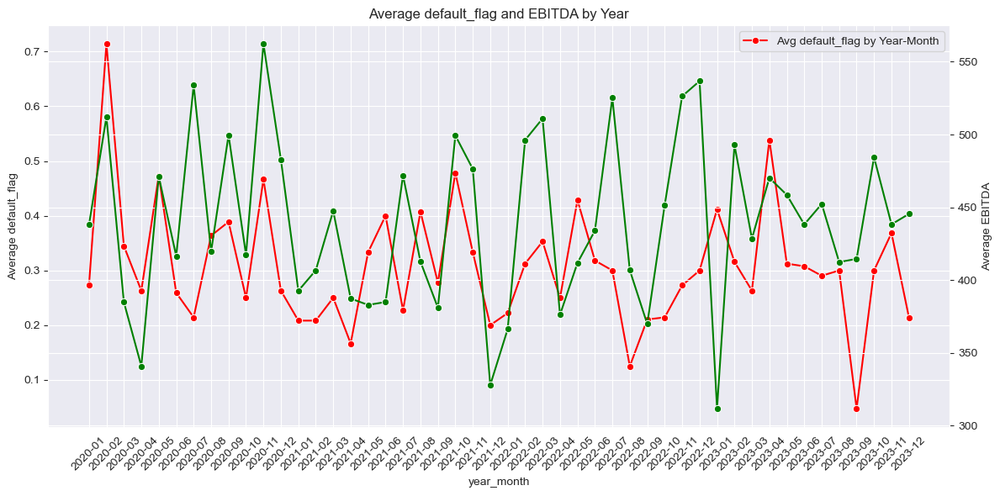

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


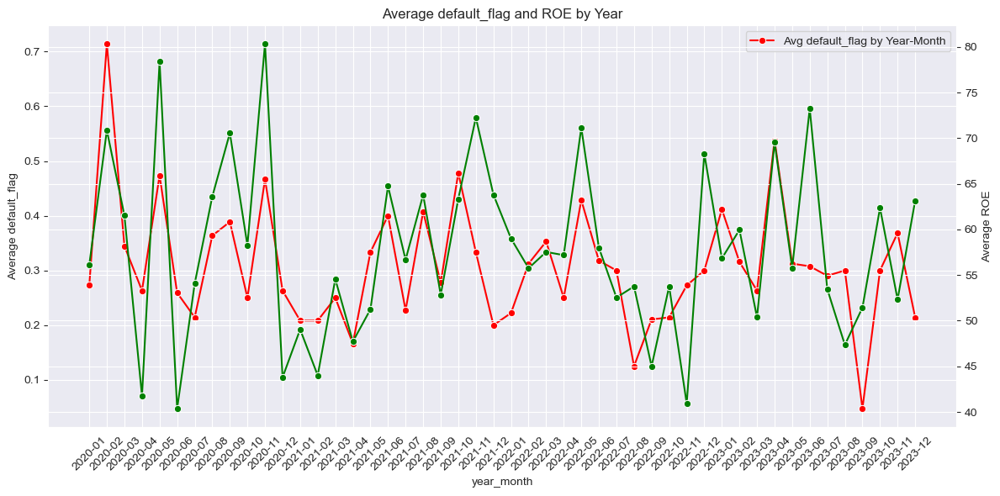

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


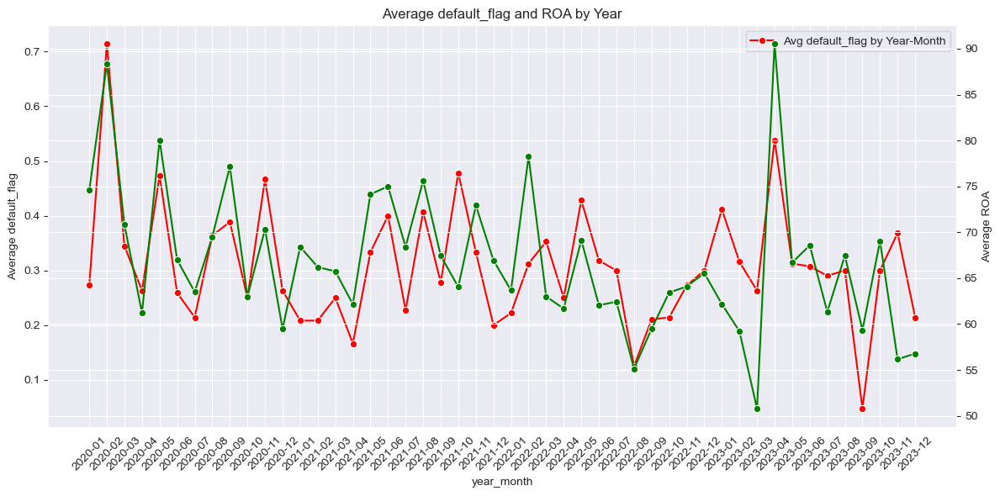

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


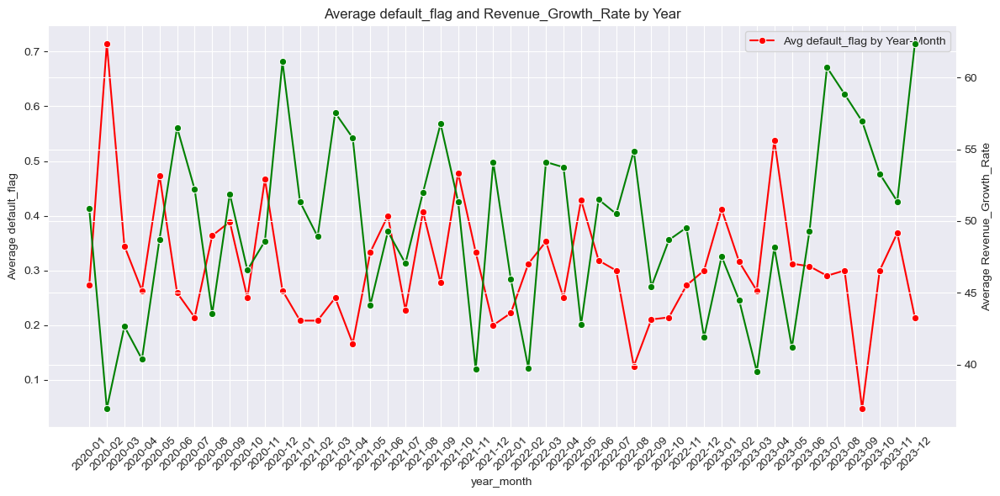

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


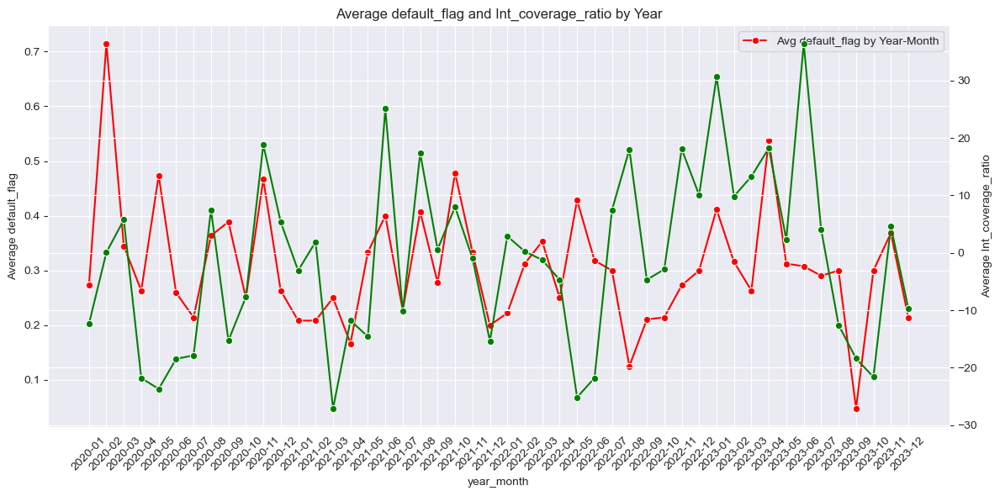

C:\Users\siddh\AppData\Local\Temp\ipykernel_12972\2428397243.py:17: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)


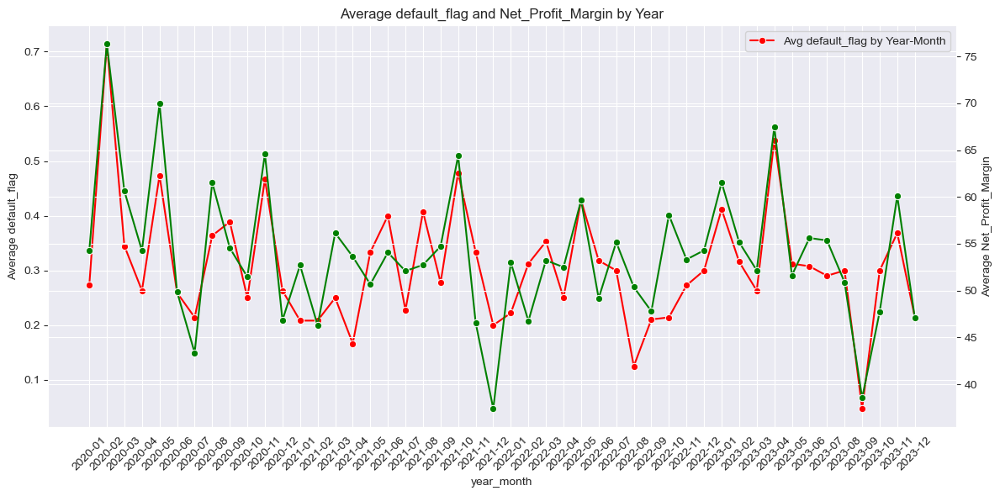

In [56]:
# Average default_flag by year-month
numerical_cols=[col for col in numerical_cols if col not in exclude_columns]
for col in numerical_cols:
    plt.figure(figsize=(12, 6))
    avg_default_flag_year_month = df1.groupby('year_month')[target].mean()
    ax1 = sns.lineplot(x=avg_default_flag_year_month.index.astype(str), y=avg_default_flag_year_month.values, marker='o', color='r', label=f'Avg {target} by Year-Month')
    # Now we shall plot the average numerical value by year on the secondary axis
    # Average numerical variable by year on secondary axis
    ax2 = ax1.twinx()
    avg_numerical_var_year_month = df1.groupby('year_month')[col].mean()
    sns.lineplot(x=avg_numerical_var_year_month.index.astype(str), y=avg_numerical_var_year_month.values, marker='o', color='g')
    

# set the titles and labels
    ax1.set_title(f'Average {target} and {col} by Year')
    ax1.set_xlabel('year_month')
    ax1.set_xticklabels(avg_numerical_var_year_month.index.astype(str), rotation=45)
    ax1.set_ylabel(f'Average {target}')
    ax2.set_ylabel(f'Average {col}')
    ax1.grid(True)
    plt.tight_layout()
    plt.show()


customer_segment:


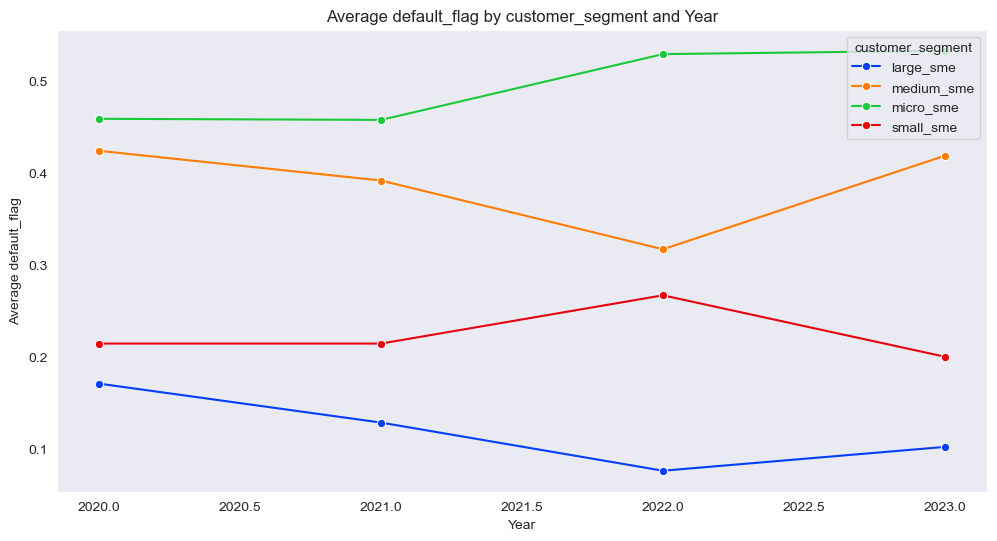


credit_history:


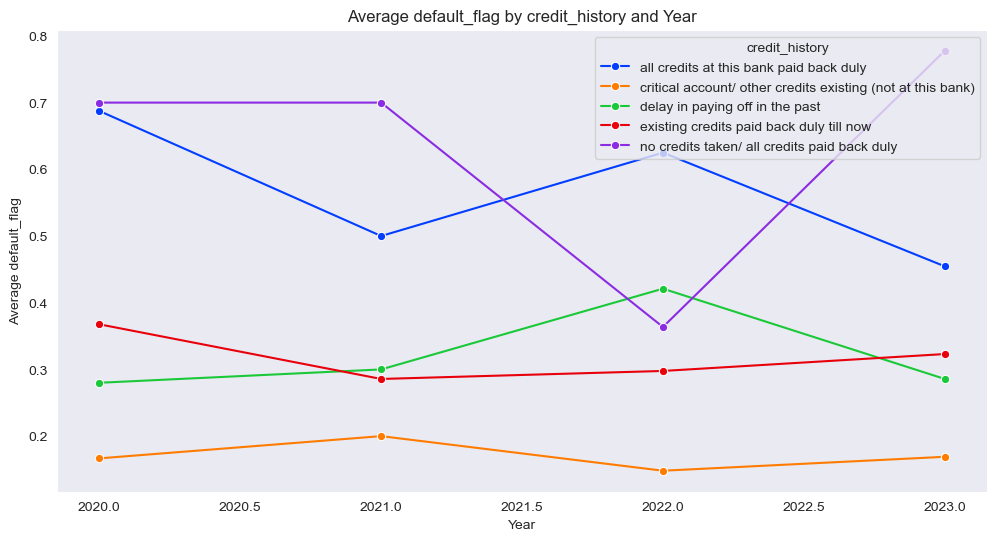


purpose:


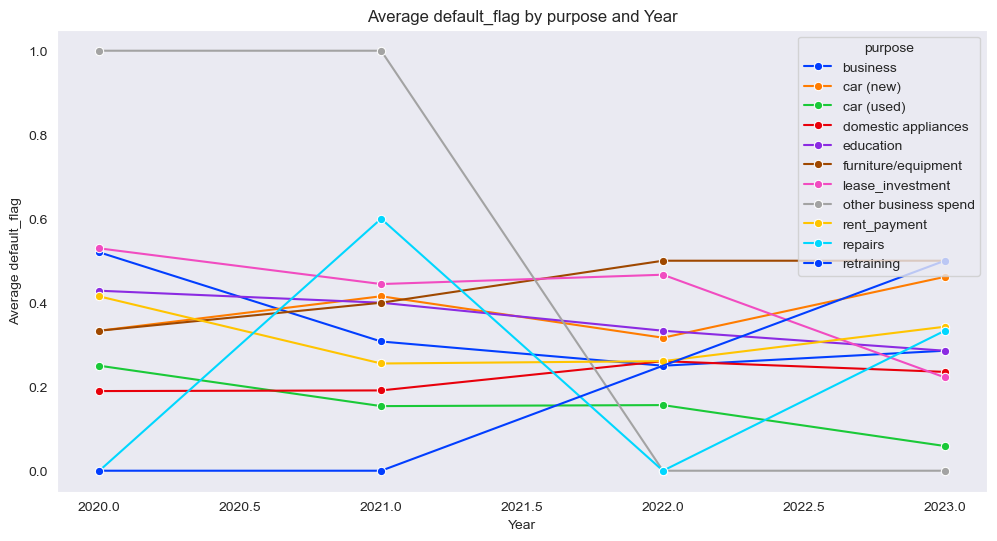


savings:


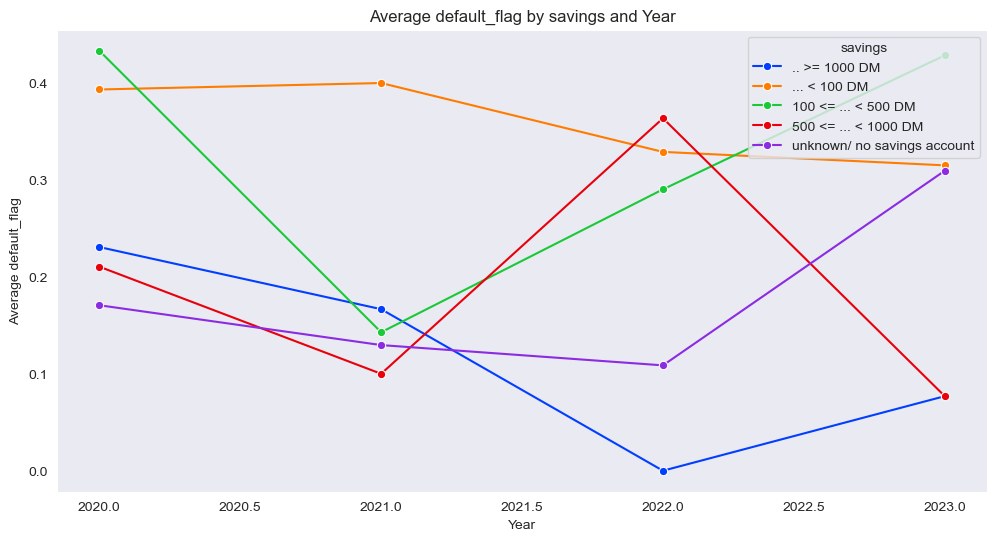


sme_history_begin:


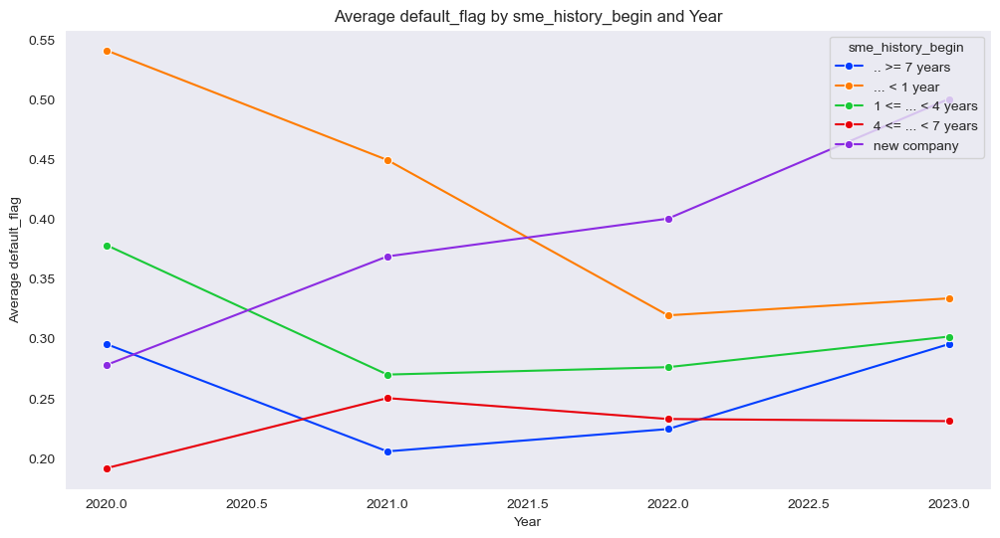


other_debtors:


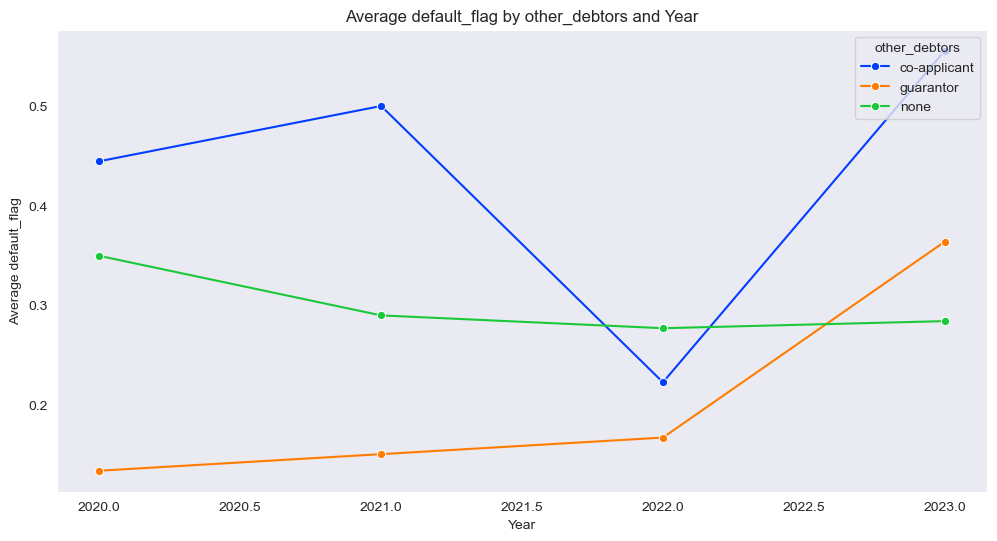


sector:


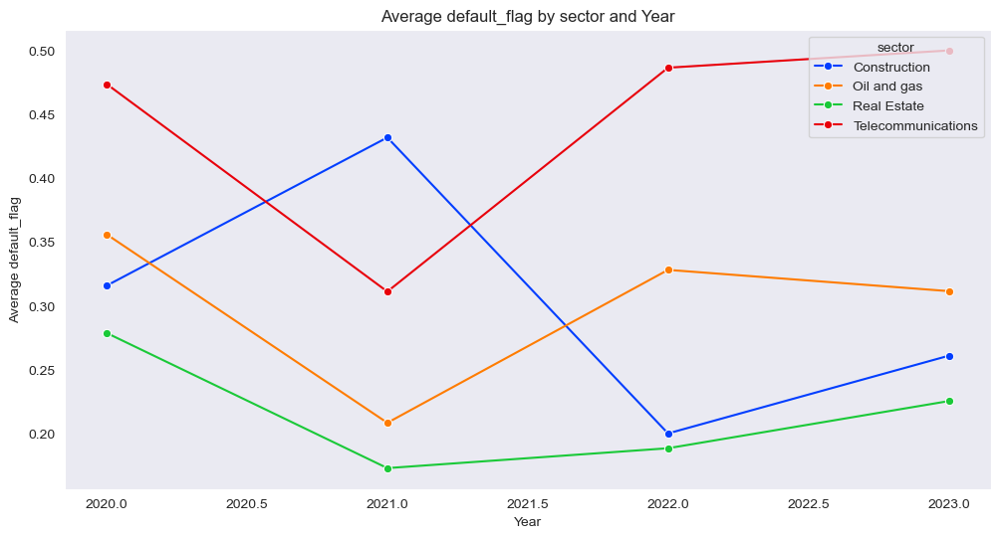


customer_profile:


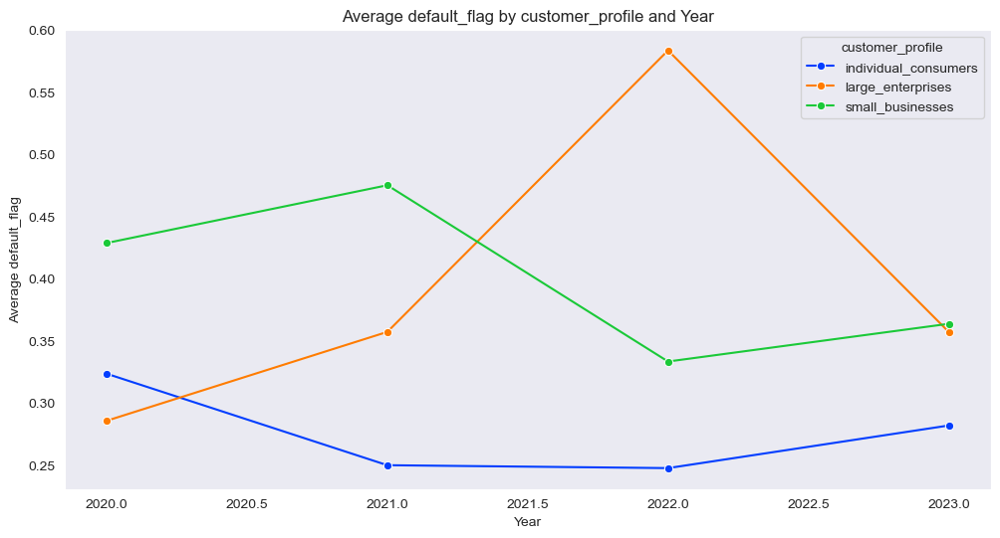


business_type:


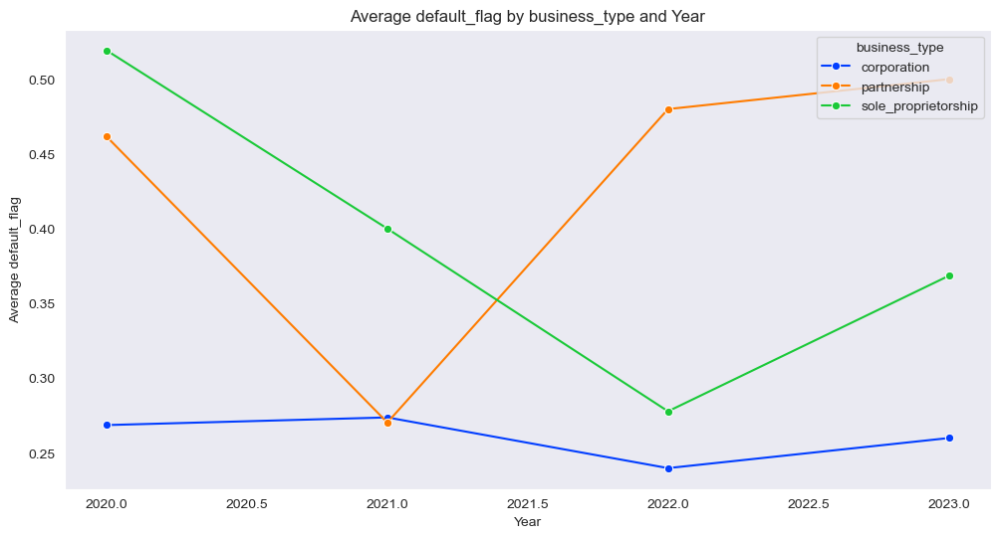


revenue_range:


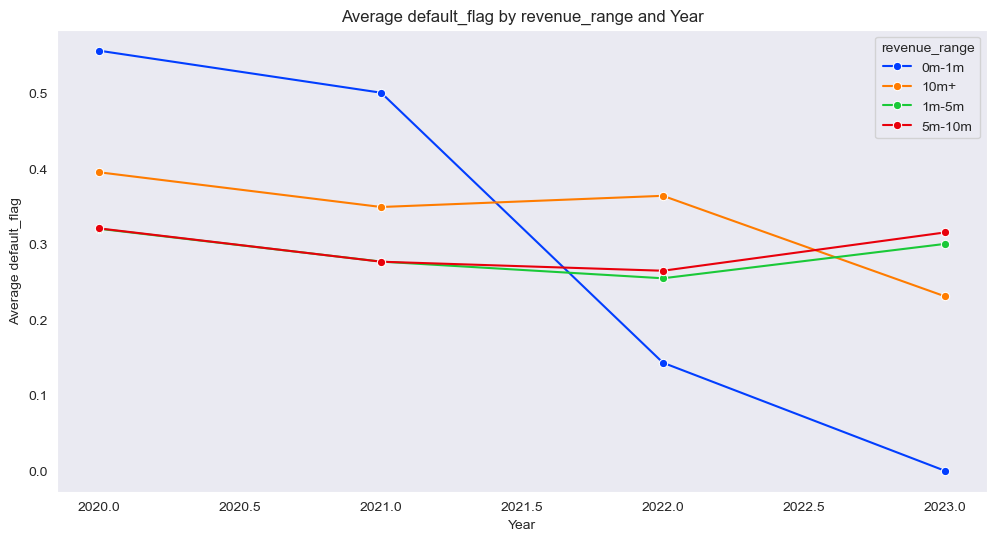


foreign_stakeholders:


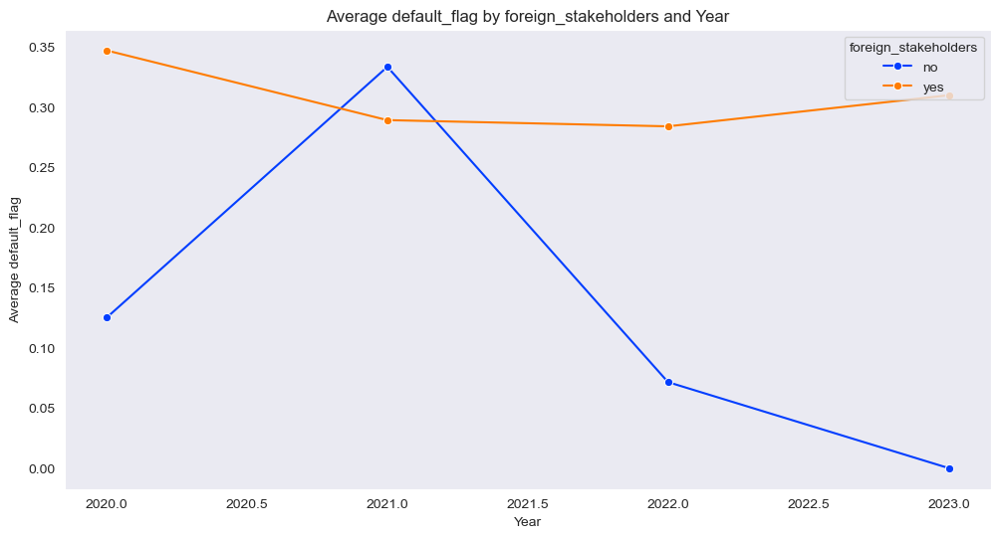

In [57]:
# Plotting average of the default  by feature groups over time.
for col in categorical_cols:
    if col not in exclude_columns:
        print(f"\n{col}:")
        plt.figure(figsize=(12, 6))

        # Average default_flag by category and year
        avg_default_flag_cat = df1.groupby([col, 'year'])[target].mean().reset_index()
        sns.lineplot(x='year', y=target, hue=col, data=avg_default_flag_cat, marker='o', palette='bright')
        plt.title(f'Average {target} by {col} and Year')
        plt.xlabel('Year')
        plt.ylabel(f'Average {target}')
        plt.legend(title=col, loc='upper right')
        plt.grid(False)
        plt.show()

We have had a complete overview of our dataset and there overall characteristics and there relationship with the target variable,correlation between the features,there impact on the average default rate individually and there pattern with time.We have treated the missing values and have also studied the distribution of the individual features,outliers and skewness.

Next we shall proceed with the treatment of outliers, Conversion of categorical data into binary(encoding),Normalisation & Scaling


# Data Tranformations

In [58]:
from sklearn.preprocessing import OneHotEncoder,FunctionTransformer
from category_encoders import WOEEncoder
from scipy.stats import boxcox

In [59]:
# Ensure that the date columns are there in the dataset
if 'date' in df1.columns:
        df1['year'] = df1['date'].dt.year
        df1['month'] = df1['date'].dt.month
        df1['year_month'] = df1['date'].dt.to_period('M')  # 'M' gives the year-month format       

## Apply outlier capping using the quantile 
We start transformations over numerical columns that need transformations.
Exclude those columns that have no outliers from transformations since they do not need any transformations
We shall create an empty list in order to capture the transformation steps in a report for clear documentation

<span style ="color: blue;font-size: 15px"> We shall first treat the numerical columns having outliers that may significantly impact model performance.
one of the methods fo cap the values in the numerical columns at a maximum value which is 0.99 of the range  of feature values.


In [60]:
transformation_report = []
exclude_columns = ['year', 'month', 'year_month', "Unnamed: 0"]
numerical_cols = df1.select_dtypes(include=np.number).columns.difference(exclude_columns)

# Define your quantile
quantile = 0.99 

# Apply outlier capping using the quantile
for col in numerical_cols:
    # Calculate the capping value for the *current* column inside the loop
    cap_value = df1[col].quantile(quantile)

    # Create a new column with a unique name for each transformation
    df1[f"{col}_capped_{quantile}"] = np.where(df1[col] > cap_value, cap_value, df1[col])

    # Append the report *inside* the loop so it runs for every column
    transformation_report.append(f"Capped outlier values in '{col}' column at {cap_value:.2f} (quantile={quantile}).")

# Now, transformation_report will contain an entry for every column
print(transformation_report)


["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).", "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).", "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).", "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).", "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).", "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).", "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).", "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).", "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).", "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).", "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).", "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).", "Capped outlier values in 'id' column at 990.01 (quantile=0.99

In [61]:
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,customer_segment,duration_in_month,credit_history,purpose,credit_amount,savings,sme_history_begin,installment_as_income_perc,other_debtors,present_res_since,sector,average_credit_duration,customer_profile,business_type,credits_this_bank,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin,year,month,year_month,EBITDA_capped_0.99,Int_coverage_ratio_capped_0.99,Net_Profit_Margin_capped_0.99,ROA_capped_0.99,ROE_capped_0.99,Revenue_Growth_Rate_capped_0.99,average_credit_duration_capped_0.99,credit_amount_capped_0.99,credits_this_bank_capped_0.99,debt_saving_ratio_capped_0.99,default_flag_capped_0.99,duration_in_month_capped_0.99,id_capped_0.99,installment_as_income_perc_capped_0.99,max_dpd_12_months_capped_0.99,max_dpd_24_months_capped_0.99,max_dpd_6_months_capped_0.99,people_under_maintenance_capped_0.99,present_res_since_capped_0.99,problematic_cheque_count_capped_0.99,saving_ratio_capped_0.99,sector_risk_capped_0.99
0,0,1,2020-12-09,0.24,0.22,0,0,0,0.0,2,micro_sme,6,critical account/ other credits existing (not ...,domestic appliances,1169,unknown/ no savings account,.. >= 7 years,4,none,4,Real Estate,67,individual_consumers,corporation,2,5m-10m,10,yes,2,360,60,100,27,75,90.0,2020,12,2020-12,360.0,75.0,90.0,100.0,60.0,27.0,67.0,1169.0,2.0,0.22,0.0,6.0,1.0,4.0,0.0,0.0,0.0,10.0,4.0,2.0,0.24,2.0
1,1,2,2021-08-07,0.28,0.26,1,0,30,0.0,0,medium_sme,48,existing credits paid back duly till now,domestic appliances,5951,... < 100 DM,1 <= ... < 4 years,2,none,2,Real Estate,22,individual_consumers,corporation,1,5m-10m,10,yes,7,350,52,141,18,-10,77.0,2021,8,2021-08,350.0,-10.0,77.0,141.0,52.0,18.0,22.0,5951.0,1.0,0.26,1.0,48.0,2.0,2.0,30.0,0.0,0.0,10.0,2.0,0.0,0.28,7.0
2,2,3,2023-02-26,0.42,0.40,0,0,30,0.0,1,large_sme,12,critical account/ other credits existing (not ...,lease_investment,2096,... < 100 DM,4 <= ... < 7 years,2,none,3,Real Estate,49,individual_consumers,corporation,1,1m-5m,20,yes,2,113,-7,59,2,-18,88.0,2023,2,2023-02,113.0,-18.0,88.0,59.0,-7.0,2.0,49.0,2096.0,1.0,0.40,0.0,12.0,3.0,2.0,30.0,0.0,0.0,20.0,3.0,1.0,0.42,2.0
3,3,4,2020-03-30,0.07,0.05,0,0,30,0.0,0,micro_sme,42,existing credits paid back duly till now,rent_payment,7882,... < 100 DM,4 <= ... < 7 years,2,guarantor,4,Oil and gas,45,individual_consumers,partnership,1,5m-10m,20,yes,1,659,89,0,49,57,-7.0,2020,3,2020-03,659.0,57.0,-7.0,0.0,89.0,49.0,45.0,7882.0,1.0,0.05,0.0,42.0,4.0,2.0,30.0,0.0,0.0,20.0,4.0,0.0,0.07,1.0
4,4,5,2021-07-24,0.13,0.10,1,0,30,0.0,3,micro_sme,24,delay in paying off in the past,car (new),4870,... < 100 DM,1 <= ... < 4 years,3,none,4,Telecommunications,53,individual_consumers,partnership,2,5m-10m,20,yes,8,117,50,51,24,60,71.0,2021,7,2021-07,117.0,60.0,71.0,51.0,50.0,24.0,53.0,4870.0,2.0,0.10,1.0,24.0,5.0,3.0,30.0,0.0,0.0,20.0,4.0,3.0,0.13,8.0


# Boxcox transformation for normalisation of the feature variables to satisfy the assumptions of the Logistic Regression Model
This statistical method used to transform non-normal data into a normal distribution to meet the assumptions of statistical models like linear regression. It is a flexible power transformation parameterized by a single value, lambda (lambda), that is chosen to make the data as normally distributed as possible, which can also help stabilize the variance and reduce skewness.This transformation requires all data points to be positive.

Why Use the Box-Cox Transformation?

Statistical models such as linear regression rely on certain assumptions:

* The data should be normally distributed
* Should have constant variance
* Show a linear relationship between variables and target

However, real-world data often violates these conditions, data is usually skewed, variance can increase with values, and relationships may be non-linear.

The Box-Cox transformation addresses these issues by reshaping data to be more normal, stabilizing variance, and making relationships between variables more linear. This improves the accuracy and reliability of statistical models.

Transformed Variable y^(λ)= (y^(λ)-1)/λ when λ!=0
                        
                        =ln(y) when λ=0
The choice of λ determines the transformation:range is (-2,2) where -2 is for reciprocal square,-1 for reciprocal and so on.

# The primary assumptions for the Box-Cox transformation are that the data must be strictly positive (greater than zero) and continuous.


Limitations:
============
It doesn't always achieve perfect normality, especially with very complex distributions.

It changes the scale and units of the original data, which can affect interpretability.

If the data contains zeros or negatives, the required shifting can complicate interpretation or introduce bias. 



In [62]:
# Applying boxcox transformation for numerical columns(continuous) with positive values that need transformation to a normal distribution
from scipy.stats import boxcox

numerical_cols = df1.select_dtypes(include=np.number).columns.tolist()
for col in numerical_cols:
    # Check if all values are positive AND if not all values are the same
    is_all_positive = (df1[col] > 0).all()
    is_not_constant = not (df1[col] == df1[col].iloc[0]).all() 

    if is_all_positive and is_not_constant:
        boxcox_result, _ = boxcox(df1[col])
        df1[f"boxcox_{col}"] = boxcox_result
        transformation_report.append(f"Applied Box-Cox transformation to '{col}' column.")


In [63]:
transformation_report

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

# The PowerTransformer 
It is a parametric technique used to make numerical data resemble a Gaussian distribution more closely, which is often required for many machine learning models that operate under the assumption of normal distribution. It is especially valuable in situations where data shows significant skewness or kurtosis(the size of tail in a normal distribution due to presence of low[platykurtic],high[leptokurtic],medium[mesokurtic] outliers),or Hetroscedasticity(unstable variance over the range of the feature value) which influences the standard error and impacts model performance. By stabilizing variance and reducing skewness, the PowerTransformer helps to reinforce the foundational statistical assumptions, thus enhancing the effectiveness of the model.

Along with the box-cox tranformer(which can deal with positive continuous variables),the power tranformers also support yeo-johnson transforms which can deal with positive or negative values which normalises the data distribution handling skewness,kurtosis and hetroscedasticity and helps improve model performance.

yeo-johnson also handles outliers without removing them by reducing the distance between extreme outliers and the central cluster of data.By chosing correct lambda, makes "heavy-tailed" data more symmetric and reduces the disproportionate influence of outliers on machine learning models along wioth preserving data.

In [64]:
from sklearn.preprocessing import PowerTransformer

# Initialize the Yeo-Johnson transformer
# standardize=True (default) helps further normalize the influence of outliers
pt = PowerTransformer(method='yeo-johnson', standardize=True)

for col in numerical_cols:
    # fit_transform automatically finds the optimal lambda for this specific column
    df1[f"yj_{col}"] = pt.fit_transform(df1[[col]])
    
    # access the optimal lambda found for the column if needed
    opt_lambda = pt.lambdas_[0]
    transformation_report.append(f"Applied Yeo-Johnson (opt_lambda={opt_lambda:.2f}) to {col}")

In [65]:
transformation_report

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

In [66]:
# If there are nan values we would fill nan values by using np.nanmean
fill_value = df1[col].mean
df1[col]=df1.fillna(fill_value,inplace = True)
transformation_report.append(f"Filled nan values with mean in {col} column after transformation")

In [67]:
transformation_report

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

# One-hot Encoding

It converts categorical features into a binary matrix, where each unique category becomes a new column containing 0s and 1s.
It is similar to the get_dummies() function in pandas 
The input to this transformer should be an array-like of integers or strings, denoting the values taken on by categorical (discrete) features. The features are encoded using a one-hot (aka ‘one-of-K’ or ‘dummy’) encoding scheme. This creates a binary column for each category and returns a sparse matrix or dense array (depending on the sparse_output parameter).

In [68]:

# Apply the transformation steps on categgorical columns
from sklearn.preprocessing import OneHotEncoder
categorical_cols = df1.select_dtypes(include='object').columns.difference(exclude_columns)
for col in categorical_cols:
    encoder = OneHotEncoder(drop='first') # Used to avoid the "dummy variable trap" (multicollinearity) by dropping one category per feature. Common options include 'first' or 'if_binary'
    encoded_array = encoder.fit_transform(df1[[col]]).toarray()
    encoded_cols = pd.DataFrame(encoded_array, columns=[f"{col}_{cat}" for cat in encoder.categories_[0][1:]], index=df1.index)
    df1 = pd.concat([df1, encoded_cols], axis=1)
    transformation_report.append(f"Applied One-Hot Encoding to '{col}' column.")

In [69]:
transformation_report

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

In [70]:
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,customer_segment,duration_in_month,credit_history,purpose,credit_amount,savings,sme_history_begin,installment_as_income_perc,other_debtors,present_res_since,sector,average_credit_duration,customer_profile,business_type,credits_this_bank,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin,year,month,year_month,EBITDA_capped_0.99,Int_coverage_ratio_capped_0.99,Net_Profit_Margin_capped_0.99,ROA_capped_0.99,ROE_capped_0.99,Revenue_Growth_Rate_capped_0.99,average_credit_duration_capped_0.99,credit_amount_capped_0.99,credits_this_bank_capped_0.99,debt_saving_ratio_capped_0.99,default_flag_capped_0.99,duration_in_month_capped_0.99,id_capped_0.99,installment_as_income_perc_capped_0.99,max_dpd_12_months_capped_0.99,max_dpd_24_months_capped_0.99,max_dpd_6_months_capped_0.99,people_under_maintenance_capped_0.99,present_res_since_capped_0.99,problematic_cheque_count_capped_0.99,saving_ratio_capped_0.99,sector_risk_capped_0.99,boxcox_id,boxcox_saving_ratio,boxcox_duration_in_month,boxcox_credit_amount,boxcox_installment_as_income_perc,boxcox_present_res_since,boxcox_average_credit_duration,boxcox_credits_this_bank,boxcox_people_under_maintenance,boxcox_EBITDA,boxcox_year,boxcox_month,boxcox_EBITDA_capped_0.99,boxcox_average_credit_duration_capped_0.99,boxcox_credit_amount_capped_0.99,boxcox_credits_this_bank_capped_0.99,boxcox_duration_in_month_capped_0.99,boxcox_id_capped_0.99,boxcox_installment_as_income_perc_capped_0.99,boxcox_people_under_maintenance_capped_0.99,boxcox_present_res_since_capped_0.99,boxcox_saving_ratio_capped_0.99,yj_Unnamed: 0,yj_id,yj_saving_ratio,yj_debt_saving_ratio,yj_default_flag,yj_max_dpd_6_months,yj_max_dpd_12_months,yj_max_dpd_24_months,yj_problematic_cheque_count,yj_duration_in_month,yj_credit_amount,yj_installment_as_income_perc,yj_present_res_since,yj_average_credit_duration,yj_credits_this_bank,yj_people_under_maintenance,yj_sector_risk,yj_EBITDA,yj_ROE,yj_ROA,yj_Revenue_Growth_Rate,yj_Int_coverage_ratio,yj_Net_Profit_Margin,yj_year,yj_month,yj_EBITDA_capped_0.99,yj_Int_coverage_ratio_capped_0.99,yj_Net_Profit_Margin_capped_0.99,yj_ROA_capped_0.99,yj_ROE_capped_0.99,yj_Revenue_Growth_Rate_capped_0.99,yj_average_credit_duration_capped_0.99,yj_credit_amount_capped_0.99,yj_credits_this_bank_capped_0.99,yj_debt_saving_ratio_capped_0.99,yj_default_flag_capped_0.99,yj_duration_in_month_capped_0.99,yj_id_capped_0.99,yj_installment_as_income_perc_capped_0.99,yj_max_dpd_12_months_capped_0.99,yj_max_dpd_24_months_capped_0.99,yj_max_dpd_6_months_capped_0.99,yj_people_under_maintenance_capped_0.99,yj_present_res_since_capped_0.99,yj_problematic_cheque_count_capped_0.99,yj_saving_ratio_capped_0.99,yj_sector_risk_capped_0.99,business_type_partnership,business_type_sole_proprietorship,credit_history_critical account/ other credits existing (not at this bank),credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,credit_history_no credits taken/ all credits paid back duly,customer_profile_large_enterprises,customer_profile_small_businesses,customer_segment_medium_sme,customer_segment_micro_sme,customer_segment_small_sme,foreign_stakeholders_yes,other_debtors_guarantor,other_debtors_none,purpose_car (new),purpose_car (used),purpose_domestic appliances,purpose_education,purpose_furniture/equipment,purpose_lease_investment,purpose_other business spend,purpose_rent_payment,purpose_repairs,purpose_retraining,revenue_range_10m+,revenue_range_1m-5m,revenue_range_5m-10m,savings_... < 100 DM,savings_100 <= ... < 500 DM,savings_500 <= ... < 1000 DM,savings_unknown/ no savings account,sector_Oil and gas,sector_Real Estate,sector_Telecommunications,sme_history_begin_... < 1 year,sme_history_begin_1 <= ... < 4 years,sme_history_begin_4 <= ... < 7 years,sme_h

### Mean encoding, also known as target encoding, is a technique used in machine learning to convert categorical features into numerical values by replacing each category with the average value of the target variable for that specific category

Regression: Replaces the category with the average target value.Binary

Classification: Replaces the category with the probability (mean) of the positive class 

Key Advantages
==============
High Cardinality: Efficiently handles features with hundreds or thousands of unique categories (like ZIP codes) without increasing dataset dimensionality, unlike One-Hot Encoding.

Predictive Power: Captures a direct relationship between the feature and the target, often leading to better performance in tree-based models like XGBoost or LightGBM.

Monotonicity: Creates a monotonic relationship with the target, which can simplify the learning process for certain algorithms.

The primary drawback of mean encoding is overfitting (target leakage), especially for categories with very few samples. To prevent this, data scientists use:

Smoothing: Blends the category mean with the global average of the entire dataset. Small categories are pulled toward the global mean to reduce noise.

K-Fold Encoding: Divides the training data into folds and calculates the encoding for one fold using only the target values from the other folds.

Leave-One-Out Encoding: Calculates the mean for a specific row by excluding that row's own target value

In [71]:
# Mean encoding using specified target variable
categorical_cols = df1.select_dtypes(include='object').columns.difference(exclude_columns)
for col in categorical_cols:
    mean_encoder = df1.groupby(col)[target].mean().to_dict()
    df1[f"{col}_mean_encoded"] = df1[col].map(mean_encoder)
    transformation_report.append(f"Applied Mean Encoding to '{col}' column using '{target}' as target variable.")

In [72]:
transformation_report

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

In [73]:
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,customer_segment,duration_in_month,credit_history,purpose,credit_amount,savings,sme_history_begin,installment_as_income_perc,other_debtors,present_res_since,sector,average_credit_duration,customer_profile,business_type,credits_this_bank,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin,year,month,year_month,EBITDA_capped_0.99,Int_coverage_ratio_capped_0.99,Net_Profit_Margin_capped_0.99,ROA_capped_0.99,ROE_capped_0.99,Revenue_Growth_Rate_capped_0.99,average_credit_duration_capped_0.99,credit_amount_capped_0.99,credits_this_bank_capped_0.99,debt_saving_ratio_capped_0.99,default_flag_capped_0.99,duration_in_month_capped_0.99,id_capped_0.99,installment_as_income_perc_capped_0.99,max_dpd_12_months_capped_0.99,max_dpd_24_months_capped_0.99,max_dpd_6_months_capped_0.99,people_under_maintenance_capped_0.99,present_res_since_capped_0.99,problematic_cheque_count_capped_0.99,saving_ratio_capped_0.99,sector_risk_capped_0.99,boxcox_id,boxcox_saving_ratio,boxcox_duration_in_month,boxcox_credit_amount,boxcox_installment_as_income_perc,boxcox_present_res_since,boxcox_average_credit_duration,boxcox_credits_this_bank,boxcox_people_under_maintenance,boxcox_EBITDA,boxcox_year,boxcox_month,boxcox_EBITDA_capped_0.99,boxcox_average_credit_duration_capped_0.99,boxcox_credit_amount_capped_0.99,boxcox_credits_this_bank_capped_0.99,boxcox_duration_in_month_capped_0.99,boxcox_id_capped_0.99,boxcox_installment_as_income_perc_capped_0.99,boxcox_people_under_maintenance_capped_0.99,boxcox_present_res_since_capped_0.99,boxcox_saving_ratio_capped_0.99,yj_Unnamed: 0,yj_id,yj_saving_ratio,yj_debt_saving_ratio,yj_default_flag,yj_max_dpd_6_months,yj_max_dpd_12_months,yj_max_dpd_24_months,yj_problematic_cheque_count,yj_duration_in_month,yj_credit_amount,yj_installment_as_income_perc,yj_present_res_since,yj_average_credit_duration,yj_credits_this_bank,yj_people_under_maintenance,yj_sector_risk,yj_EBITDA,yj_ROE,yj_ROA,yj_Revenue_Growth_Rate,yj_Int_coverage_ratio,yj_Net_Profit_Margin,yj_year,yj_month,yj_EBITDA_capped_0.99,yj_Int_coverage_ratio_capped_0.99,yj_Net_Profit_Margin_capped_0.99,yj_ROA_capped_0.99,yj_ROE_capped_0.99,yj_Revenue_Growth_Rate_capped_0.99,yj_average_credit_duration_capped_0.99,yj_credit_amount_capped_0.99,yj_credits_this_bank_capped_0.99,yj_debt_saving_ratio_capped_0.99,yj_default_flag_capped_0.99,yj_duration_in_month_capped_0.99,yj_id_capped_0.99,yj_installment_as_income_perc_capped_0.99,yj_max_dpd_12_months_capped_0.99,yj_max_dpd_24_months_capped_0.99,yj_max_dpd_6_months_capped_0.99,yj_people_under_maintenance_capped_0.99,yj_present_res_since_capped_0.99,yj_problematic_cheque_count_capped_0.99,yj_saving_ratio_capped_0.99,yj_sector_risk_capped_0.99,business_type_partnership,business_type_sole_proprietorship,credit_history_critical account/ other credits existing (not at this bank),credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,credit_history_no credits taken/ all credits paid back duly,customer_profile_large_enterprises,customer_profile_small_businesses,customer_segment_medium_sme,customer_segment_micro_sme,customer_segment_small_sme,foreign_stakeholders_yes,other_debtors_guarantor,other_debtors_none,purpose_car (new),purpose_car (used),purpose_domestic appliances,purpose_education,purpose_furniture/equipment,purpose_lease_investment,purpose_other business spend,purpose_rent_payment,purpose_repairs,purpose_retraining,revenue_range_10m+,revenue_range_1m-5m,revenue_range_5m-10m,savings_... < 100 DM,savings_100 <= ... < 500 DM,savings_500 <= ... < 1000 DM,savings_unknown/ no savings account,sector_Oil and gas,sector_Real Estate,sector_Telecommunications,sme_history_begin_... < 1 year,sme_history_begin_1 <= ... < 4 years,sme_history_begin_4 <= ... < 7 years,sme_h

# Weight of Evidence is a supervised transformer that maps categorical levels to a numerical value based on their relationship with a binary target variable
The encoder calculates the "strength" of a category in separating the "good" (positive) from the "bad" (negative) class.

Formula WOE = ln(% +ve(good) cases in a category/% -ve(Bad) cases in the category).
A positive WoE indicates the category is more likely to be associated with the positive target, while a negative WoE suggests a stronger link to the negative target.It can be adjusted using key parameters like regularization,handle_unknown,randomized etc )

Advantages:-
Logistic Regression: It is highly effective for logistic regression because it transforms features into the same logit scale used by the model.

Imbalanced Data: It can effectively capture the predictive power of minority classes even when data is imbalanced.

Dimensionality: Unlike One-Hot Encoding, it replaces a categorical column with a single numeric column, preventing feature explosion in high-cardinality data

In [74]:
# WOE encoding using specified target variable
from category_encoders import WOEEncoder
categorical_cols = df1.select_dtypes(include='object').columns.difference(exclude_columns)
for col in categorical_cols:
    woe_encoder = WOEEncoder()
    df1[f"{col}_woe_encoded"] = woe_encoder.fit_transform(df1[col], df1[target])
    transformation_report.append(f"Applied WOE Encoding to '{col}' column using '{target}' as target variable.")

In [75]:
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,customer_segment,duration_in_month,credit_history,purpose,credit_amount,savings,sme_history_begin,installment_as_income_perc,other_debtors,present_res_since,sector,average_credit_duration,customer_profile,business_type,credits_this_bank,revenue_range,people_under_maintenance,foreign_stakeholders,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin,year,month,year_month,EBITDA_capped_0.99,Int_coverage_ratio_capped_0.99,Net_Profit_Margin_capped_0.99,ROA_capped_0.99,ROE_capped_0.99,Revenue_Growth_Rate_capped_0.99,average_credit_duration_capped_0.99,credit_amount_capped_0.99,credits_this_bank_capped_0.99,debt_saving_ratio_capped_0.99,default_flag_capped_0.99,duration_in_month_capped_0.99,id_capped_0.99,installment_as_income_perc_capped_0.99,max_dpd_12_months_capped_0.99,max_dpd_24_months_capped_0.99,max_dpd_6_months_capped_0.99,people_under_maintenance_capped_0.99,present_res_since_capped_0.99,problematic_cheque_count_capped_0.99,saving_ratio_capped_0.99,sector_risk_capped_0.99,boxcox_id,boxcox_saving_ratio,boxcox_duration_in_month,boxcox_credit_amount,boxcox_installment_as_income_perc,boxcox_present_res_since,boxcox_average_credit_duration,boxcox_credits_this_bank,boxcox_people_under_maintenance,boxcox_EBITDA,boxcox_year,boxcox_month,boxcox_EBITDA_capped_0.99,boxcox_average_credit_duration_capped_0.99,boxcox_credit_amount_capped_0.99,boxcox_credits_this_bank_capped_0.99,boxcox_duration_in_month_capped_0.99,boxcox_id_capped_0.99,boxcox_installment_as_income_perc_capped_0.99,boxcox_people_under_maintenance_capped_0.99,boxcox_present_res_since_capped_0.99,boxcox_saving_ratio_capped_0.99,yj_Unnamed: 0,yj_id,yj_saving_ratio,yj_debt_saving_ratio,yj_default_flag,yj_max_dpd_6_months,yj_max_dpd_12_months,yj_max_dpd_24_months,yj_problematic_cheque_count,yj_duration_in_month,yj_credit_amount,yj_installment_as_income_perc,yj_present_res_since,yj_average_credit_duration,yj_credits_this_bank,yj_people_under_maintenance,yj_sector_risk,yj_EBITDA,yj_ROE,yj_ROA,yj_Revenue_Growth_Rate,yj_Int_coverage_ratio,yj_Net_Profit_Margin,yj_year,yj_month,yj_EBITDA_capped_0.99,yj_Int_coverage_ratio_capped_0.99,yj_Net_Profit_Margin_capped_0.99,yj_ROA_capped_0.99,yj_ROE_capped_0.99,yj_Revenue_Growth_Rate_capped_0.99,yj_average_credit_duration_capped_0.99,yj_credit_amount_capped_0.99,yj_credits_this_bank_capped_0.99,yj_debt_saving_ratio_capped_0.99,yj_default_flag_capped_0.99,yj_duration_in_month_capped_0.99,yj_id_capped_0.99,yj_installment_as_income_perc_capped_0.99,yj_max_dpd_12_months_capped_0.99,yj_max_dpd_24_months_capped_0.99,yj_max_dpd_6_months_capped_0.99,yj_people_under_maintenance_capped_0.99,yj_present_res_since_capped_0.99,yj_problematic_cheque_count_capped_0.99,yj_saving_ratio_capped_0.99,yj_sector_risk_capped_0.99,business_type_partnership,business_type_sole_proprietorship,credit_history_critical account/ other credits existing (not at this bank),credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,credit_history_no credits taken/ all credits paid back duly,customer_profile_large_enterprises,customer_profile_small_businesses,customer_segment_medium_sme,customer_segment_micro_sme,customer_segment_small_sme,foreign_stakeholders_yes,other_debtors_guarantor,other_debtors_none,purpose_car (new),purpose_car (used),purpose_domestic appliances,purpose_education,purpose_furniture/equipment,purpose_lease_investment,purpose_other business spend,purpose_rent_payment,purpose_repairs,purpose_retraining,revenue_range_10m+,revenue_range_1m-5m,revenue_range_5m-10m,savings_... < 100 DM,savings_100 <= ... < 500 DM,savings_500 <= ... < 1000 DM,savings_unknown/ no savings account,sector_Oil and gas,sector_Real Estate,sector_Telecommunications,sme_history_begin_... < 1 year,sme_history_begin_1 <= ... < 4 years,sme_history_begin_4 <= ... < 7 years,sme_h

In [76]:
# Drop original categorical column after transformation
categorical_cols = df1.select_dtypes(include='object').columns.difference(exclude_columns)
for col in categorical_cols:
    df1.drop(col, axis=1, inplace=True)
    transformation_report.append(f"Dropped original '{col}' column after transformation.")

In [77]:
 transformation_report #Report capturing all tranformations for categorical columns

["Capped outlier values in 'EBITDA' column at 970.02 (quantile=0.99).",
 "Capped outlier values in 'Int_coverage_ratio' column at 99.00 (quantile=0.99).",
 "Capped outlier values in 'Net_Profit_Margin' column at 100.00 (quantile=0.99).",
 "Capped outlier values in 'ROA' column at 146.00 (quantile=0.99).",
 "Capped outlier values in 'ROE' column at 143.00 (quantile=0.99).",
 "Capped outlier values in 'Revenue_Growth_Rate' column at 99.01 (quantile=0.99).",
 "Capped outlier values in 'average_credit_duration' column at 67.01 (quantile=0.99).",
 "Capped outlier values in 'credit_amount' column at 14180.39 (quantile=0.99).",
 "Capped outlier values in 'credits_this_bank' column at 3.00 (quantile=0.99).",
 "Capped outlier values in 'debt_saving_ratio' column at 0.97 (quantile=0.99).",
 "Capped outlier values in 'default_flag' column at 1.00 (quantile=0.99).",
 "Capped outlier values in 'duration_in_month' column at 60.00 (quantile=0.99).",
 "Capped outlier values in 'id' column at 990.01 (q

In [78]:
df1.head()

,Unnamed: 0,id,date,saving_ratio,debt_saving_ratio,default_flag,max_dpd_6_months,max_dpd_12_months,max_dpd_24_months,problematic_cheque_count,duration_in_month,credit_amount,installment_as_income_perc,present_res_since,average_credit_duration,credits_this_bank,people_under_maintenance,sector_risk,EBITDA,ROE,ROA,Revenue_Growth_Rate,Int_coverage_ratio,Net_Profit_Margin,year,month,year_month,EBITDA_capped_0.99,Int_coverage_ratio_capped_0.99,Net_Profit_Margin_capped_0.99,ROA_capped_0.99,ROE_capped_0.99,Revenue_Growth_Rate_capped_0.99,average_credit_duration_capped_0.99,credit_amount_capped_0.99,credits_this_bank_capped_0.99,debt_saving_ratio_capped_0.99,default_flag_capped_0.99,duration_in_month_capped_0.99,id_capped_0.99,installment_as_income_perc_capped_0.99,max_dpd_12_months_capped_0.99,max_dpd_24_months_capped_0.99,max_dpd_6_months_capped_0.99,people_under_maintenance_capped_0.99,present_res_since_capped_0.99,problematic_cheque_count_capped_0.99,saving_ratio_capped_0.99,boxcox_id,boxcox_saving_ratio,boxcox_duration_in_month,boxcox_credit_amount,boxcox_installment_as_income_perc,boxcox_present_res_since,boxcox_average_credit_duration,boxcox_credits_this_bank,boxcox_people_under_maintenance,boxcox_EBITDA,boxcox_year,boxcox_month,boxcox_EBITDA_capped_0.99,boxcox_average_credit_duration_capped_0.99,boxcox_credit_amount_capped_0.99,boxcox_credits_this_bank_capped_0.99,boxcox_duration_in_month_capped_0.99,boxcox_id_capped_0.99,boxcox_installment_as_income_perc_capped_0.99,boxcox_people_under_maintenance_capped_0.99,boxcox_present_res_since_capped_0.99,boxcox_saving_ratio_capped_0.99,yj_Unnamed: 0,yj_id,yj_saving_ratio,yj_debt_saving_ratio,yj_default_flag,yj_max_dpd_6_months,yj_max_dpd_12_months,yj_max_dpd_24_months,yj_problematic_cheque_count,yj_duration_in_month,yj_credit_amount,yj_installment_as_income_perc,yj_present_res_since,yj_average_credit_duration,yj_credits_this_bank,yj_people_under_maintenance,yj_sector_risk,yj_EBITDA,yj_ROE,yj_ROA,yj_Revenue_Growth_Rate,yj_Int_coverage_ratio,yj_Net_Profit_Margin,yj_year,yj_month,yj_EBITDA_capped_0.99,yj_Int_coverage_ratio_capped_0.99,yj_Net_Profit_Margin_capped_0.99,yj_ROA_capped_0.99,yj_ROE_capped_0.99,yj_Revenue_Growth_Rate_capped_0.99,yj_average_credit_duration_capped_0.99,yj_credit_amount_capped_0.99,yj_credits_this_bank_capped_0.99,yj_debt_saving_ratio_capped_0.99,yj_default_flag_capped_0.99,yj_duration_in_month_capped_0.99,yj_id_capped_0.99,yj_installment_as_income_perc_capped_0.99,yj_max_dpd_12_months_capped_0.99,yj_max_dpd_24_months_capped_0.99,yj_max_dpd_6_months_capped_0.99,yj_people_under_maintenance_capped_0.99,yj_present_res_since_capped_0.99,yj_problematic_cheque_count_capped_0.99,yj_saving_ratio_capped_0.99,yj_sector_risk_capped_0.99,business_type_partnership,business_type_sole_proprietorship,credit_history_critical account/ other credits existing (not at this bank),credit_history_delay in paying off in the past,credit_history_existing credits paid back duly till now,credit_history_no credits taken/ all credits paid back duly,customer_profile_large_enterprises,customer_profile_small_businesses,customer_segment_medium_sme,customer_segment_micro_sme,customer_segment_small_sme,foreign_stakeholders_yes,other_debtors_guarantor,other_debtors_none,purpose_car (new),purpose_car (used),purpose_domestic appliances,purpose_education,purpose_furniture/equipment,purpose_lease_investment,purpose_other business spend,purpose_rent_payment,purpose_repairs,purpose_retraining,revenue_range_10m+,revenue_range_1m-5m,revenue_range_5m-10m,savings_... < 100 DM,savings_100 <= ... < 500 DM,savings_500 <= ... < 1000 DM,savings_unknown/ no savings account,sector_Oil and gas,sector_Real Estate,sector_Telecommunications,sme_history_begin_... < 1 year,sme_history_begin_1 <= ... < 4 years,sme_history_begin_4 <= ... < 7 years,sme_history_begin_new company,business_type_mean_encoded,credit_history_mean_encoded,customer_profile_mean_encoded,customer_segment_mean_encoded,foreign_stakeholders_mean_encoded,oth

# Overview of the data after all transformations

We shall inspect the distribution of the transformed columns to observe the instensity of skewness,kurtosis and normalisation of the transformed variables.
As shown below the curve represents a much better distribution now than it was initially to be used for training machine learning models.

In [79]:
transformed_cols=[col for col in df1.columns.values ]
tf_cols=transformed_cols.copy()

In [80]:
tf_cols.remove('id')
tf_cols.remove('date')
tf_cols.remove('year')
tf_cols.remove('month')
tf_cols.remove('year_month')
tf_cols.remove('Unnamed: 0')

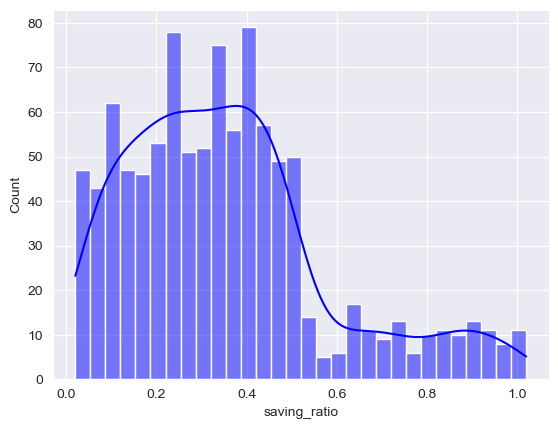

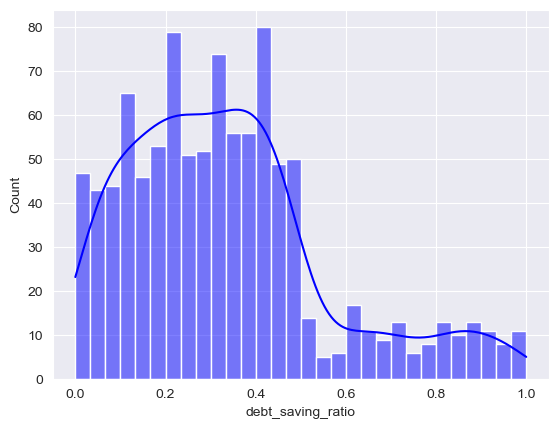

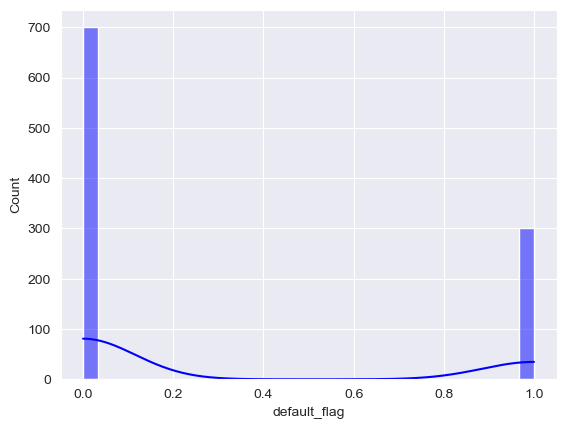

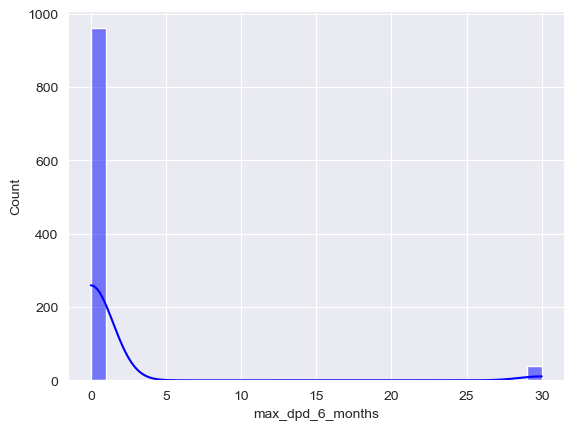

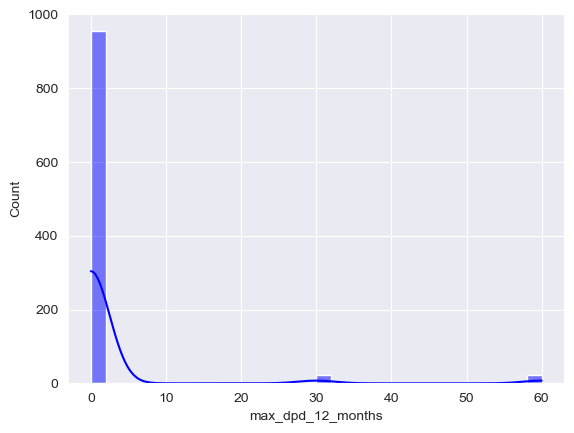

...

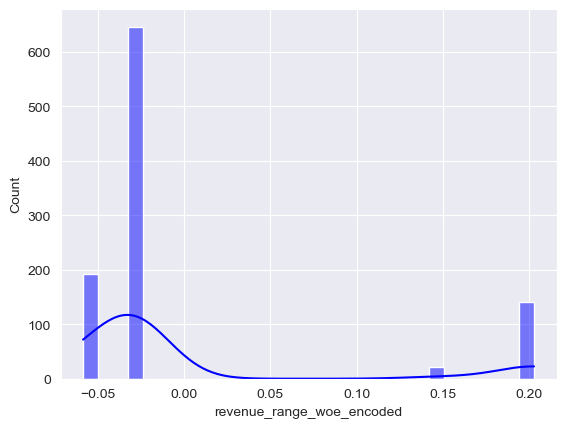

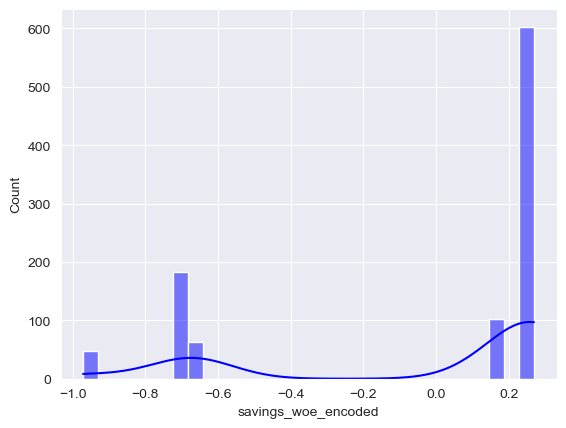

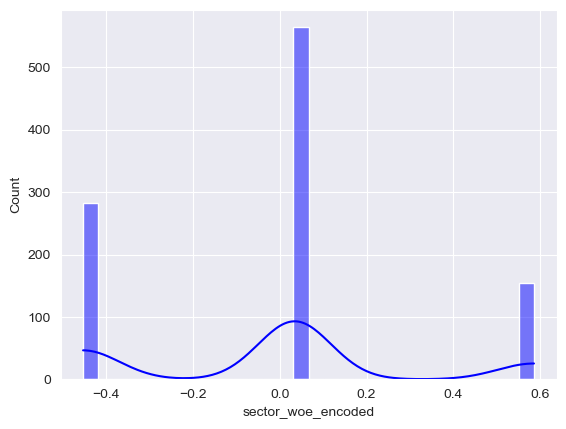

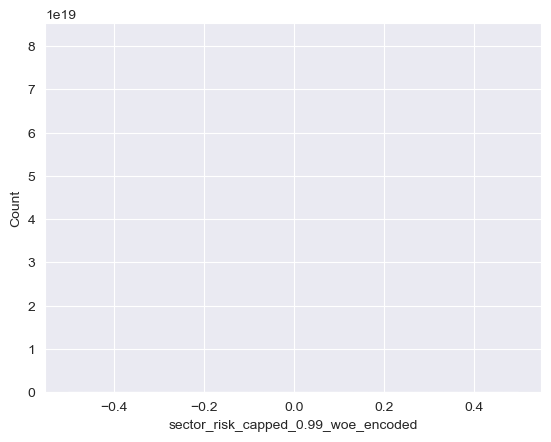

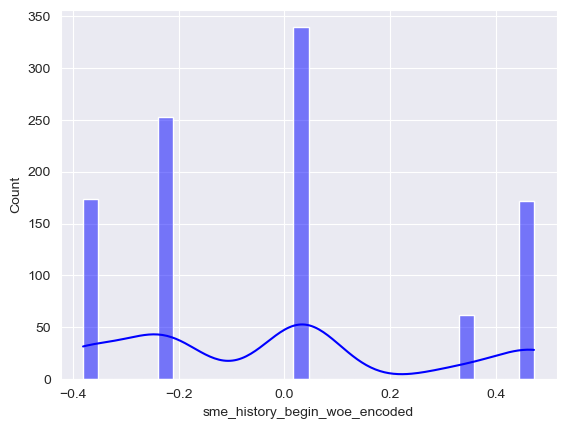

In [81]:
for col in tf_cols:
    plt.figure()
    sns.histplot(data=df1, x=col, bins=30, color="blue", kde=True)
    plt.show()
# Plotted below are the distributions of the tranformed,normalized and cleaned columns


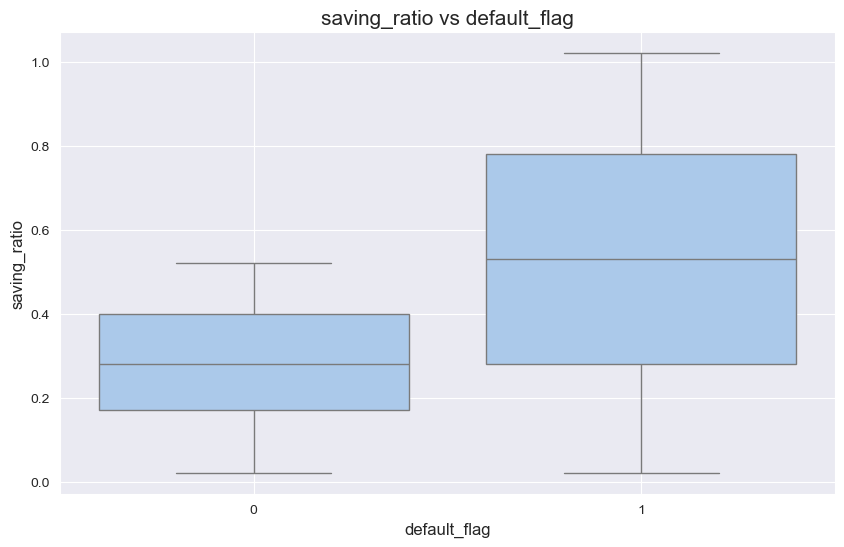

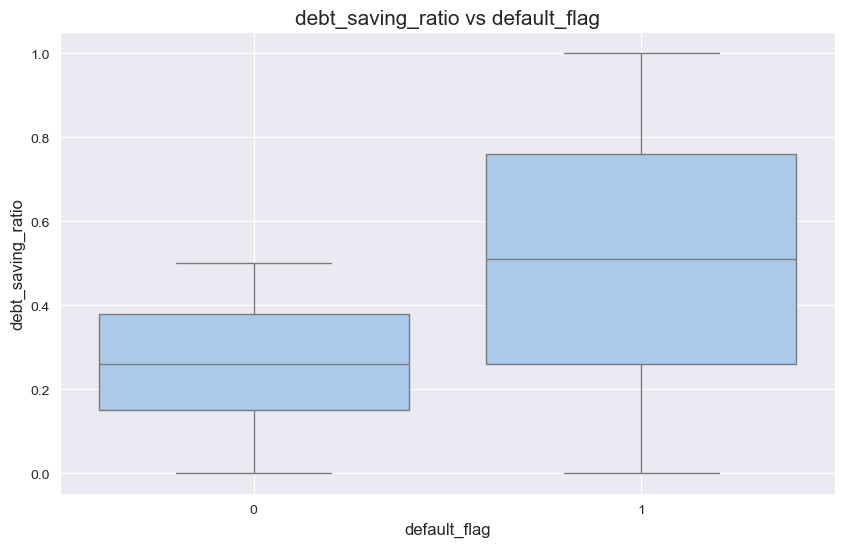

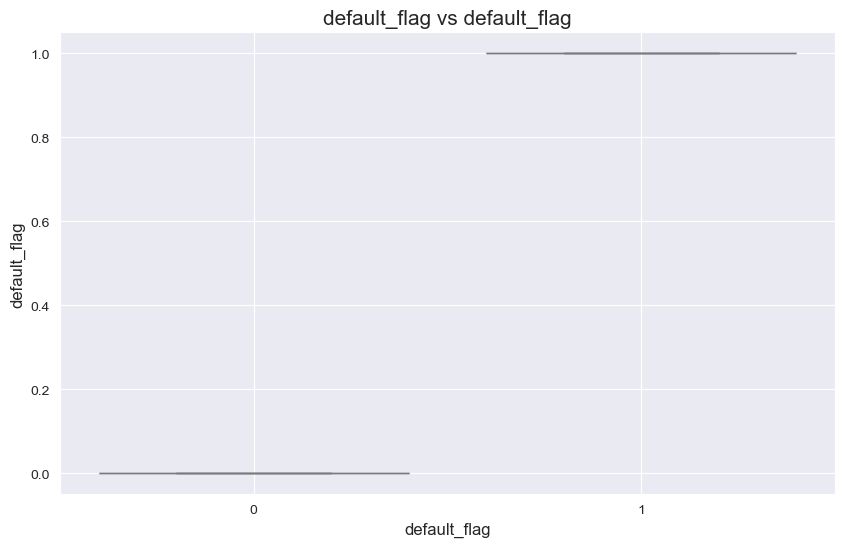

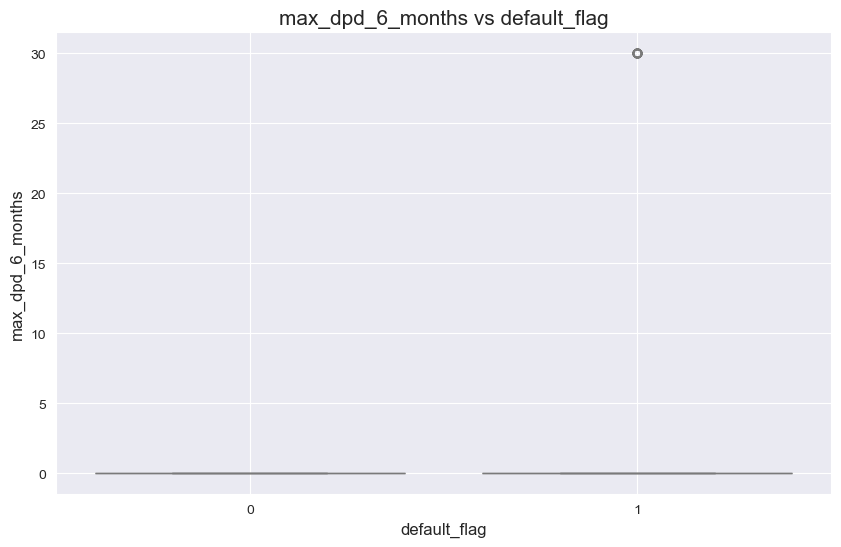

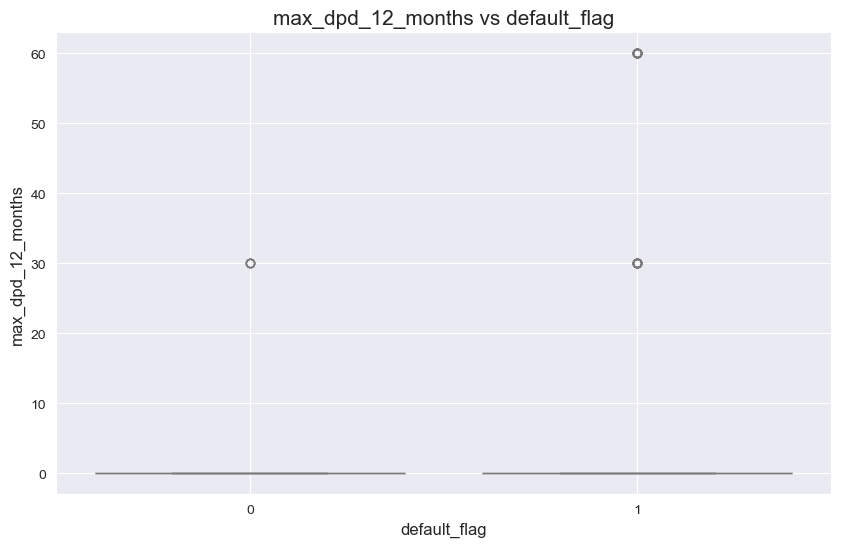

...

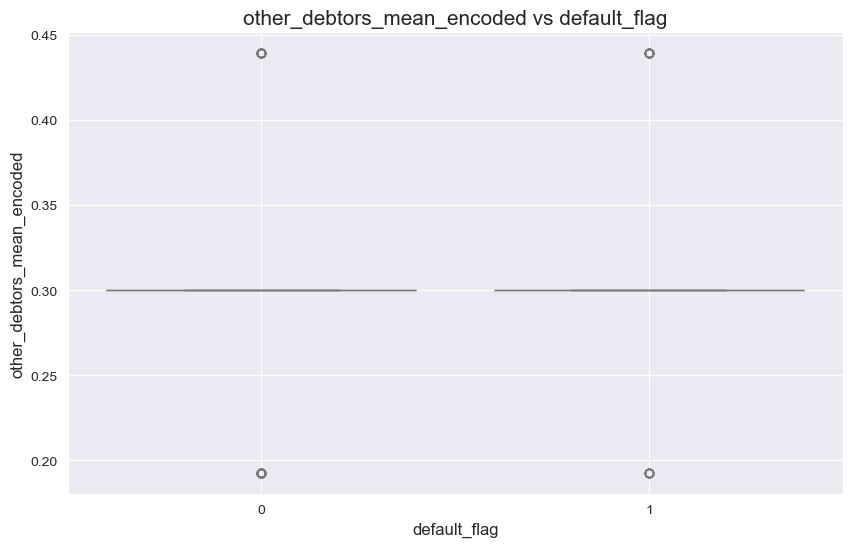

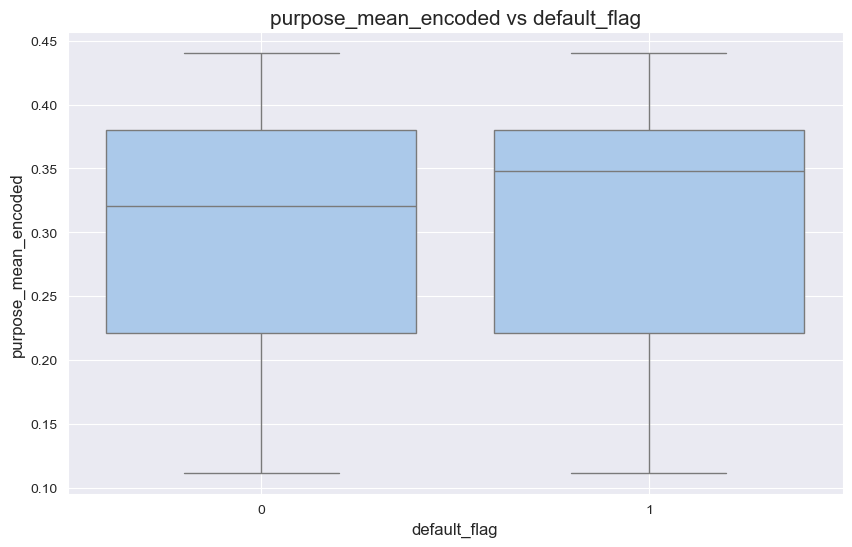

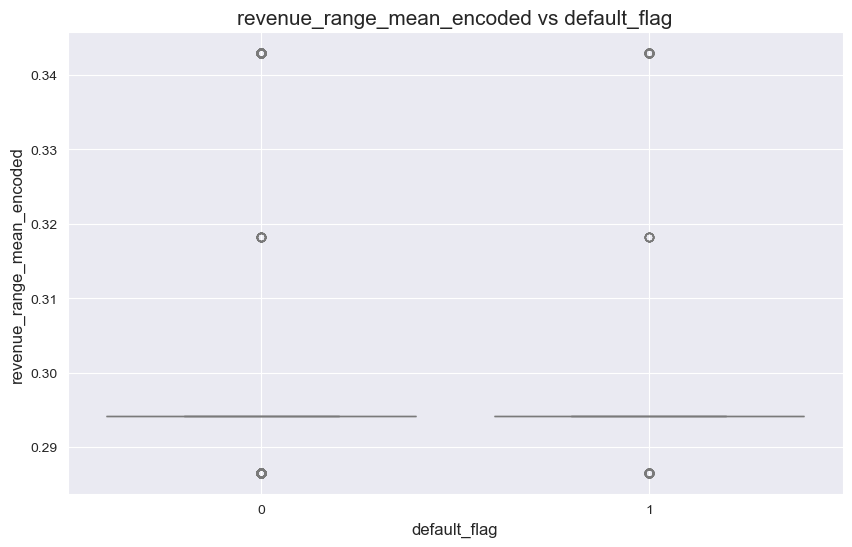

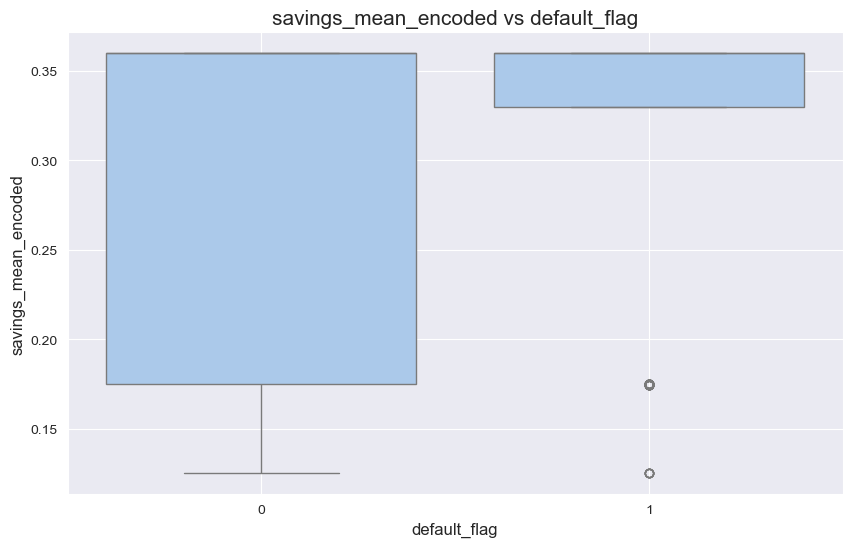

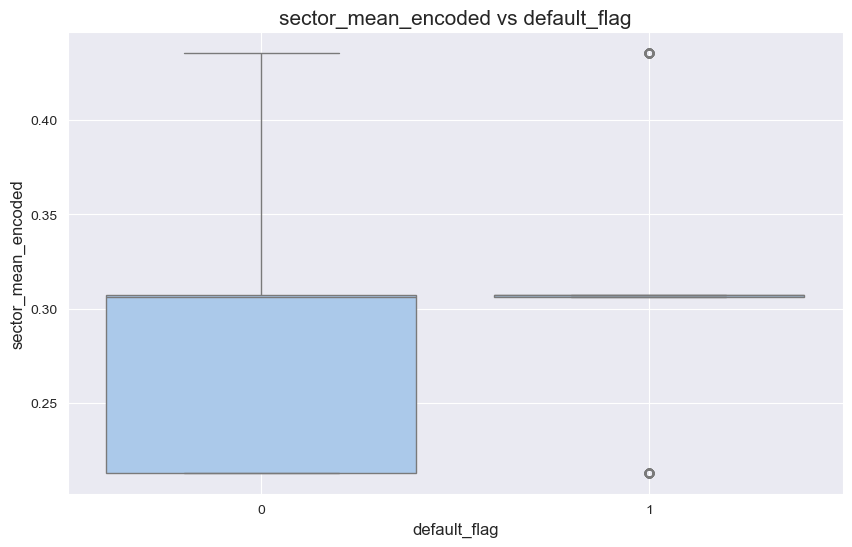

ValueError: List of boxplot statistics and `positions` values must have same the length

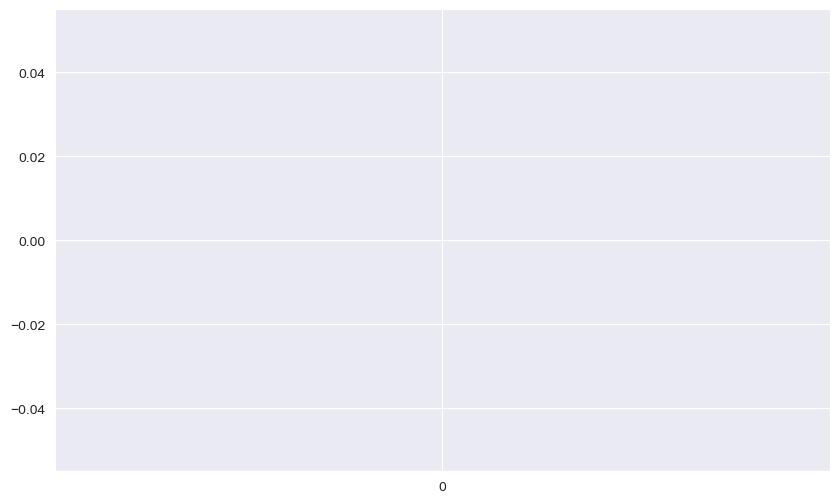

In [82]:
# Chack for outliers in the tranformed columns by default_flag values.
target="default_flag"
for col in tf_cols:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=target, y=col, data=df1)
    plt.title(f'{col} vs {target}', fontsize=15)
    plt.xlabel(target, fontsize=12)
    plt.ylabel(col, fontsize=12)
    plt.grid(True)
    plt.show()


In [ ]:
df1.shape

In [ ]:
df1.isnull().sum().unique() # No Null values present

In [ ]:
# df1.to_csv('MSME_clean_trasformed.csv', index=False) # Checkpoint saved the cleaned and tranformed data for further use